In [1]:
import warnings
warnings.filterwarnings("ignore")

In [73]:
# ! pip install gdown

In [74]:
# ! gdown --no-check-certificate --folder https://drive.google.com/drive/folders/14GSxCsvgxTbrANq0vYlkHXNt3-OuepU9?usp=drive_link

In [75]:
# ! mv "Brazilian Dataset" "dataset"

In [2]:
import numpy as np
import pandas as pd
from scipy.io import arff

import tensorflow as tf

from sklearn import metrics
from sklearn.metrics import classification_report
import matplotlib.pyplot as plt

In [3]:
tf.config.list_physical_devices()

[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU')]

In [4]:
entire_data = []
for spdt in ["02","03", "04", "05", "06", "07", "08", "09", "10"]:
    data = arff.loadarff('./dataset/base_desenv_' + spdt + '.arff')
    sub_df = pd.DataFrame(data[0])
    entire_data.append(sub_df)

    data = arff.loadarff('./dataset/base_validacao_' + spdt + '.arff')
    sub_df = pd.DataFrame(data[0])
    entire_data.append(sub_df)

In [5]:
df = pd.concat(entire_data)
df

,mcc_cat,mcc_ant_cat,cep_cat,cep_ant_cat,valor_trans_cat,valor_trans_ant_cat,pos_entry,lim_cred_cat,bandeira_cat,variante_cat,score_cat,tp_pessoa_cat,trans_nacional_cat,qtde_parc_cat,velocidade_cat,dif_score_cat,trans_limit_cat,flag_fraude_cat
0,9.0,22.0,3.0,3.0,6.0,6.0,2.0,6.0,2.0,3.0,0.0,1.0,0.0,1.0,7.0,1.0,0.0,b'N'
1,22.0,22.0,3.0,3.0,7.0,7.0,2.0,6.0,2.0,3.0,0.0,1.0,0.0,1.0,4.0,4.0,0.0,b'N'
2,22.0,22.0,3.0,3.0,7.0,7.0,2.0,6.0,2.0,3.0,3.0,1.0,0.0,1.0,6.0,5.0,0.0,b'S'
3,9.0,0.0,2.0,0.0,4.0,1.0,2.0,4.0,2.0,3.0,0.0,1.0,0.0,1.0,2.0,3.0,0.0,b'N'
4,15.0,9.0,2.0,2.0,4.0,4.0,2.0,4.0,2.0,3.0,0.0,1.0,0.0,1.0,3.0,3.0,0.0,b'N'
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12654,8.0,15.0,6.0,6.0,6.0,2.0,2.0,3.0,4.0,1.0,0.0,1.0,0.0,1.0,5.0,3.0,0.0,b'N'
12655,6.0,6.0,1.0,1.0,2.0,2.0,2.0,1.0,4.0,1.0,0.0,1.0,0.0,1.0,5.0,3.0,0.0,b'N'
12656,3.0,0.0,5.0,0.0,4.0,1.0,2.0,1.0,4.0,1.0,0.0,1.0,0.0,2.0,2.0,3.0,0.0,b'N'
12657,7.0,0.0,2.0,0.0,2.0,1.0,1.0,1.0,4.0,1.0,0.0,1.0,0.0,1.0,2.0,3.0,0.0,b'N'


# Preprocess

In [6]:
df.drop_duplicates(inplace=True, ignore_index=True)
df

,mcc_cat,mcc_ant_cat,cep_cat,cep_ant_cat,valor_trans_cat,valor_trans_ant_cat,pos_entry,lim_cred_cat,bandeira_cat,variante_cat,score_cat,tp_pessoa_cat,trans_nacional_cat,qtde_parc_cat,velocidade_cat,dif_score_cat,trans_limit_cat,flag_fraude_cat
0,9.0,22.0,3.0,3.0,6.0,6.0,2.0,6.0,2.0,3.0,0.0,1.0,0.0,1.0,7.0,1.0,0.0,b'N'
1,22.0,22.0,3.0,3.0,7.0,7.0,2.0,6.0,2.0,3.0,0.0,1.0,0.0,1.0,4.0,4.0,0.0,b'N'
2,22.0,22.0,3.0,3.0,7.0,7.0,2.0,6.0,2.0,3.0,3.0,1.0,0.0,1.0,6.0,5.0,0.0,b'S'
3,9.0,0.0,2.0,0.0,4.0,1.0,2.0,4.0,2.0,3.0,0.0,1.0,0.0,1.0,2.0,3.0,0.0,b'N'
4,15.0,9.0,2.0,2.0,4.0,4.0,2.0,4.0,2.0,3.0,0.0,1.0,0.0,1.0,3.0,3.0,0.0,b'N'
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28372,3.0,15.0,2.0,2.0,4.0,4.0,2.0,3.0,1.0,1.0,0.0,1.0,0.0,1.0,5.0,1.0,0.0,b'N'
28373,0.0,3.0,2.0,2.0,5.0,4.0,2.0,3.0,1.0,1.0,0.0,1.0,0.0,1.0,3.0,3.0,0.0,b'N'
28374,9.0,0.0,2.0,2.0,4.0,5.0,5.0,3.0,1.0,1.0,0.0,1.0,0.0,1.0,5.0,1.0,0.0,b'N'
28375,15.0,9.0,2.0,2.0,4.0,4.0,2.0,3.0,1.0,1.0,0.0,1.0,0.0,1.0,2.0,3.0,0.0,b'N'


In [7]:
label = df['flag_fraude_cat'].map({b'N': 0, b'S': 1})
df.drop('flag_fraude_cat', axis=1, inplace=True)
label

0        0
1        0
2        1
3        0
4        0
        ..
28372    0
28373    0
28374    0
28375    0
28376    0
Name: flag_fraude_cat, Length: 28377, dtype: int64

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28377 entries, 0 to 28376
Data columns (total 17 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   mcc_cat              28377 non-null  float64
 1   mcc_ant_cat          28377 non-null  float64
 2   cep_cat              28377 non-null  float64
 3   cep_ant_cat          28377 non-null  float64
 4   valor_trans_cat      28377 non-null  float64
 5   valor_trans_ant_cat  28377 non-null  float64
 6   pos_entry            28377 non-null  float64
 7   lim_cred_cat         28377 non-null  float64
 8   bandeira_cat         28377 non-null  float64
 9   variante_cat         28377 non-null  float64
 10  score_cat            28377 non-null  float64
 11  tp_pessoa_cat        28377 non-null  float64
 12  trans_nacional_cat   28377 non-null  float64
 13  qtde_parc_cat        28377 non-null  float64
 14  velocidade_cat       28377 non-null  float64
 15  dif_score_cat        28377 non-null 

In [9]:
df.describe()

,mcc_cat,mcc_ant_cat,cep_cat,cep_ant_cat,valor_trans_cat,valor_trans_ant_cat,pos_entry,lim_cred_cat,bandeira_cat,variante_cat,score_cat,tp_pessoa_cat,trans_nacional_cat,qtde_parc_cat,velocidade_cat,dif_score_cat,trans_limit_cat
count,28377.000000,28377.000000,28377.000000,28377.000000,28377.000000,28377.000000,28377.000000,28377.000000,28377.000000,28377.000000,28377.000000,28377.000000,28377.000000,28377.000000,28377.000000,28377.000000,28377.000000
mean,10.885224,7.414913,3.938401,2.558939,5.039151,3.647003,3.257039,6.012827,1.915389,1.993340,0.690383,0.981041,0.005215,1.227825,3.533002,2.919336,0.070374
std,6.278881,7.339551,2.431819,2.665178,2.450320,2.728641,2.784700,2.339727,1.547138,0.813652,1.771458,0.136383,0.072031,0.484468,1.737914,1.039642,0.399131
min,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,0.000000
25%,6.000000,0.000000,2.000000,0.000000,3.000000,1.000000,2.000000,4.000000,1.000000,1.000000,0.000000,1.000000,0.000000,1.000000,2.000000,3.000000,0.000000
50%,9.000000,6.000000,4.000000,2.000000,5.000000,3.000000,2.000000,6.000000,1.000000,2.000000,0.000000,1.000000,0.000000,1.000000,3.000000,3.000000,0.000000
75%,15.000000,13.000000,6.000000,4.000000,7.000000,6.000000,2.000000,8.000000,2.000000,3.000000,0.000000,1.000000,0.000000,1.000000,5.000000,3.000000,0.000000
max,32.000000,32.000000,9.000000,9.000000,9.000000,9.000000,9.000000,9.000000,5.000000,5.000000,9.000000,1.000000,1.000000,3.000000,7.000000,5.000000,9.000000


In [10]:
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

fig = make_subplots(rows=1, cols=2,
                    subplot_titles=("Unique values per Categorical feature", "Unique values per Numerical feature"))


temp_data=df.select_dtypes(exclude="number").nunique().sort_values()

fig.add_trace(
    go.Bar(x=temp_data.index, y=temp_data.values,marker=dict(color='#016CC9')),
    row=1, col=1
)



temp_data=df.select_dtypes(include="number").nunique().sort_values()

fig.add_trace(
    go.Bar(x=temp_data.index, y=temp_data.values,marker=dict(color='#DEB078')),
    row=1, col=2
)

#fig.update_layout(showlegend=False)
fig.show()

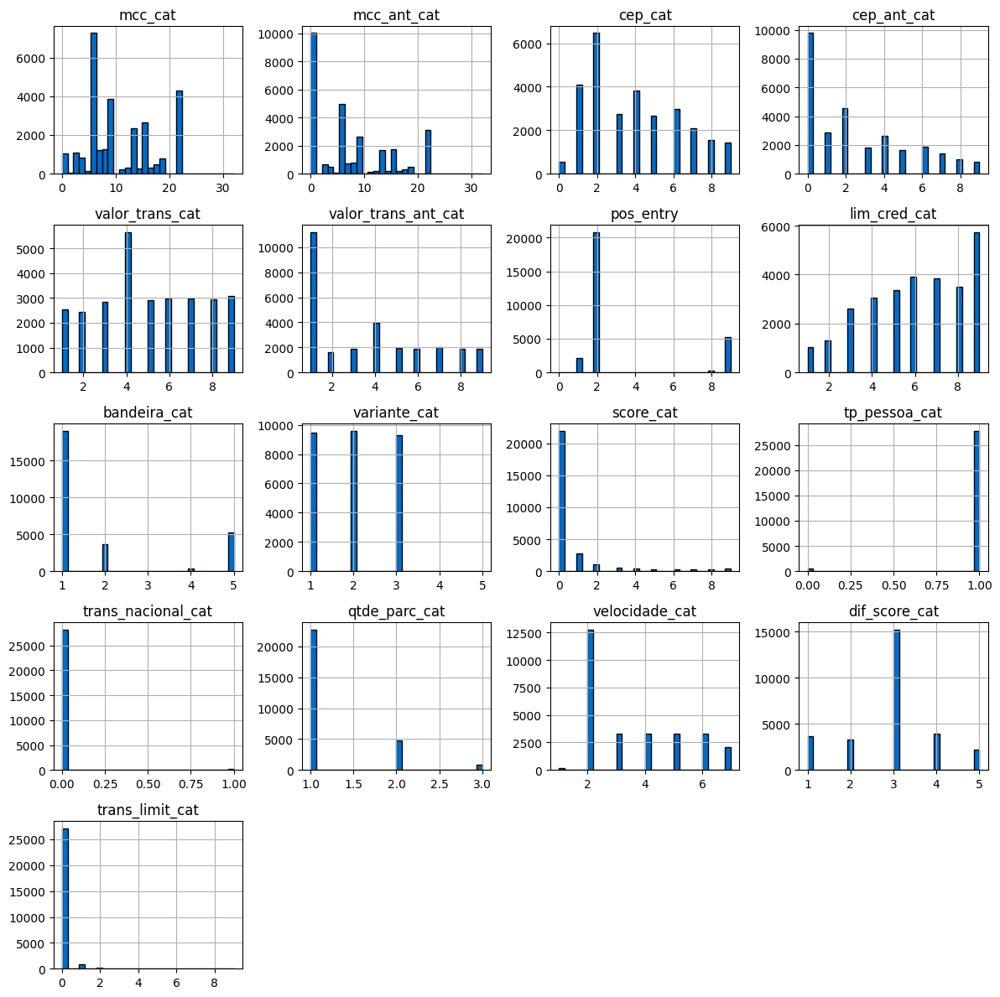

In [11]:
# Plots the histogram for each numerical feature in a separate subplot
figsize_val=(12,12)
layout_val=(-1, 4)
df.hist(bins=30, figsize=figsize_val, layout=layout_val, edgecolor="black",color='#016CC9')
plt.tight_layout()

In [12]:
target=label.value_counts(normalize=True).round(decimals=3)*100

temp=dict(layout=go.Layout(font=dict(family="Franklin Gothic", size=12),
                           height=500, width=1000))
#target.rename(index={1:'Default',0:'Paid'},inplace=True)

pal, color=['#016CC9','#DEB078'], ['#8DBAE2','#EDD3B3']
fig=go.Figure()

fig.add_trace(go.Pie(labels=target.index, values=target, hole=.5,
                     showlegend=True,sort=False,
                     marker=dict(colors=color,line=dict(color=pal,width=2.5)),
                     hovertemplate = "%{label} Income: %{value:.2f}%<extra></extra>"))

fig.update_layout(template=temp, title='Target Distribution',
                  legend=dict(traceorder='reversed',y=1.05,x=0),
                  uniformtext_minsize=15, uniformtext_mode='hide',width=700)
fig.show()

In [13]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(df, label, test_size=0.2, random_state=0, shuffle=True, stratify=label)
X_train.reset_index(drop=True, inplace = True)
X_test.reset_index(drop=True, inplace = True)

In [14]:
from sklearn.preprocessing import StandardScaler

learn_scaler=StandardScaler().fit(X_train)
X_train_normal = learn_scaler.transform(X_train)
X_test_normal = learn_scaler.transform(X_test)

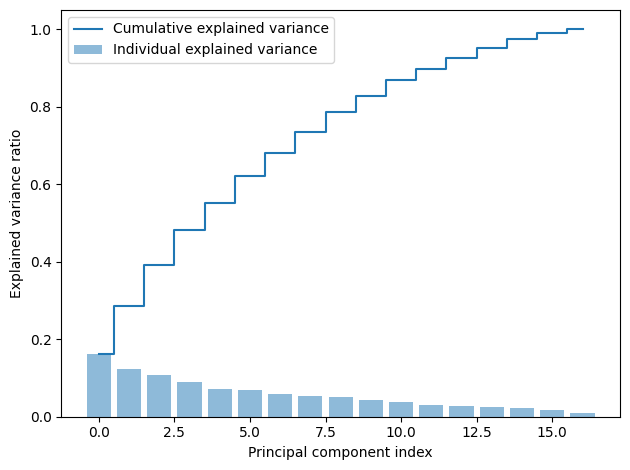

(22701, 17)

In [15]:
#
# Scale the dataset; This is very important before you apply PCA
#
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
#
# Instantiate PCA
#
pca = PCA()
#
# Determine transformed features
#
data_frame_pca = pca.fit_transform(X_train_normal)
#
# Determine explained variance using explained_variance_ration_ attribute
#
exp_var_pca = pca.explained_variance_ratio_
#
# Cumulative sum of eigenvalues; This will be used to create step plot
# for visualizing the variance explained by each principal component.
#
cum_sum_eigenvalues = np.cumsum(exp_var_pca)
#
# Create the visualization plot
#
plt.bar(range(0,len(exp_var_pca)), exp_var_pca, alpha=0.5, align='center', label='Individual explained variance')
plt.step(range(0,len(cum_sum_eigenvalues)), cum_sum_eigenvalues, where='mid',label='Cumulative explained variance')
plt.ylabel('Explained variance ratio')
plt.xlabel('Principal component index')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

reducted_data = np.copy(data_frame_pca) # [:,:3]
reducted_data.shape

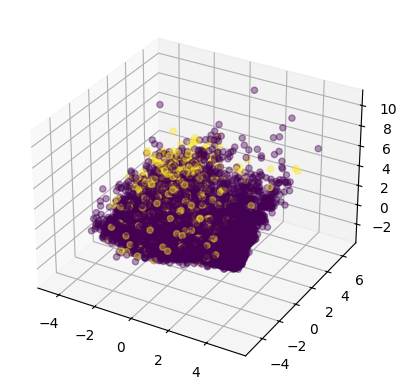

In [16]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

ax.scatter(reducted_data[:,0], reducted_data[:,1], reducted_data[:,2], c=y_train, cmap="viridis", alpha=0.4)
plt.show()

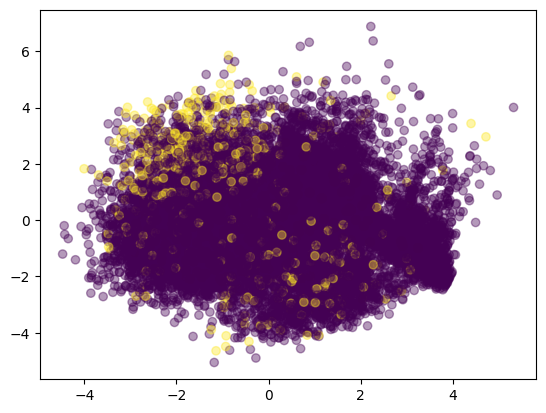

In [17]:
fig = plt.figure()
ax = fig.add_subplot()

ax.scatter(reducted_data[:,0], reducted_data[:,1], c=y_train, cmap="viridis", alpha=0.4)
plt.show()

In [18]:
from sklearn.manifold import TSNE
TSNE_3D_embedding = TSNE(n_components=3, learning_rate='auto', init='random')
embedded_3d_data = TSNE_3D_embedding.fit_transform(X_train_normal)

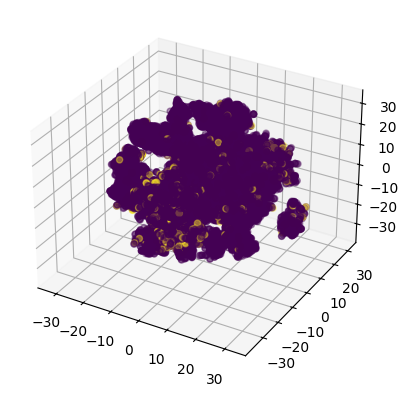

In [19]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

ax.scatter(embedded_3d_data[:,0], embedded_3d_data[:,1], embedded_3d_data[:,2], c=y_train, cmap="viridis", alpha=0.4)
plt.show()

In [20]:

TSNE_2D_embedding = TSNE(n_components=2, learning_rate='auto', init='random')
embedded_2d_data = TSNE_2D_embedding.fit_transform(X_train_normal)

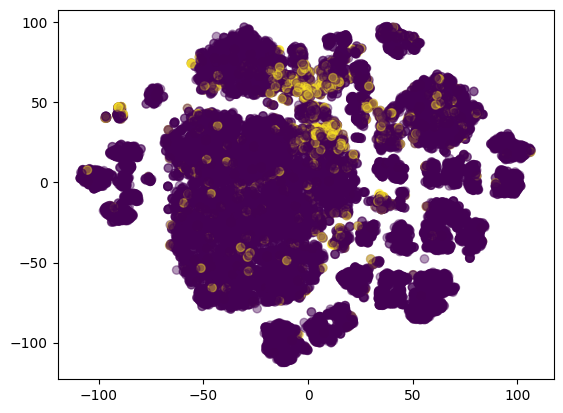

In [21]:
fig = plt.figure()
ax = fig.add_subplot()

ax.scatter(embedded_2d_data[:,0], embedded_2d_data[:,1], c=y_train, cmap="viridis", alpha=0.4)
plt.show()

In [22]:
reducted_test = pca.transform(X_test_normal)

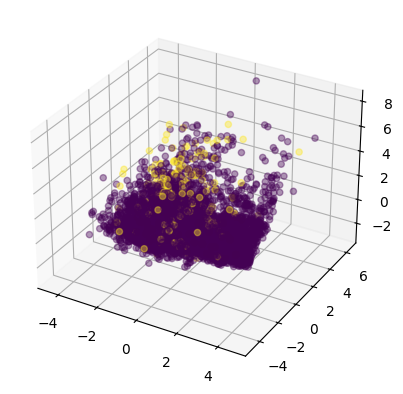

In [23]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

ax.scatter(reducted_test[:,0], reducted_test[:,1], reducted_test[:,2], c=y_test, cmap="viridis", alpha=0.4)
plt.show()

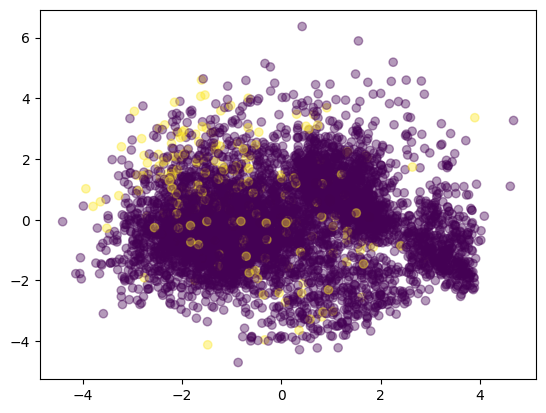

In [24]:
fig = plt.figure()
ax = fig.add_subplot()

ax.scatter(reducted_test[:,0], reducted_test[:,1], c=y_test, cmap="viridis", alpha=0.4)
plt.show()

In [25]:
TSNE_3D_embedding = TSNE(n_components=3, learning_rate='auto', init='random')
embedded_3d_test = TSNE_3D_embedding.fit_transform(X_test_normal)

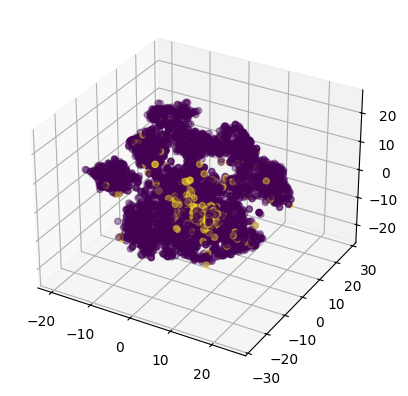

In [26]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

ax.scatter(embedded_3d_test[:,0], embedded_3d_test[:,1], embedded_3d_test[:,2], c=y_test, cmap="viridis", alpha=0.4)
plt.show()

In [27]:
TSNE_2D_embedding = TSNE(n_components=2, learning_rate='auto', init='random')
embedded_2d_test = TSNE_2D_embedding.fit_transform(X_test_normal)

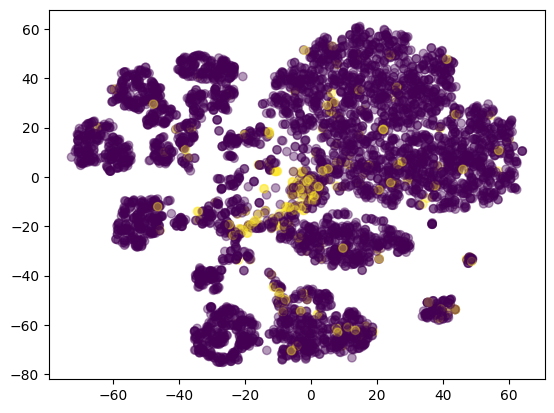

In [28]:
fig = plt.figure()
ax = fig.add_subplot()

ax.scatter(embedded_2d_test[:,0], embedded_2d_test[:,1], c=y_test, cmap="viridis", alpha=0.4)
plt.show()

In [29]:
def do_visualize (label, is_test):
    if is_test:
        print("PCA 3D: ")
        fig = plt.figure()
        ax = fig.add_subplot(111, projection='3d')
        ax.scatter(reducted_test[:,0], reducted_test[:,1], reducted_test[:,2], c=label, cmap="viridis", alpha=0.4)
        plt.show()
        print()

        print("PCA 2D: ")
        fig = plt.figure()
        ax = fig.add_subplot()
        ax.scatter(reducted_test[:,0], reducted_test[:,1], c=label, cmap="viridis", alpha=0.4)
        plt.show()
        print()

        print("t-SNE 3D: ")
        fig = plt.figure()
        ax = fig.add_subplot(111, projection='3d')
        ax.scatter(embedded_3d_test[:,0], embedded_3d_test[:,1], embedded_3d_test[:,2], c=label, cmap="viridis", alpha=0.4)
        plt.show()
        print()

        print("t-SNE 2D: ")
        fig = plt.figure()
        ax = fig.add_subplot()
        ax.scatter(embedded_2d_test[:,0], embedded_2d_test[:,1], c=label, cmap="viridis", alpha=0.4)
        plt.show()
        print()
    else:
        print("PCA 3D: ")
        fig = plt.figure()
        ax = fig.add_subplot(111, projection='3d')
        ax.scatter(reducted_data[:,0], reducted_data[:,1], reducted_data[:,2], c=label, cmap="viridis", alpha=0.4)
        plt.show()
        print()

        print("PCA 2D: ")
        fig = plt.figure()
        ax = fig.add_subplot()
        ax.scatter(reducted_data[:,0], reducted_data[:,1], c=label, cmap="viridis", alpha=0.4)
        plt.show()
        print()

        print("t-SNE 3D: ")
        fig = plt.figure()
        ax = fig.add_subplot(111, projection='3d')
        ax.scatter(embedded_3d_data[:,0], embedded_3d_data[:,1], embedded_3d_data[:,2], c=label, cmap="viridis", alpha=0.4)
        plt.show()
        print()

        print("t-SNE 2D: ")
        fig = plt.figure()
        ax = fig.add_subplot()
        ax.scatter(embedded_2d_data[:,0], embedded_2d_data[:,1], c=label, cmap="viridis", alpha=0.4)
        plt.show()
        print()

PCA 3D: 


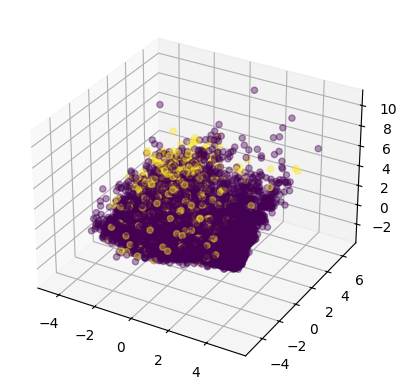


PCA 2D: 


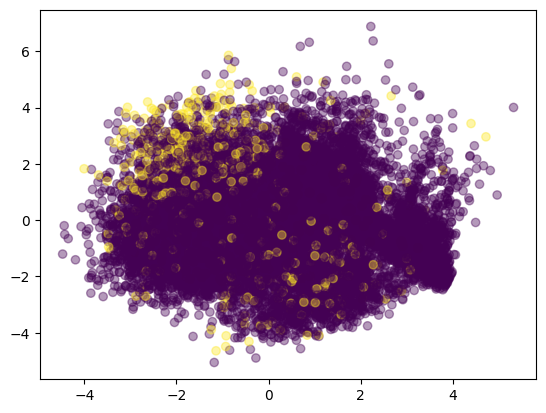


t-SNE 3D: 


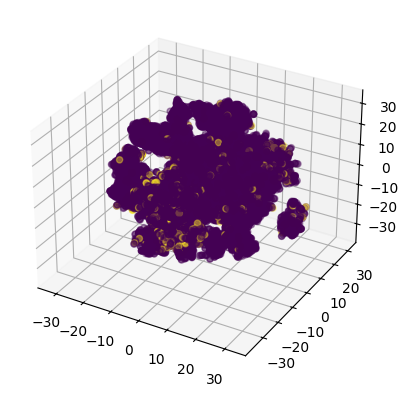


t-SNE 2D: 


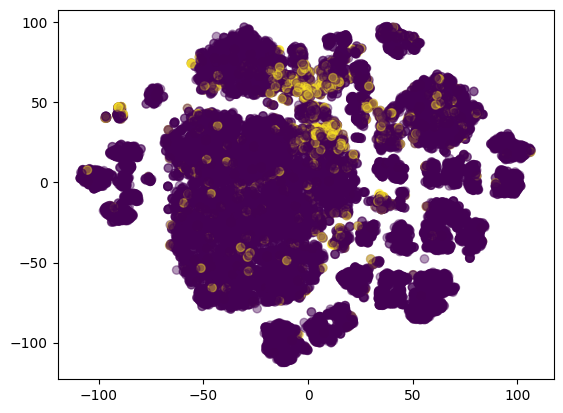

In [30]:
do_visualize (y_train, False)

PCA 3D: 


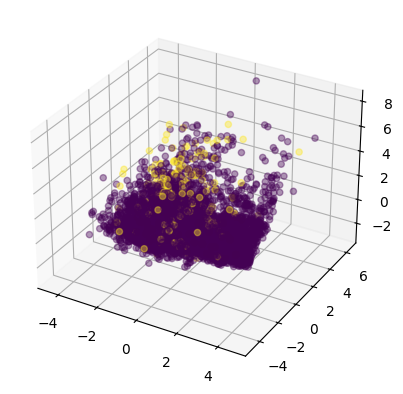


PCA 2D: 


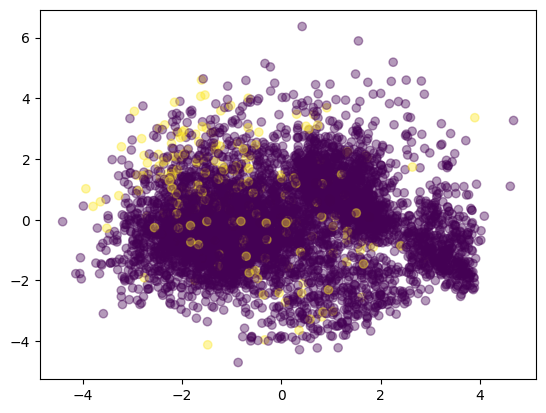


t-SNE 3D: 


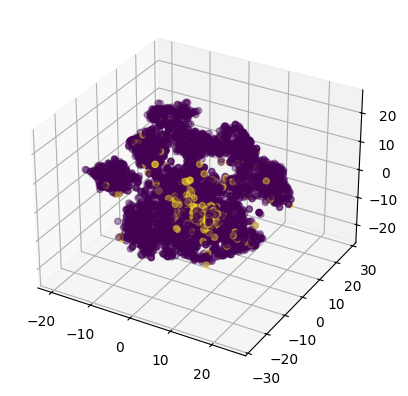


t-SNE 2D: 


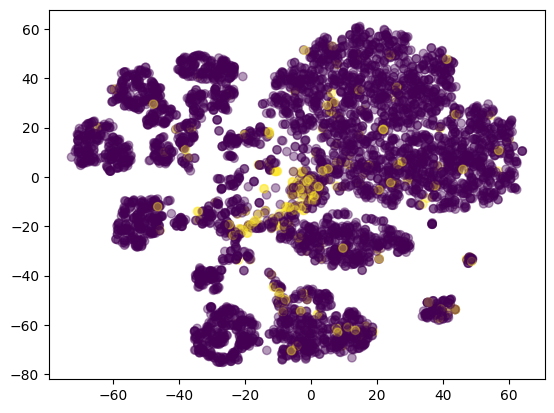

In [31]:
do_visualize (y_test, True)

# Fraud Detection

## Metrics

In [38]:
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay

def calculate_metrics (y_true, y_pred, is_prob = False, threshold = 0.5):

    metrics_list = []

    if (is_prob):
        y_predict = np.where(y_pred>threshold, 1, 0)
        
        print("precision_score:", precision_score(y_true, y_predict, average='macro'))
        metrics_list.append(precision_score(y_true, y_predict, average='macro'))

        print("recall_score:", recall_score(y_true, y_predict, average='macro'))
        metrics_list.append(recall_score(y_true, y_predict, average='macro'))

        print("f1_score:", f1_score(y_true, y_predict, average='macro'))
        metrics_list.append(f1_score(y_true, y_predict, average='macro'))

        print("accuracy_score:", accuracy_score(y_true, y_predict))
        metrics_list.append(accuracy_score(y_true, y_predict))

        print()
        print(classification_report(y_true, y_predict))
        print()
        cm = confusion_matrix(y_true, y_predict)
        disp = ConfusionMatrixDisplay(confusion_matrix=cm,)
        disp.plot()
        plt.show()


        fpr, tpr, _ = metrics.roc_curve(y_true,  y_pred)
        print("AUC score is ", metrics.roc_auc_score(y_true, y_pred))
        metrics_list.append(metrics.roc_auc_score(y_true, y_pred))
        #create ROC curve
        plt.plot(fpr,tpr)
        plt.ylabel('True Positive Rate')
        plt.xlabel('False Positive Rate')
        plt.show()

        # Data to plot precision - recall curve
        precision, recall, _ = metrics.precision_recall_curve(y_true, y_pred)
        # Use AUC function to calculate the area under the curve of precision recall curve
        auc_precision_recall = metrics.auc(recall, precision)
        print("AUPRC score is ", auc_precision_recall)
        metrics_list.append(auc_precision_recall)
        plt.plot(recall, precision)
        plt.ylabel('precision')
        plt.xlabel('recall')
        plt.show()

    else:
        print("precision_score:", precision_score(y_true, y_pred, average='macro'))
        metrics_list.append(precision_score(y_true, y_pred, average='macro'))

        print("recall_score:", recall_score(y_true, y_pred, average='macro'))
        metrics_list.append(recall_score(y_true, y_pred, average='macro'))

        print("f1_score:", f1_score(y_true, y_pred, average='macro'))
        metrics_list.append(f1_score(y_true, y_pred, average='macro'))

        print("accuracy_score:", accuracy_score(y_true, y_pred))
        metrics_list.append(accuracy_score(y_true, y_pred))

        print()
        print(classification_report(y_true, y_pred))
        print()
        cm = confusion_matrix(y_true, y_pred)
        disp = ConfusionMatrixDisplay(confusion_matrix=cm,)
        disp.plot()
        plt.show()
    
    return(metrics_list)

metrics_of_methodes = dict()

## Outliers Detection

### Interquartile Range (IQR)

mcc_cat                   Axes(0.125,0.807358;0.352273x0.0726415)
mcc_ant_cat            Axes(0.547727,0.807358;0.352273x0.0726415)
cep_cat                   Axes(0.125,0.720189;0.352273x0.0726415)
cep_ant_cat            Axes(0.547727,0.720189;0.352273x0.0726415)
valor_trans_cat           Axes(0.125,0.633019;0.352273x0.0726415)
valor_trans_ant_cat    Axes(0.547727,0.633019;0.352273x0.0726415)
pos_entry                 Axes(0.125,0.545849;0.352273x0.0726415)
lim_cred_cat           Axes(0.547727,0.545849;0.352273x0.0726415)
bandeira_cat              Axes(0.125,0.458679;0.352273x0.0726415)
variante_cat           Axes(0.547727,0.458679;0.352273x0.0726415)
score_cat                 Axes(0.125,0.371509;0.352273x0.0726415)
tp_pessoa_cat          Axes(0.547727,0.371509;0.352273x0.0726415)
trans_nacional_cat         Axes(0.125,0.28434;0.352273x0.0726415)
qtde_parc_cat           Axes(0.547727,0.28434;0.352273x0.0726415)
velocidade_cat             Axes(0.125,0.19717;0.352273x0.0726415)
dif_score_

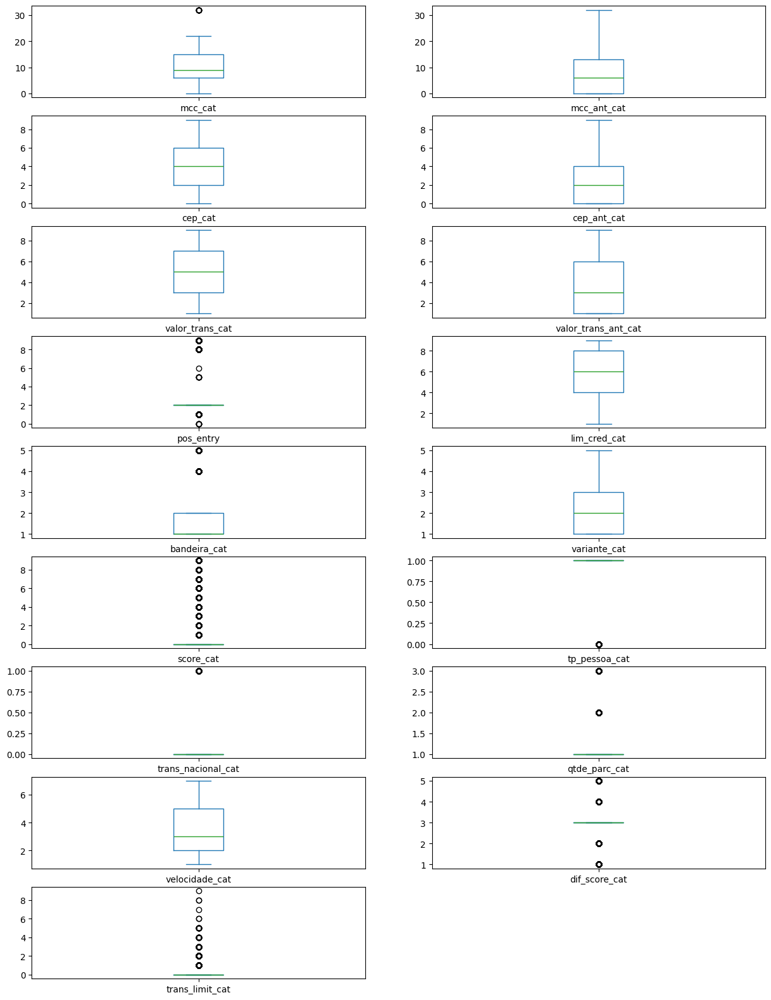

In [34]:
import matplotlib.pyplot as plt

X_train.plot(kind="box",subplots=True,layout=(9,2),figsize=(15,20))

In [35]:
import seaborn as sns

#FUNCTION TO IDENTIFY OUTLIERS USING IQR METHOD
def iqr_outlier(x, factor):
    q1 = x.quantile(0.25)
    q3 = x.quantile(0.75)
    iqr = q3 - q1
    min_ = q1 - factor * iqr
    max_ = q3 + factor * iqr
    result_ = pd.Series([0] * len(x))
    result_[((x < min_) | (x > max_))] = 1
    return result_


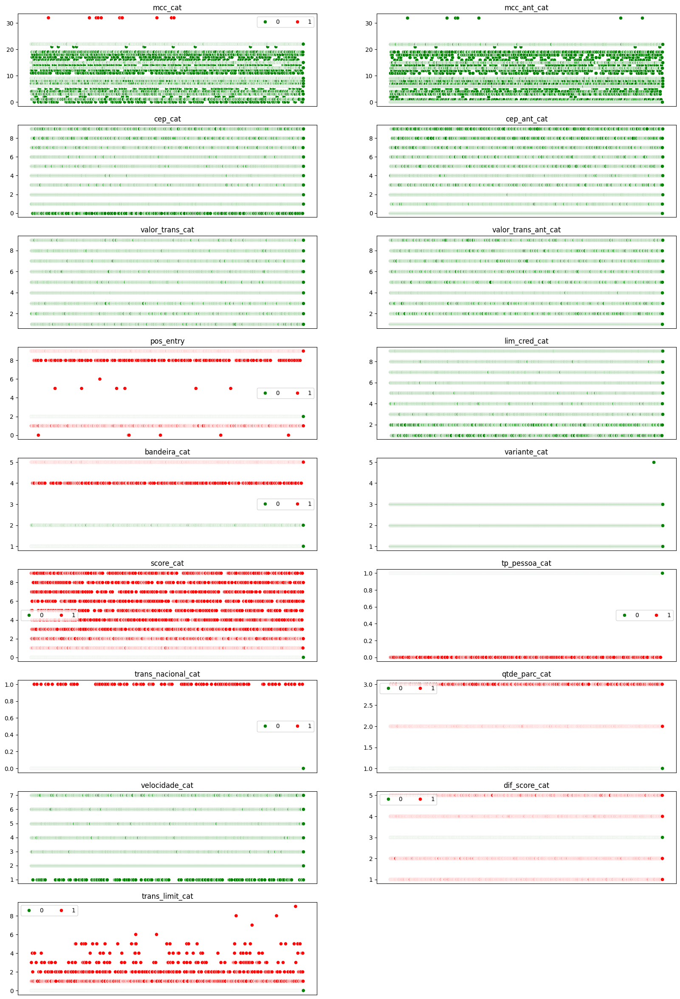

In [36]:
#SCATTER PLOTS HIGHLIGHTING OUTLIERS CALCULATED USING IQR METHOD
fig, ax = plt.subplots(9, 2, figsize=(20, 30))
outliers_data = []
row = col = 0
for n,i in enumerate(X_train.columns):
    if (n % 2 == 0) & (n > 0):
        row += 1
        col = 0
    outliers = iqr_outlier(X_train[i], 1.5)
    # print(outliers)
    outliers_data.extend(outliers.index[outliers == 1].tolist())
    
   
    if sum(outliers) == 0:
        sns.scatterplot(x = np.arange(len(X_train[i])), y = X_train[i], ax = ax[row, col], legend=False, color = 'green')
    else:
        sns.scatterplot(x = np.arange(len(X_train[i])), y = X_train[i], ax = ax[row, col], hue = outliers, palette = ['green','red'])

    # for x,y in zip(np.arange(len(X_train[i]))[outliers == 1], X_train[i][outliers == 1]):
    #     ax[row,col].text(x = x, y = y, s = y, fontsize = 8)
        
    ax[row,col].set_ylabel("")
    ax[row,col].set_title(i)
    ax[row,col].xaxis.set_visible(False)
    if sum(outliers) > 0:
        ax[row,col].legend(ncol=2)
    col += 1
ax[row,col].axis('off')
plt.show()


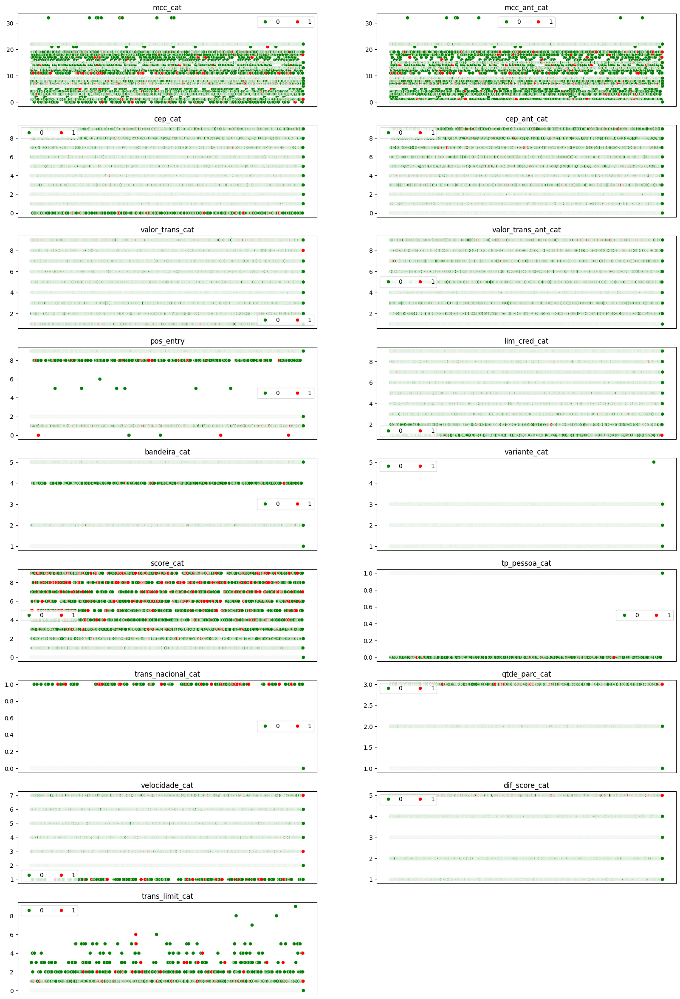

In [37]:
fig, ax = plt.subplots(9, 2, figsize=(20, 30))
row = col = 0
for n,i in enumerate(X_train.columns):
    if (n % 2 == 0) & (n > 0):
        row += 1
        col = 0
    sns.scatterplot(x = np.arange(len(X_train[i])), y = X_train[i], ax = ax[row, col], hue = np.array(y_train), palette = ['green','red'])
    ax[row,col].set_ylabel("")
    ax[row,col].set_title(i)
    ax[row,col].xaxis.set_visible(False)
    if sum(outliers) > 0:
        ax[row,col].legend(ncol=2)
    col += 1
ax[row,col].axis('off')
plt.show()

In [39]:
y_pred = np.zeros_like(y_train)
y_pred[list(set(outliers_data))] = 1

precision_score: 0.5220052782837225
recall_score: 0.612863906410962
f1_score: 0.26308808346892687
accuracy_score: 0.30047134487467514

              precision    recall  f1-score   support

           0       0.99      0.27      0.43     21804
           1       0.05      0.95      0.10       897

    accuracy                           0.30     22701
   macro avg       0.52      0.61      0.26     22701
weighted avg       0.96      0.30      0.42     22701




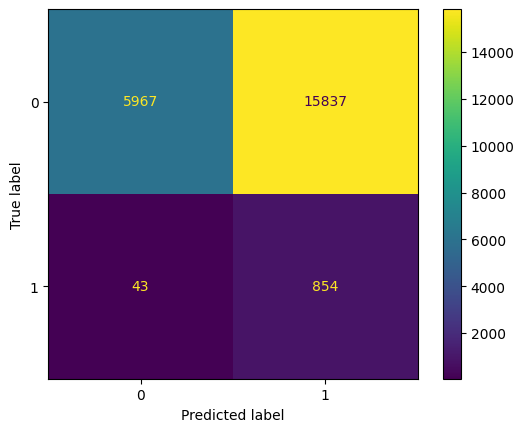

In [40]:
metrics_of_methodes["IQR"] = calculate_metrics(y_train, y_pred)

PCA 3D: 


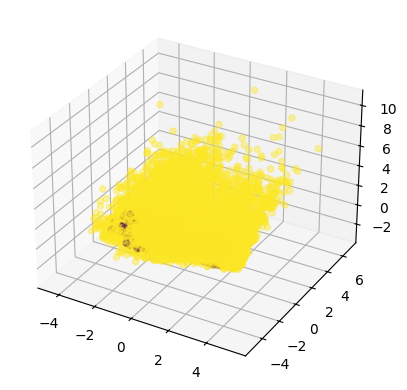


PCA 2D: 


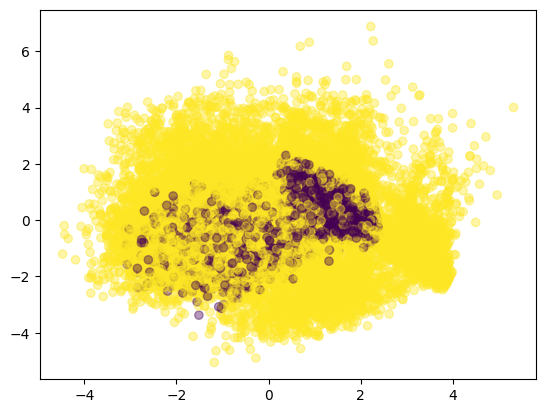


t-SNE 3D: 


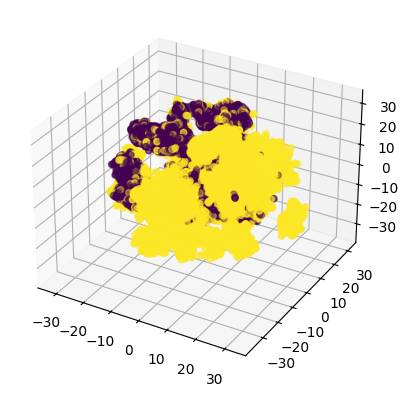


t-SNE 2D: 


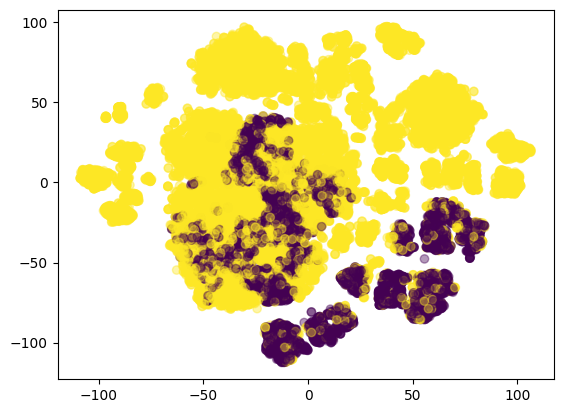

In [42]:
do_visualize (y_pred, False)

### Z-Score

In [43]:
def zscore_outlier(x, factor):
    mu = x.mean().copy()
    sd = x.std().copy()
    ub = factor
    lb = -factor
    zscore = ((x - mu) / sd)
    result_ = pd.Series([0] * len(x))
    result_[((zscore < lb) | (zscore > ub))] = 1
    return result_


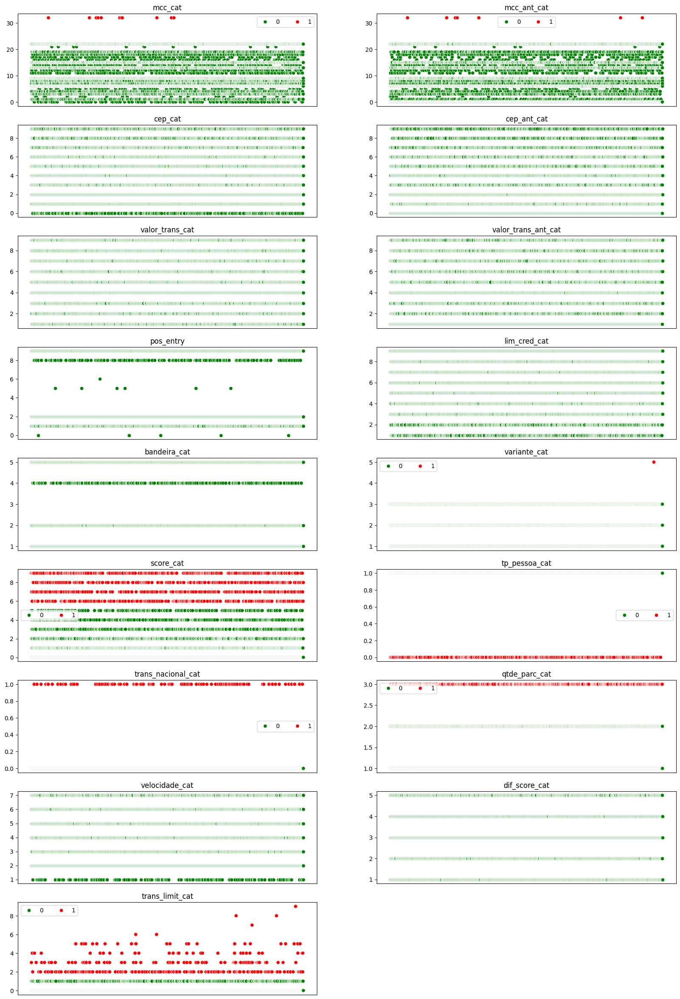

In [44]:
#PLOTTING A SCATTER PLOT AND HIGHLIGHTING THE OUTLIERS DETECTED BY Z-SCORE METHOD
fig, ax = plt.subplots(9, 2, figsize=(20, 30))
outliers_data = []
row = col = 0
for n,i in enumerate(X_train.columns):
    if (n % 2 == 0) & (n > 0):
        row += 1
        col = 0
    outliers = zscore_outlier(X_train[i], 2.5 )
    outliers_data.extend(outliers.index[outliers == 1].tolist())
   
    if sum(outliers) == 0:
        sns.scatterplot(x = np.arange(len(X_train[i])), y = X_train[i], ax = ax[row, col], legend=False, color = 'green')
    else:
        sns.scatterplot(x = np.arange(len(X_train[i])), y = X_train[i], ax = ax[row, col], hue = outliers, palette = ['green','red'])
    # for x,y in zip(np.arange(len(data[i]))[outliers == 1], data[i][outliers == 1]):
    #     ax[row,col].text(x = x, y = y, s = y, fontsize = 8)
    ax[row,col].set_ylabel("")
    ax[row,col].set_title(i)
    ax[row,col].xaxis.set_visible(False)
    if sum(outliers) > 0:
        ax[row,col].legend(ncol=2)
    col += 1
ax[row,col].axis('off')
plt.show()

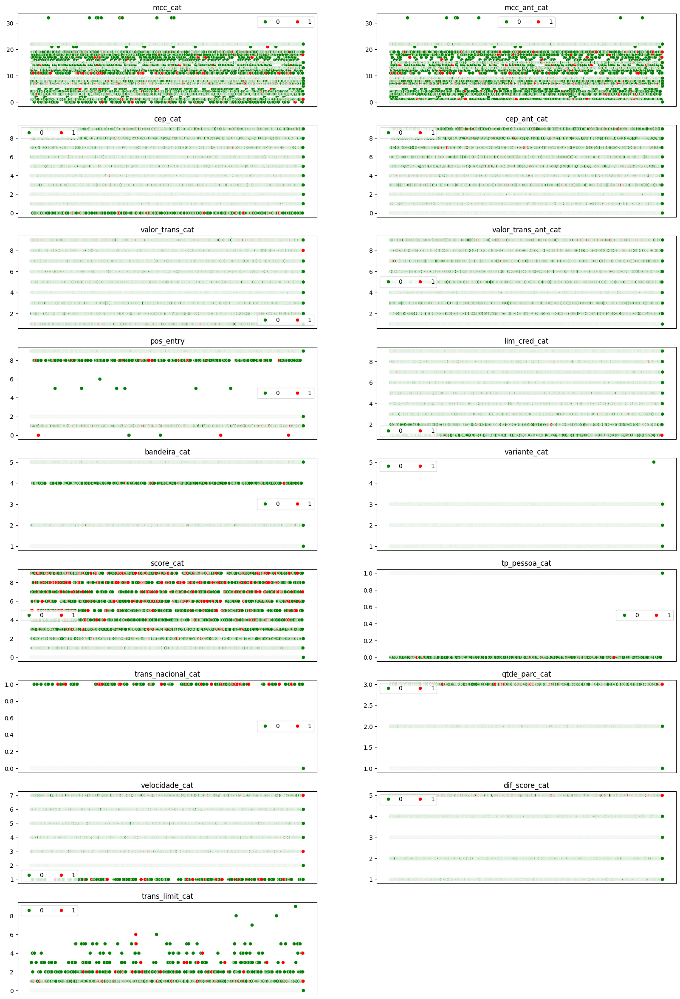

In [45]:
fig, ax = plt.subplots(9, 2, figsize=(20, 30))
row = col = 0
for n,i in enumerate(X_train.columns):
    if (n % 2 == 0) & (n > 0):
        row += 1
        col = 0
    sns.scatterplot(x = np.arange(len(X_train[i])), y = X_train[i], ax = ax[row, col], hue = np.array(y_train), palette = ['green','red'])
    ax[row,col].set_ylabel("")
    ax[row,col].set_title(i)
    ax[row,col].xaxis.set_visible(False)
    if sum(outliers) > 0:
        ax[row,col].legend(ncol=2)
    col += 1
ax[row,col].axis('off')
plt.show()

In [46]:
y_pred = np.zeros_like(y_train)
y_pred[list(set(outliers_data))] = 1

precision_score: 0.5839364618609901
recall_score: 0.695601018867392
f1_score: 0.6092061382919498
accuracy_score: 0.8998722523236862

              precision    recall  f1-score   support

           0       0.98      0.92      0.95     21804
           1       0.19      0.47      0.27       897

    accuracy                           0.90     22701
   macro avg       0.58      0.70      0.61     22701
weighted avg       0.95      0.90      0.92     22701




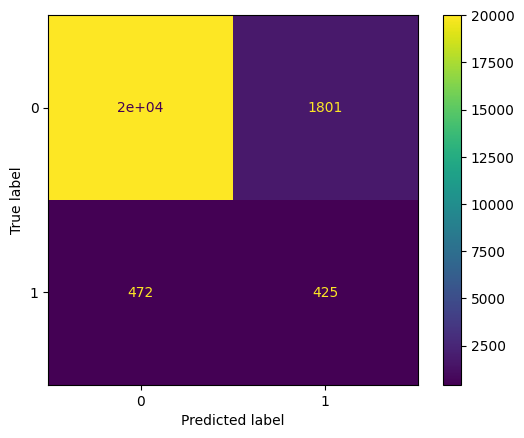

In [47]:
metrics_of_methodes["Z-score"] = calculate_metrics(y_train, y_pred)

PCA 3D: 


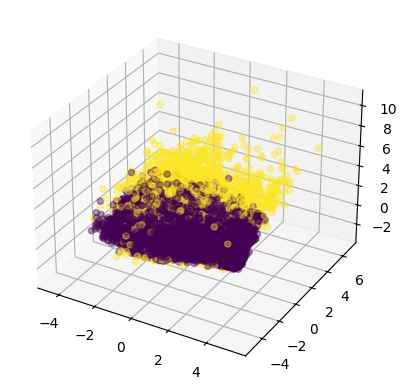


PCA 2D: 


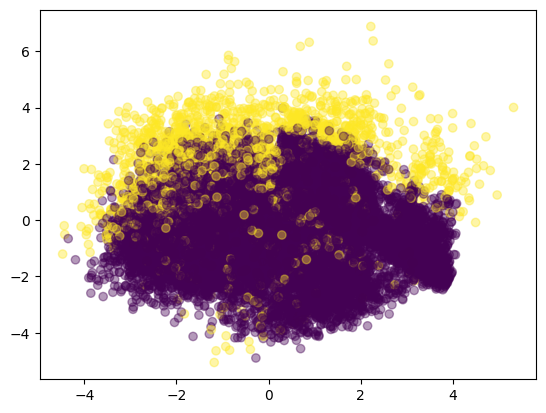


t-SNE 3D: 


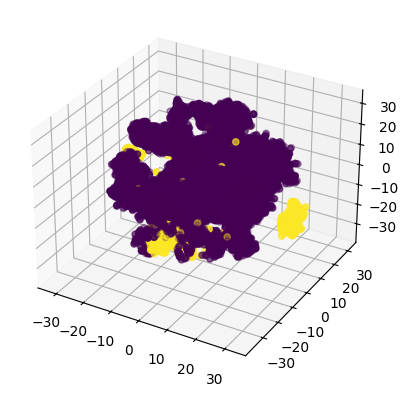


t-SNE 2D: 


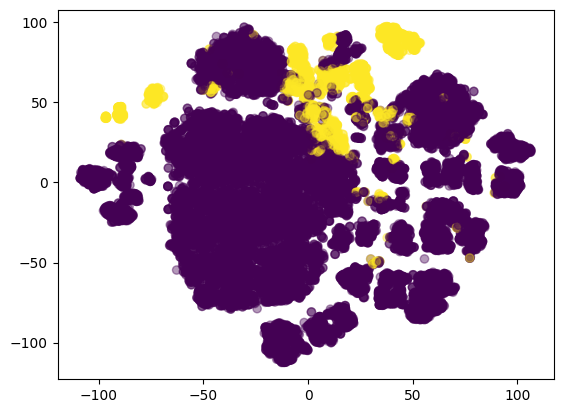

In [48]:
do_visualize(y_pred, False)

### Parametric Methods: Multivariate Outliers

In [50]:
def multi_to_uni (data):

    S = np.linalg.inv(data.cov())
    mdist = []
    for index, row in data.iterrows():
        feat = np.array(row) 
        mdist.append(feat @ S @ feat.T)
    return(pd.Series(mdist))

In [51]:
outliers = zscore_outlier(multi_to_uni(X_train), 2.5)
y_pred = np.array(outliers)

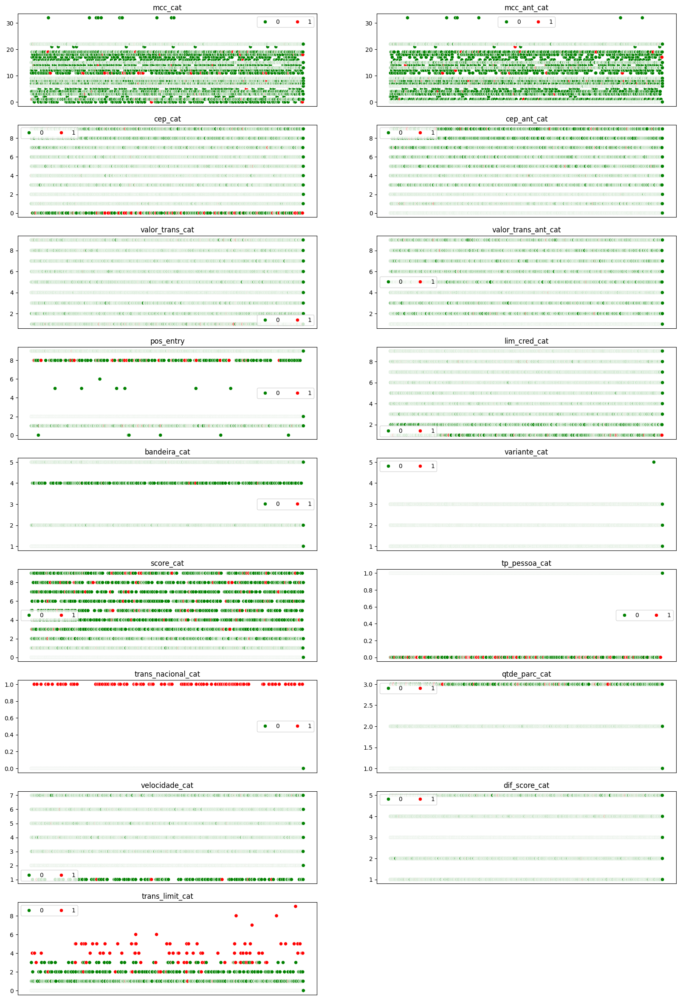

In [52]:
fig, ax = plt.subplots(9, 2, figsize=(20, 30))
row = col = 0
for n,i in enumerate(X_train.columns):
    if (n % 2 == 0) & (n > 0):
        row += 1
        col = 0
    sns.scatterplot(x = np.arange(len(X_train[i])), y = X_train[i], ax = ax[row, col], hue = y_pred, palette = ['green','red'])
    ax[row,col].set_ylabel("")
    ax[row,col].set_title(i)
    ax[row,col].xaxis.set_visible(False)
    if sum(outliers) > 0:
        ax[row,col].legend(ncol=2)
    col += 1
ax[row,col].axis('off')
plt.show()

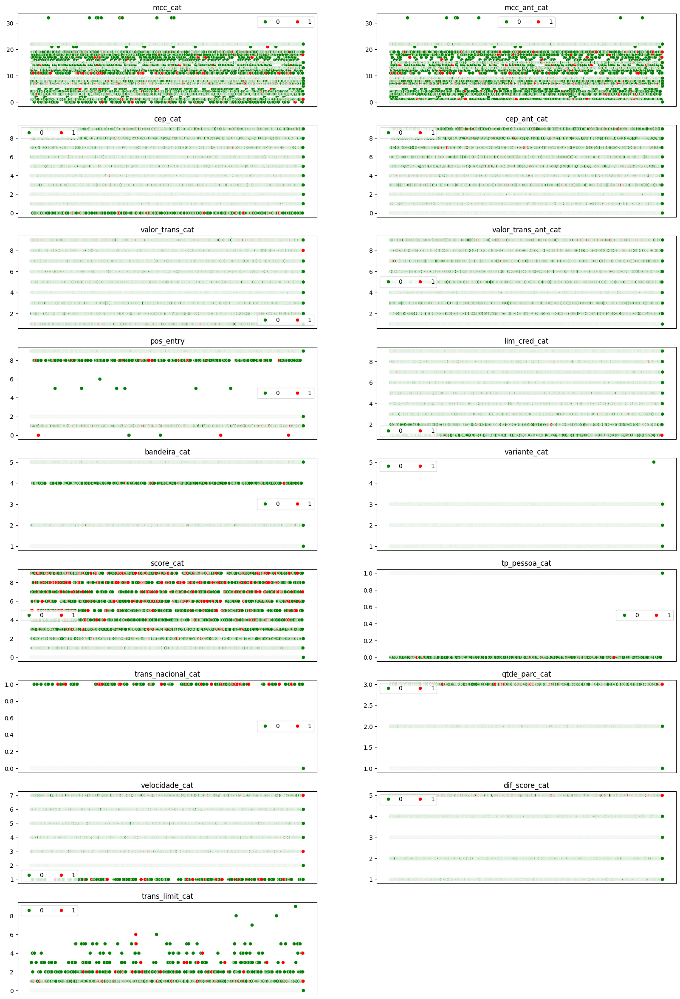

In [53]:
fig, ax = plt.subplots(9, 2, figsize=(20, 30))
row = col = 0
for n,i in enumerate(X_train.columns):
    if (n % 2 == 0) & (n > 0):
        row += 1
        col = 0
    sns.scatterplot(x = np.arange(len(X_train[i])), y = X_train[i], ax = ax[row, col], hue = np.array(y_train), palette = ['green','red'])
    ax[row,col].set_ylabel("")
    ax[row,col].set_title(i)
    ax[row,col].xaxis.set_visible(False)
    if sum(outliers) > 0:
        ax[row,col].legend(ncol=2)
    col += 1
ax[row,col].axis('off')
plt.show()

precision_score: 0.5675722432637829
recall_score: 0.5290772335351311
f1_score: 0.5380581166476743
accuracy_score: 0.9496057442403418

              precision    recall  f1-score   support

           0       0.96      0.99      0.97     21804
           1       0.17      0.07      0.10       897

    accuracy                           0.95     22701
   macro avg       0.57      0.53      0.54     22701
weighted avg       0.93      0.95      0.94     22701




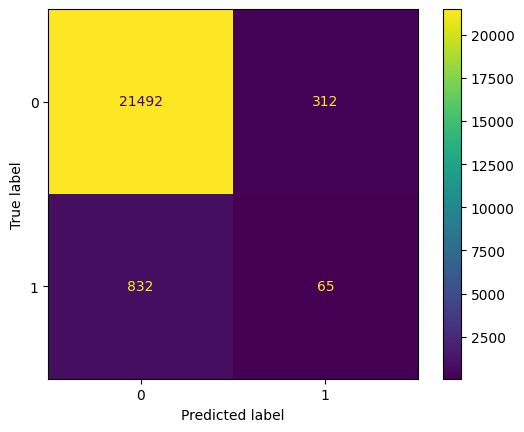

In [54]:
metrics_of_methodes["Mahalaobis-distance"] = calculate_metrics(y_train, y_pred)

PCA 3D: 


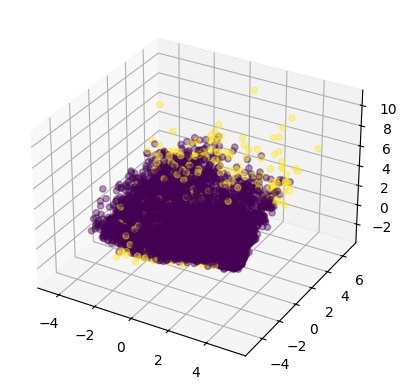


PCA 2D: 


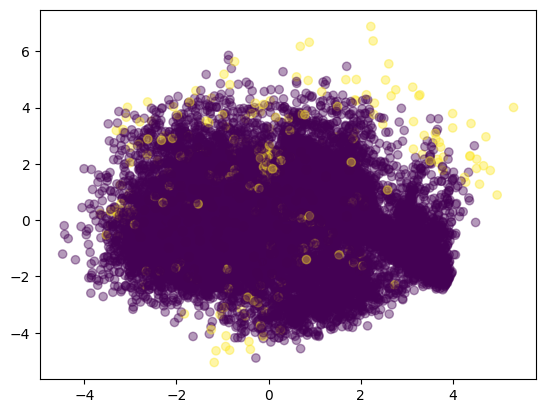


t-SNE 3D: 


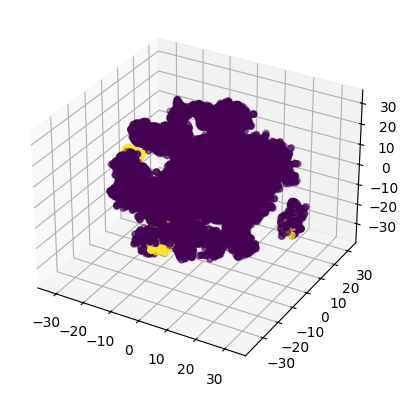


t-SNE 2D: 


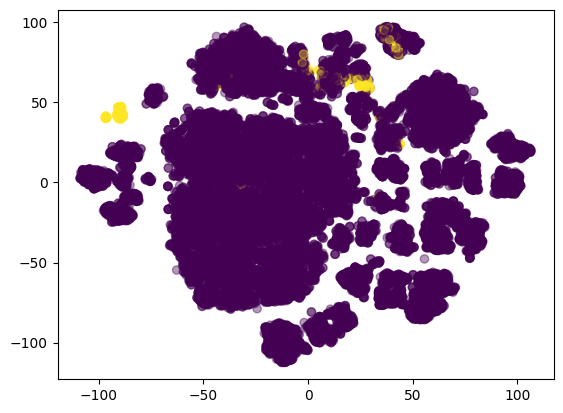

In [55]:
do_visualize(y_pred, False)

## Imbalanced Data

### Base Classifier

In [57]:
def base_mlp_model (dim_in):
    # Input
    fea = tf.keras.layers.Input(shape = (dim_in, ))

    layer_1 = tf.keras.layers.Dense(300, activation="elu")(fea)
    layer_1 = tf.keras.layers.BatchNormalization()(layer_1)
    layer_2 = tf.keras.layers.Dense(300, activation="elu")(layer_1)
    layer_2 = tf.keras.layers.BatchNormalization()(layer_2)
    layer_3 = tf.keras.layers.Dense(300, activation="elu")(layer_2)
    layer_3 = tf.keras.layers.BatchNormalization()(layer_3)
    pred = tf.keras.layers.Dense(1, activation="sigmoid")(layer_3)

    # Model
    model = tf.keras.Model(inputs=[fea], outputs=[pred])

    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.01), 
                  loss = tf.keras.losses.binary_crossentropy, 
                  metrics=['accuracy'])

    return(model)

def train_base_model (X, y, dim_in, test=None):
    model_ = base_mlp_model(dim_in)

    history = model_.fit(
        X, y,
        batch_size=32,
        epochs=10,
        verbose="auto",
        callbacks=None,
        validation_split=0.1,
        validation_data=None,
        shuffle=True,
        class_weight=None,
        sample_weight=None,
        initial_epoch=0,
        steps_per_epoch=None,
        validation_steps=None,
        validation_batch_size=None,
        validation_freq=1,
        max_queue_size=10,
        workers=1,
        use_multiprocessing=False,
        )
    
    if (test is not None):
        y_pred = model_.predict(test)
        return(model_, y_pred, history)
    
    return (model_, history)


In [58]:
b_model, y_pred, _ = train_base_model(X_train_normal, y_train, 17, X_test_normal)

Epoch 1/10
639/639 [==============================] - 5s 5ms/step - loss: 0.1668 - accuracy: 0.9512 - val_loss: 0.1255 - val_accuracy: 0.9608
Epoch 2/10
639/639 [==============================] - 3s 5ms/step - loss: 0.1332 - accuracy: 0.9593 - val_loss: 0.1189 - val_accuracy: 0.9604
Epoch 3/10
639/639 [==============================] - 4s 6ms/step - loss: 0.1297 - accuracy: 0.9594 - val_loss: 0.1107 - val_accuracy: 0.9613
Epoch 4/10
639/639 [==============================] - 3s 5ms/step - loss: 0.1277 - accuracy: 0.9592 - val_loss: 0.1158 - val_accuracy: 0.9613
Epoch 5/10
639/639 [==============================] - 3s 5ms/step - loss: 0.1273 - accuracy: 0.9596 - val_loss: 0.1128 - val_accuracy: 0.9613
Epoch 6/10
639/639 [==============================] - 3s 5ms/step - loss: 0.1243 - accuracy: 0.9603 - val_loss: 0.1120 - val_accuracy: 0.9604
Epoch 7/10
639/639 [==============================] - 3s 5ms/step - loss: 0.1236 - accuracy: 0.9594 - val_loss: 0.1116 - val_accuracy: 0.9626
Epoch 

precision_score: 0.7191100577631404
recall_score: 0.6573832669531495
f1_score: 0.6824994816866998
accuracy_score: 0.9585976039464411

              precision    recall  f1-score   support

           0       0.97      0.98      0.98      5452
           1       0.47      0.33      0.39       224

    accuracy                           0.96      5676
   macro avg       0.72      0.66      0.68      5676
weighted avg       0.95      0.96      0.96      5676




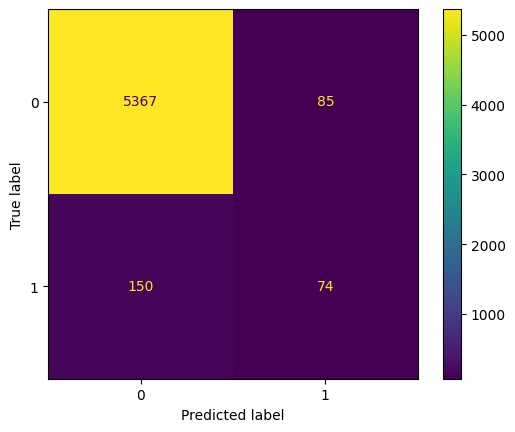

AUC score is  0.8384947201551199


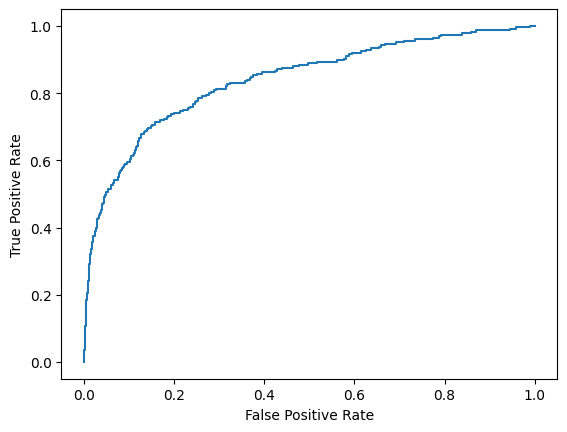

AUPRC score is  0.29635545847558975


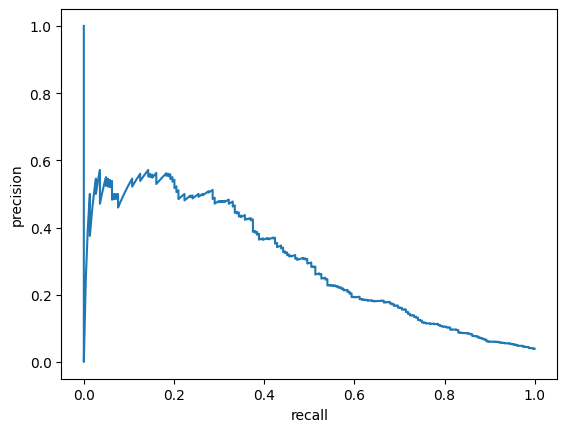

In [64]:
metrics_of_methodes["Base_Classifire"] = calculate_metrics(y_test, y_pred, is_prob=True, threshold=0.3)

PCA 3D: 


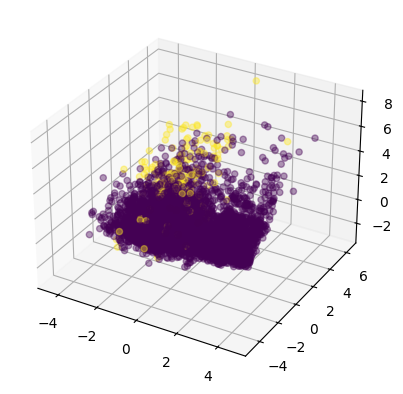


PCA 2D: 


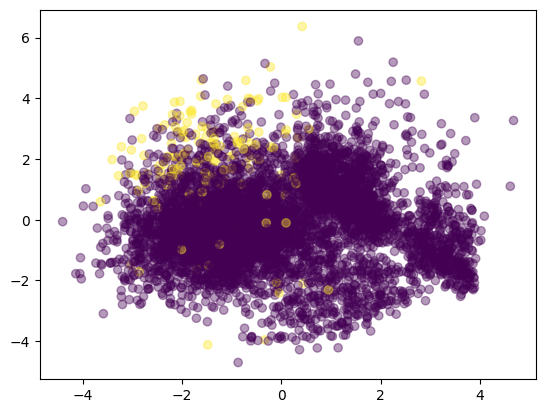


t-SNE 3D: 


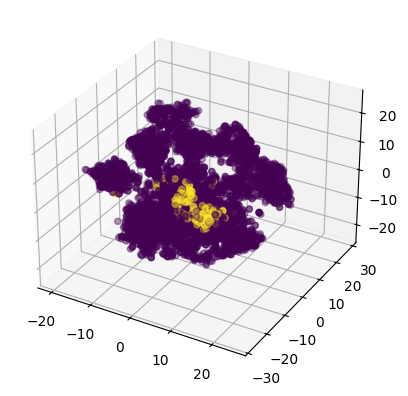


t-SNE 2D: 


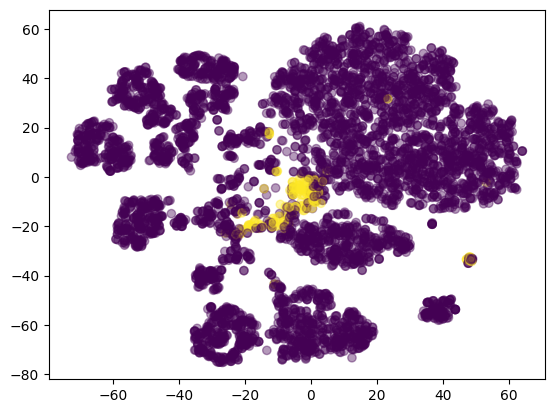

In [66]:
y_pred = np.where(y_pred>0.3, 1, 0)
do_visualize(y_pred, True)

Epoch 1/10
639/639 [==============================] - 7s 8ms/step - loss: 0.1722 - accuracy: 0.9519 - val_loss: 0.1451 - val_accuracy: 0.9542
Epoch 2/10
639/639 [==============================] - 4s 7ms/step - loss: 0.1406 - accuracy: 0.9596 - val_loss: 0.1332 - val_accuracy: 0.9546
Epoch 3/10
639/639 [==============================] - 4s 7ms/step - loss: 0.1376 - accuracy: 0.9601 - val_loss: 0.1289 - val_accuracy: 0.9617
Epoch 4/10
639/639 [==============================] - 4s 6ms/step - loss: 0.1382 - accuracy: 0.9602 - val_loss: 0.1291 - val_accuracy: 0.9613
Epoch 5/10
639/639 [==============================] - 4s 6ms/step - loss: 0.1380 - accuracy: 0.9596 - val_loss: 0.1399 - val_accuracy: 0.9599
Epoch 6/10
639/639 [==============================] - 4s 6ms/step - loss: 0.1352 - accuracy: 0.9596 - val_loss: 0.1233 - val_accuracy: 0.9599
Epoch 7/10
639/639 [==============================] - 4s 6ms/step - loss: 0.1348 - accuracy: 0.9598 - val_loss: 0.1210 - val_accuracy: 0.9604
Epoch 

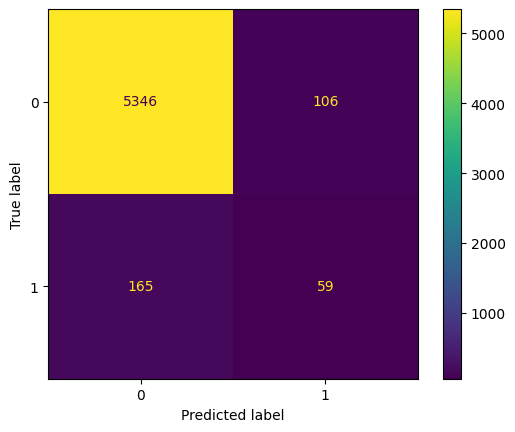

AUC score is  0.8235960263599204


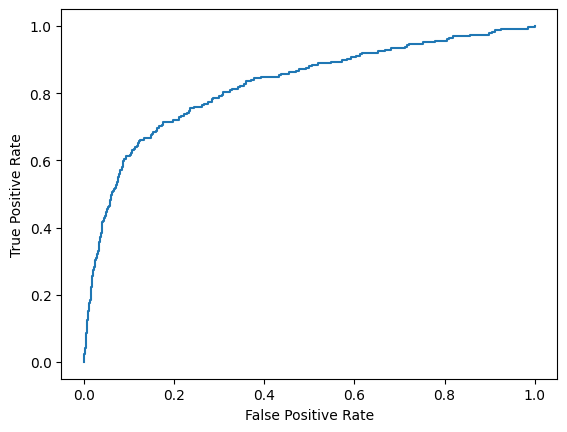

AUPRC score is  0.22599324425782327


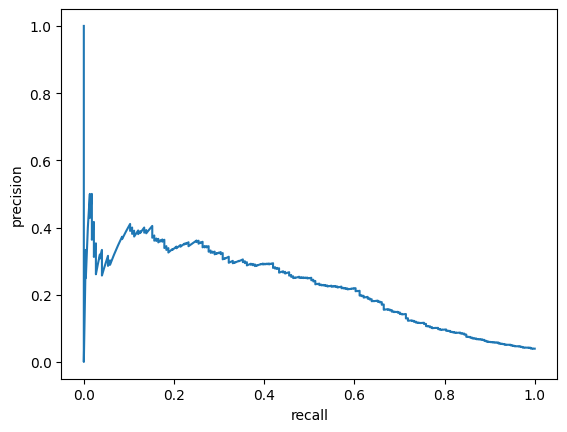

[0.6638178189076392, 0.6219752253432554, 0.6393111956154459, 0.9522551092318534, 0.8235960263599204, 0.22599324425782327]


In [127]:
b_model, y_pred, _ = train_base_model(reducted_data[:, :5], y_train, 5, reducted_test[:, :5])
print(calculate_metrics(y_test, y_pred, is_prob=True))

### Algorithmic Level

#### Cost Sensitive Learning

In [67]:
def find_weights (label):
    weights_dict = dict()
    for cls in np.unique(label):
        weights_dict[cls] = np.count_nonzero(label == cls)
    max_num = max(weights_dict.values())
    for cls in weights_dict:
        weights_dict[cls] = max_num / weights_dict[cls]
    
    return(weights_dict)

In [68]:
cw = find_weights (y_train)
cw

{0: 1.0, 1: 24.307692307692307}

In [69]:
model_ = base_mlp_model(17)

In [70]:
history = model_.fit(
    X_train_normal, y_train,
    batch_size=64,
    epochs=5,
    verbose="auto",
    callbacks=None,
    validation_split=0.1,
    validation_data=None,
    shuffle=True,
    class_weight=cw,
    sample_weight=None,
    initial_epoch=0,
    steps_per_epoch=None,
    validation_steps=None,
    validation_batch_size=None,
    validation_freq=1,
    max_queue_size=10,
    workers=1,
    use_multiprocessing=False,
    )

Epoch 1/5
320/320 [==============================] - 4s 6ms/step - loss: 1.1757 - accuracy: 0.7553 - val_loss: 0.5750 - val_accuracy: 0.8397
Epoch 2/5
320/320 [==============================] - 2s 5ms/step - loss: 0.9672 - accuracy: 0.7843 - val_loss: 0.5772 - val_accuracy: 0.7569
Epoch 3/5
320/320 [==============================] - 2s 7ms/step - loss: 0.9210 - accuracy: 0.7988 - val_loss: 0.5619 - val_accuracy: 0.7332
Epoch 4/5
320/320 [==============================] - 2s 6ms/step - loss: 0.8941 - accuracy: 0.8094 - val_loss: 0.6523 - val_accuracy: 0.6530
Epoch 5/5
320/320 [==============================] - 2s 6ms/step - loss: 0.8935 - accuracy: 0.8086 - val_loss: 0.4196 - val_accuracy: 0.8639


In [71]:
y_pred = model_.predict(X_test_normal)

178/178 [==============================] - 1s 3ms/step


precision_score: 0.6575828903596126
recall_score: 0.690989872654858
f1_score: 0.6723744064150465
accuracy_score: 0.945031712473573

              precision    recall  f1-score   support

           0       0.98      0.97      0.97      5452
           1       0.34      0.42      0.37       224

    accuracy                           0.95      5676
   macro avg       0.66      0.69      0.67      5676
weighted avg       0.95      0.95      0.95      5676




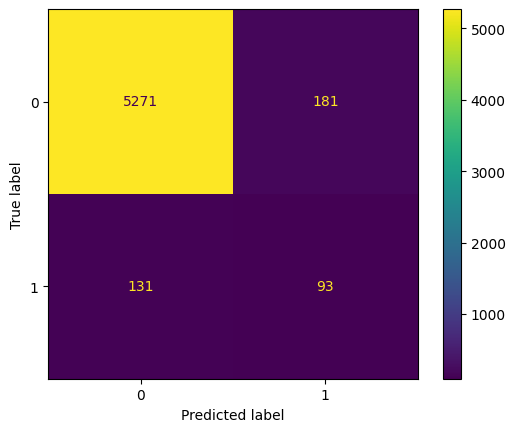

AUC score is  0.8413819306152395


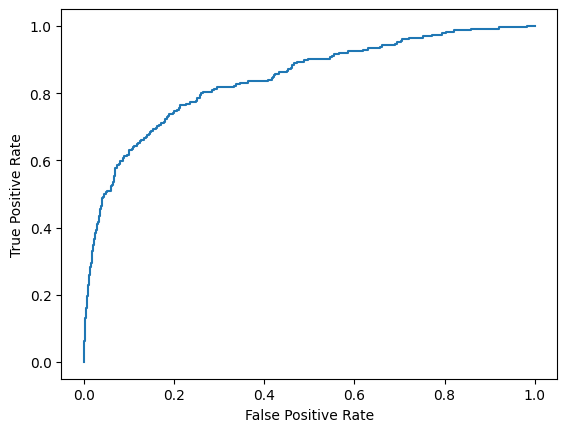

AUPRC score is  0.30310021711854657


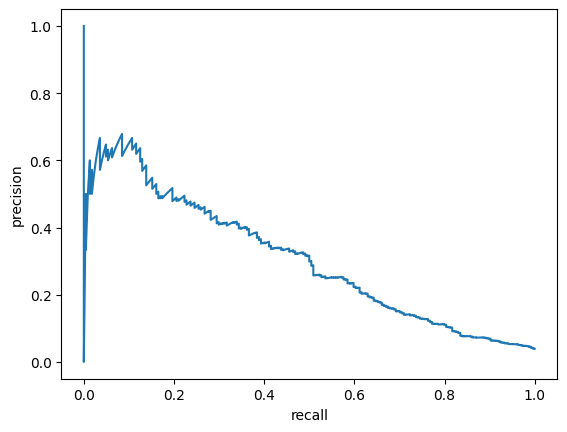

In [83]:
metrics_of_methodes["ReWeighting"] = calculate_metrics(y_test, y_pred, is_prob=True, threshold=0.85)

PCA 3D: 


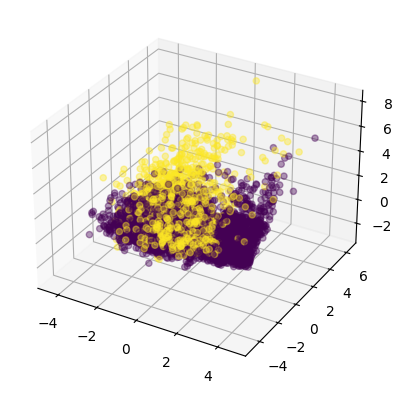


PCA 2D: 


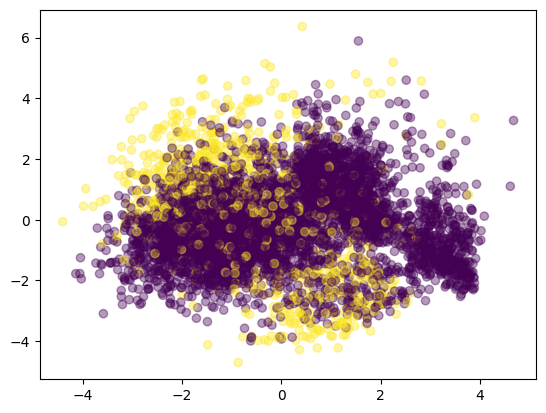


t-SNE 3D: 


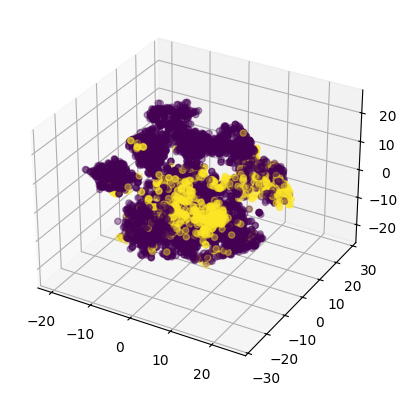


t-SNE 2D: 


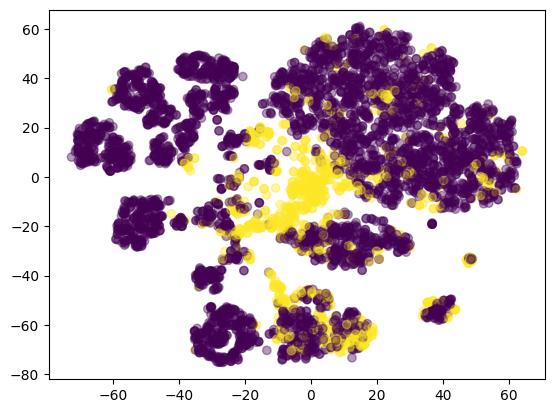

In [85]:
y_pred = np.where(y_pred>0.5, 1, 0)
do_visualize(y_pred, True)

In [134]:
model_ = base_mlp_model(5)

In [135]:
history = model_.fit(
    reducted_data[:, :5], y_train,
    batch_size=64,
    epochs=5,
    verbose="auto",
    callbacks=None,
    validation_split=0.1,
    validation_data=None,
    shuffle=True,
    class_weight=cw,
    sample_weight=None,
    initial_epoch=0,
    steps_per_epoch=None,
    validation_steps=None,
    validation_batch_size=None,
    validation_freq=1,
    max_queue_size=10,
    workers=1,
    use_multiprocessing=False,
    )

Epoch 1/5
320/320 [==============================] - 4s 6ms/step - loss: 1.2082 - accuracy: 0.7249 - val_loss: 0.5078 - val_accuracy: 0.7622
Epoch 2/5
320/320 [==============================] - 2s 6ms/step - loss: 1.0541 - accuracy: 0.7561 - val_loss: 0.6481 - val_accuracy: 0.7376
Epoch 3/5
320/320 [==============================] - 2s 6ms/step - loss: 0.9988 - accuracy: 0.7700 - val_loss: 0.6312 - val_accuracy: 0.6623
Epoch 4/5
320/320 [==============================] - 2s 5ms/step - loss: 0.9965 - accuracy: 0.7652 - val_loss: 0.5295 - val_accuracy: 0.7653
Epoch 5/5
320/320 [==============================] - 2s 6ms/step - loss: 0.9823 - accuracy: 0.7577 - val_loss: 0.4423 - val_accuracy: 0.8349


178/178 [==============================] - 1s 3ms/step
precision_score: 0.5707852869228108
recall_score: 0.7578149565035112
f1_score: 0.5847112109083296
accuracy_score: 0.8472515856236786

              precision    recall  f1-score   support

           0       0.98      0.85      0.91      5452
           1       0.16      0.66      0.25       224

    accuracy                           0.85      5676
   macro avg       0.57      0.76      0.58      5676
weighted avg       0.95      0.85      0.89      5676




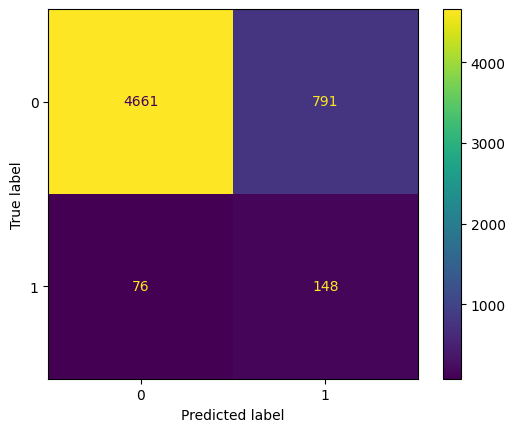

AUC score is  0.822515164815009


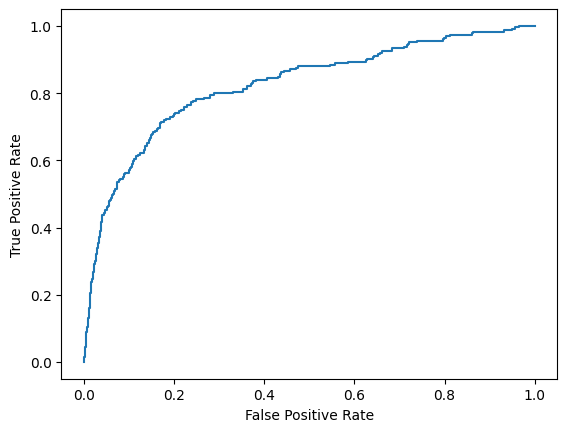

AUPRC score is  0.2226219000600172


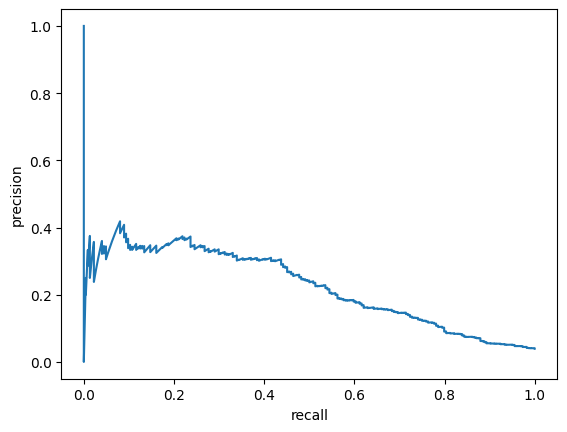

[0.5707852869228108,
 0.7578149565035112,
 0.5847112109083296,
 0.8472515856236786,
 0.822515164815009,
 0.2226219000600172]

In [136]:
y_pred = model_.predict(reducted_test[:, :5])
calculate_metrics(y_test, y_pred, is_prob=True)

#### One Class Learning

##### One-Class Support Vector Machines

In [86]:
from sklearn.svm import OneClassSVM

In [87]:
model = OneClassSVM(gamma='scale')
model.fit(X_train_normal[y_train == 0])

OneClassSVM()

In [88]:
yhat = model.predict(X_test_normal)
y_pred = np.where(yhat == 1, 0, 1)

precision_score: 0.5268660139395167
recall_score: 0.6770729614296196
f1_score: 0.39360780628382924
accuracy_score: 0.5153276955602537

              precision    recall  f1-score   support

           0       0.99      0.50      0.67      5452
           1       0.07      0.85      0.12       224

    accuracy                           0.52      5676
   macro avg       0.53      0.68      0.39      5676
weighted avg       0.95      0.52      0.64      5676




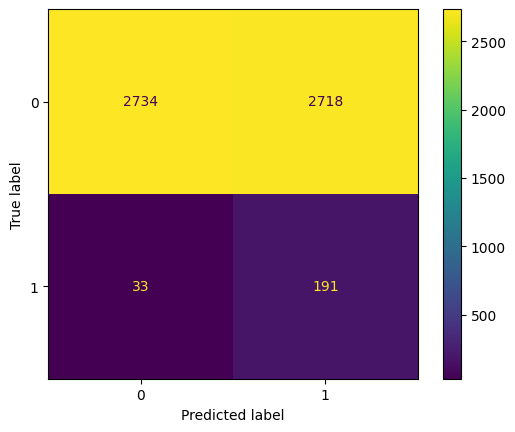

In [90]:
metrics_of_methodes["OC-SVM"] = calculate_metrics(y_test, y_pred)

PCA 3D: 


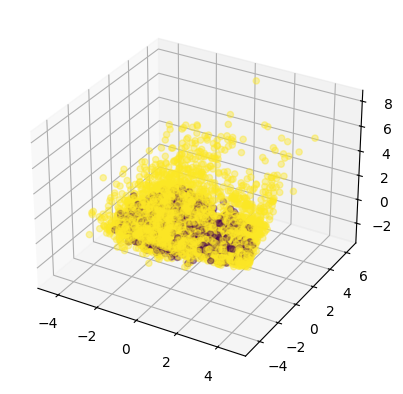


PCA 2D: 


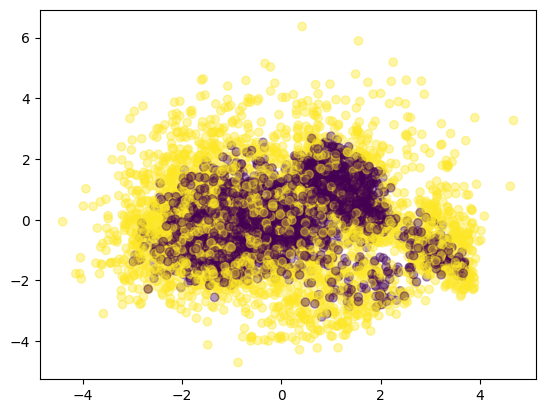


t-SNE 3D: 


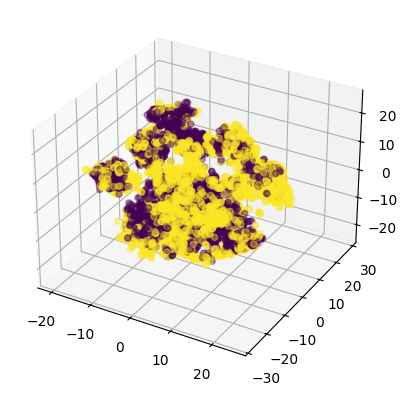


t-SNE 2D: 


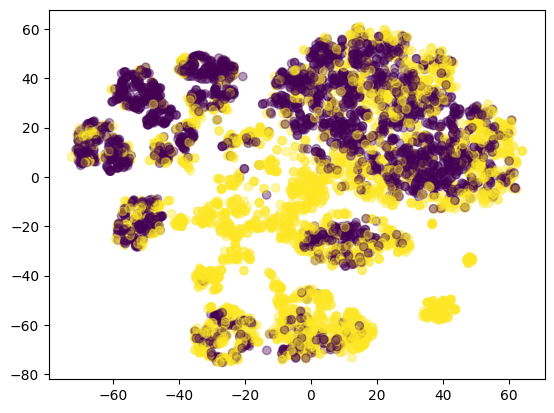

In [93]:
do_visualize(y_pred, True)

In [141]:
model = OneClassSVM(gamma='scale')
model.fit(reducted_data[y_train == 0][:, :5])

OneClassSVM()

precision_score: 0.5188955384428852
recall_score: 0.6244202651713657
f1_score: 0.38019122196982313
accuracy_score: 0.5005285412262156

              precision    recall  f1-score   support

           0       0.98      0.49      0.65      5452
           1       0.06      0.76      0.11       224

    accuracy                           0.50      5676
   macro avg       0.52      0.62      0.38      5676
weighted avg       0.94      0.50      0.63      5676




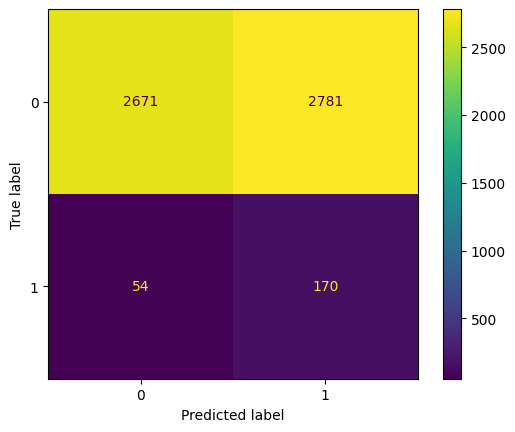

[0.5188955384428852,
 0.6244202651713657,
 0.38019122196982313,
 0.5005285412262156]

In [142]:
yhat = model.predict(reducted_test[:, :5])
y_pred = np.where(yhat == 1, 0, 1)
calculate_metrics(y_test, y_pred)

##### One-Class Reconstruction Error

In [94]:
class My_CVAE(tf.keras.Model):

    def __init__(self, dim_in, latent_dim):
        super(My_CVAE, self).__init__()
        self.latent_dim = latent_dim

        fea = tf.keras.layers.Input(shape = (dim_in, ))

        # vec to mu and log_var
        x = tf.keras.layers.Dense(500, activation='elu')(fea)
        x = tf.keras.layers.BatchNormalization()(x)
        x = tf.keras.layers.Dense(250, activation='elu')(x)
        x = tf.keras.layers.BatchNormalization()(x)
        x = tf.keras.layers.Dense(200, activation='elu')(x)
        x = tf.keras.layers.BatchNormalization()(x)
        x = tf.keras.layers.Dense(100, activation='elu')(x)
        x = tf.keras.layers.BatchNormalization()(x)
        encoded = tf.keras.layers.Dense(self.latent_dim + self.latent_dim)(x)
        self.encoder = tf.keras.Model(inputs=[fea], outputs=[encoded])  


        # hidden space to vec
        embedd = tf.keras.layers.Input((self.latent_dim,))
        x = tf.keras.layers.Dense(100, activation='elu')(embedd)
        x = tf.keras.layers.BatchNormalization()(x)
        x = tf.keras.layers.Dense(200, activation='elu')(x)
        x = tf.keras.layers.BatchNormalization()(x)
        x = tf.keras.layers.Dense(250, activation='elu')(x)
        x = tf.keras.layers.BatchNormalization()(x)
        x = tf.keras.layers.Dense(500, activation='elu')(x)
        x = tf.keras.layers.BatchNormalization()(x)
        rec = tf.keras.layers.Dense(dim_in, activation='linear')(x)

        self.decoder = tf.keras.Model(inputs=[embedd], outputs=[rec])

    # Sample z ~ Q(z|X,y)
    @tf.function
    def sample(self, y, eps=None ):
        if eps is None:
            eps = tf.random.normal(shape=(y.shape[0], self.latent_dim))
        #return self.decode(eps)
        return self.decode(eps, y, apply_sigmoid=False)

    def encode(self, x):
        mean, logvar = tf.split(self.encoder(x), num_or_size_splits=2, axis=1)
        return mean, logvar

    def reparameterize(self, mean, logvar):
        eps = tf.random.normal(shape=mean.shape)
        return eps * tf.exp(logvar * .5) + mean

    def decode(self, z, apply_sigmoid=False):
        logits = self.decoder(z)
        if apply_sigmoid:
            probs = tf.sigmoid(logits)
            return probs
        return logits
    
    def call(self, data):
        mean, logvar = self.encode(data)
        z = self.reparameterize(mean, logvar)
        predictions = self.decode(z)
        return(predictions)

In [95]:
generative_reconstruction = My_CVAE(17, 10)
generative_reconstruction.compile(optimizer='adam', loss='mse')

In [96]:
normal_class = np.copy(X_train_normal[y_train == 0])
normal_class.shape

(21804, 17)

In [97]:
history = generative_reconstruction.fit(normal_class[:21792], normal_class[:21792], 
    batch_size=None,
    epochs=10,
    verbose="auto",
    callbacks=None,
    validation_split=None,
    validation_data=None,
    shuffle=True,
    class_weight=None,
    sample_weight=None,
    initial_epoch=0,
    steps_per_epoch=None,
    validation_steps=None,
    validation_batch_size=None,
    validation_freq=1,
    max_queue_size=10,
    workers=1,
    use_multiprocessing=False,
        )

Epoch 1/10


681/681 [==============================] - 10s 8ms/step - loss: 0.2489
Epoch 2/10
681/681 [==============================] - 5s 8ms/step - loss: 0.1394
Epoch 3/10
681/681 [==============================] - 5s 8ms/step - loss: 0.1206
Epoch 4/10
681/681 [==============================] - 5s 7ms/step - loss: 0.1149
Epoch 5/10
681/681 [==============================] - 5s 7ms/step - loss: 0.1118
Epoch 6/10
681/681 [==============================] - 5s 7ms/step - loss: 0.1017
Epoch 7/10
681/681 [==============================] - 5s 7ms/step - loss: 0.0984
Epoch 8/10
681/681 [==============================] - 5s 8ms/step - loss: 0.0952
Epoch 9/10
681/681 [==============================] - 5s 7ms/step - loss: 0.0920
Epoch 10/10
681/681 [==============================] - 5s 8ms/step - loss: 0.0875


In [98]:
X_train_normal.shape

(22701, 17)

In [99]:
reconstructed_data = generative_reconstruction.predict(X_train_normal[:22688])

709/709 [==============================] - 3s 4ms/step


In [100]:
reconstruction_error = np.square(reconstructed_data - X_train_normal[:22688]).mean(axis=1)
y_pred = (reconstruction_error - min (reconstruction_error)) / (max(reconstruction_error) - min (reconstruction_error))

precision_score: 0.5749830851448597
recall_score: 0.5787417631786966
f1_score: 0.5768005750865571
accuracy_score: 0.9341061354019746

              precision    recall  f1-score   support

           0       0.97      0.96      0.97     21791
           1       0.18      0.19      0.19       897

    accuracy                           0.93     22688
   macro avg       0.57      0.58      0.58     22688
weighted avg       0.94      0.93      0.93     22688




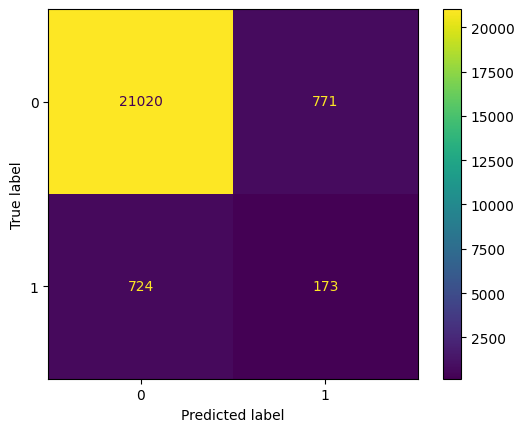

AUC score is  0.7609287828983635


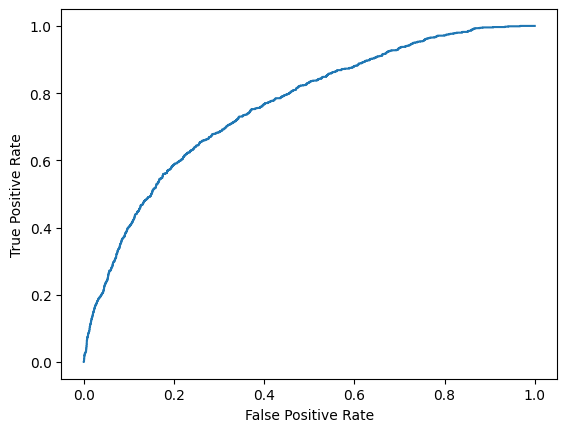

AUPRC score is  0.13256124123734764


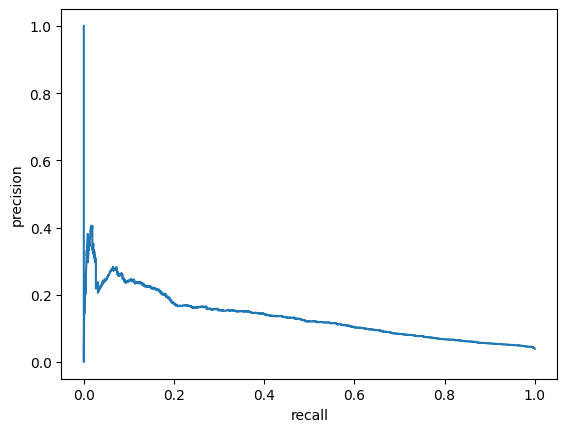

In [103]:
metrics_of_methodes["OC-Reconstruction_error"] = calculate_metrics(y_train[:22688], y_pred, is_prob=True, threshold= 0.02)

In [151]:
generative_reconstruction = My_CVAE(5, 10)
generative_reconstruction.compile(optimizer='adam', loss='mse')

In [152]:
normal_class = np.copy(reducted_data[y_train == 0][:, :5])
normal_class.shape

(21804, 5)

In [153]:
history = generative_reconstruction.fit(normal_class[:21792], normal_class[:21792], 
    batch_size=None,
    epochs=10,
    verbose="auto",
    callbacks=None,
    validation_split=None,
    validation_data=None,
    shuffle=True,
    class_weight=None,
    sample_weight=None,
    initial_epoch=0,
    steps_per_epoch=None,
    validation_steps=None,
    validation_batch_size=None,
    validation_freq=1,
    max_queue_size=10,
    workers=1,
    use_multiprocessing=False,
        )

Epoch 1/10


681/681 [==============================] - 10s 8ms/step - loss: 0.2621
Epoch 2/10
681/681 [==============================] - 5s 7ms/step - loss: 0.1537
Epoch 3/10
681/681 [==============================] - 5s 8ms/step - loss: 0.1402
Epoch 4/10
681/681 [==============================] - 5s 7ms/step - loss: 0.1333
Epoch 5/10
681/681 [==============================] - 5s 8ms/step - loss: 0.1315
Epoch 6/10
681/681 [==============================] - 5s 7ms/step - loss: 0.1275
Epoch 7/10
681/681 [==============================] - 5s 7ms/step - loss: 0.1202
Epoch 8/10
681/681 [==============================] - 26s 38ms/step - loss: 0.1177
Epoch 9/10
681/681 [==============================] - 16s 23ms/step - loss: 0.1107
Epoch 10/10
681/681 [==============================] - 8s 12ms/step - loss: 0.1053


In [154]:
reducted_data.shape

(22701, 17)

In [155]:
reconstructed_data = generative_reconstruction.predict(reducted_data[:22688, :5])

709/709 [==============================] - 4s 5ms/step


In [156]:
reconstruction_error = np.square(reconstructed_data - reducted_data[:22688, :5]).mean(axis=1)
y_pred = (reconstruction_error - min (reconstruction_error)) / (max(reconstruction_error) - min (reconstruction_error))

precision_score: 0.6059188996583014
recall_score: 0.5307574588570133
f1_score: 0.5432057082298628
accuracy_score: 0.9548660084626234

              precision    recall  f1-score   support

           0       0.96      0.99      0.98     21791
           1       0.25      0.07      0.11       897

    accuracy                           0.95     22688
   macro avg       0.61      0.53      0.54     22688
weighted avg       0.93      0.95      0.94     22688




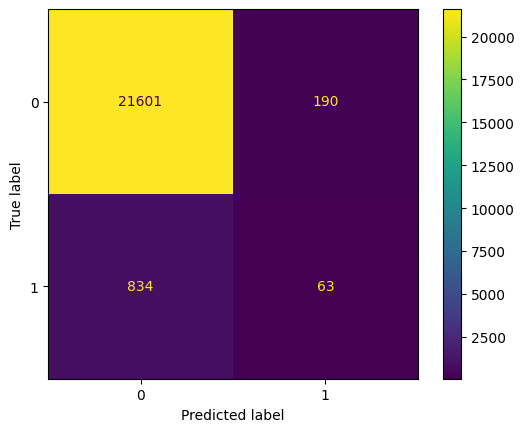

AUC score is  0.549683583175671


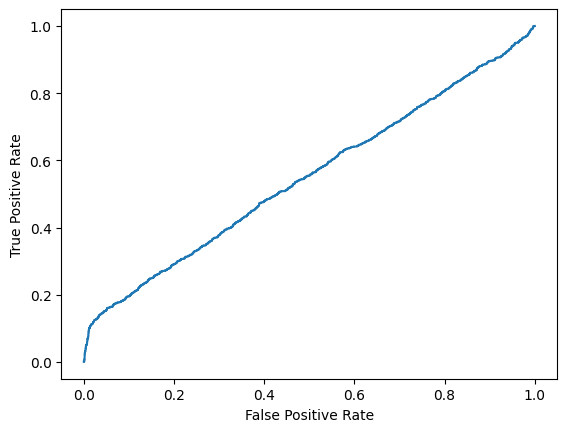

AUPRC score is  0.07542467423835816


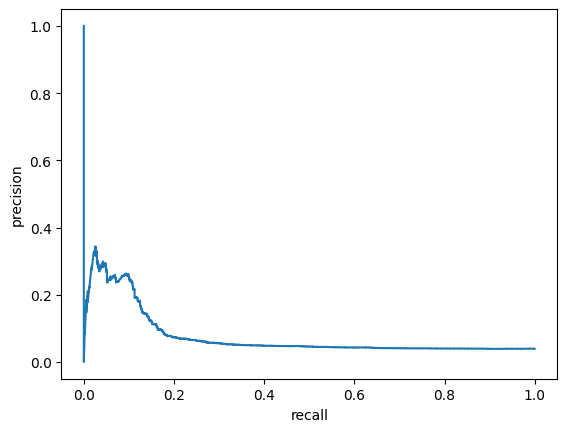

[0.6059188996583014,
 0.5307574588570133,
 0.5432057082298628,
 0.9548660084626234,
 0.549683583175671,
 0.07542467423835816]

In [157]:
calculate_metrics(y_train[:22688], y_pred, is_prob=True, threshold= 0.04)

#### Ensemble methods

##### Balanced Bagging Classifier

In [105]:
from imblearn.ensemble import BalancedBaggingClassifier
from sklearn.tree import DecisionTreeClassifier

In [106]:
bbc = BalancedBaggingClassifier(base_estimator=DecisionTreeClassifier(),
                                sampling_strategy="auto",
                                replacement=False,
                                random_state=0)

In [107]:
bbc.fit(X_train_normal, y_train)

BalancedBaggingClassifier(base_estimator=DecisionTreeClassifier(),
                          random_state=0)

In [108]:
y_pred = bbc.predict(X_test_normal)

precision_score: 0.5844728556123029
recall_score: 0.7703791531286028
f1_score: 0.6089018465849562
accuracy_score: 0.8713883016208598

              precision    recall  f1-score   support

           0       0.98      0.88      0.93      5452
           1       0.18      0.66      0.29       224

    accuracy                           0.87      5676
   macro avg       0.58      0.77      0.61      5676
weighted avg       0.95      0.87      0.90      5676




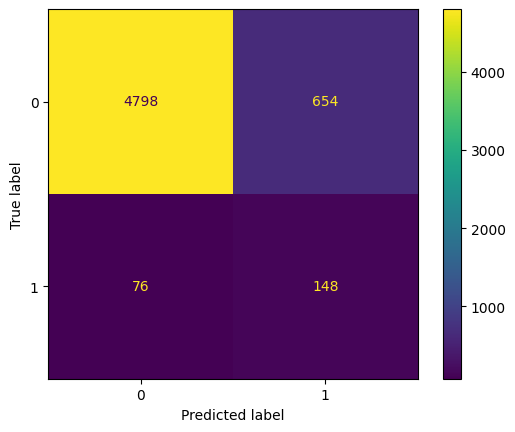

In [109]:
metrics_of_methodes["Balanced_Bagging_Classifier"] = calculate_metrics(y_test, y_pred)

PCA 3D: 


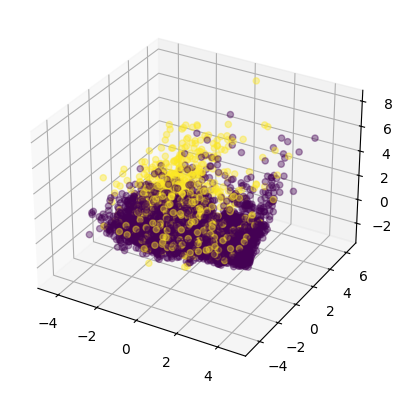


PCA 2D: 


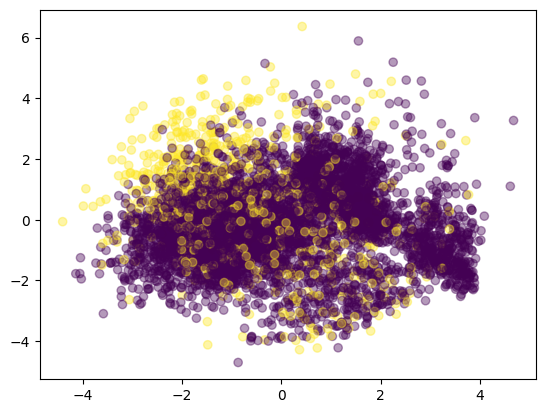


t-SNE 3D: 


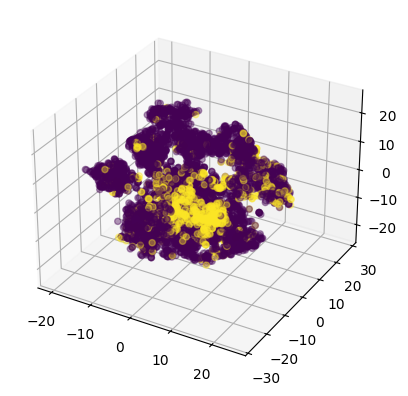


t-SNE 2D: 


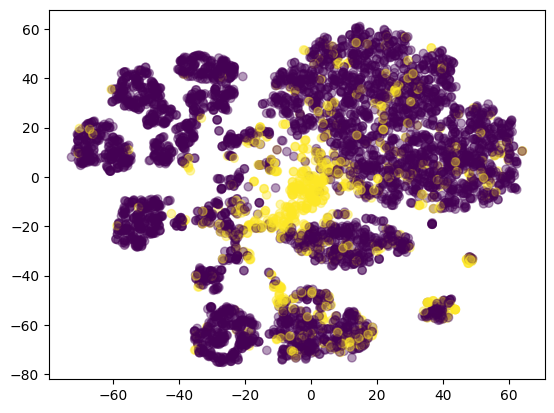

In [111]:
do_visualize(y_pred, True)

In [163]:
bbc = BalancedBaggingClassifier(base_estimator=DecisionTreeClassifier(),
                                sampling_strategy="auto",
                                replacement=False,
                                random_state=0)

In [164]:
bbc.fit(reducted_data[:, :5], y_train)

BalancedBaggingClassifier(base_estimator=DecisionTreeClassifier(),
                          random_state=0)

precision_score: 0.5697840159426409
recall_score: 0.7337182947280159
f1_score: 0.5860640920116709
accuracy_score: 0.8585271317829457

              precision    recall  f1-score   support

           0       0.98      0.87      0.92      5452
           1       0.16      0.60      0.25       224

    accuracy                           0.86      5676
   macro avg       0.57      0.73      0.59      5676
weighted avg       0.95      0.86      0.90      5676




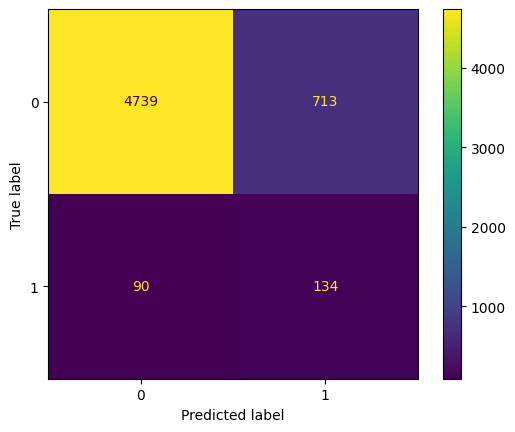

[0.5697840159426409,
 0.7337182947280159,
 0.5860640920116709,
 0.8585271317829457]

In [165]:
y_pred = bbc.predict(reducted_test[:, :5])
calculate_metrics(y_test, y_pred)

##### Forest of randomized trees

In [112]:
from imblearn.ensemble import BalancedRandomForestClassifier

In [113]:
brf = BalancedRandomForestClassifier(
    n_estimators=100, random_state=0, sampling_strategy="all", replacement=True
)

In [114]:
brf.fit(X_train_normal, y_train)

BalancedRandomForestClassifier(random_state=0, replacement=True,
                               sampling_strategy='all')

In [115]:
y_pred = brf.predict_proba(X_test_normal)

precision_score: 0.7001266691576501
recall_score: 0.6855151451629808
f1_score: 0.692501579047668
accuracy_score: 0.9550739957716702

              precision    recall  f1-score   support

           0       0.98      0.98      0.98      5452
           1       0.43      0.39      0.41       224

    accuracy                           0.96      5676
   macro avg       0.70      0.69      0.69      5676
weighted avg       0.95      0.96      0.95      5676




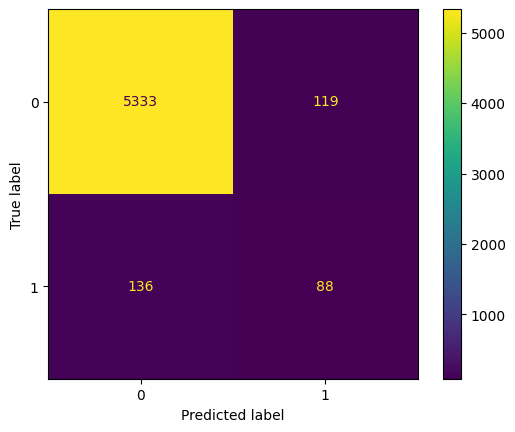

AUC score is  0.8865062624462844


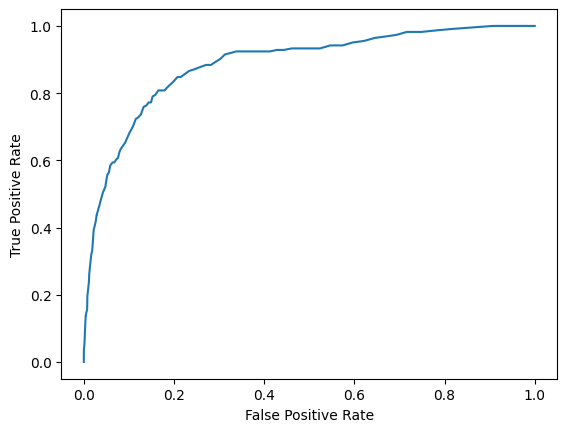

AUPRC score is  0.3497952875388838


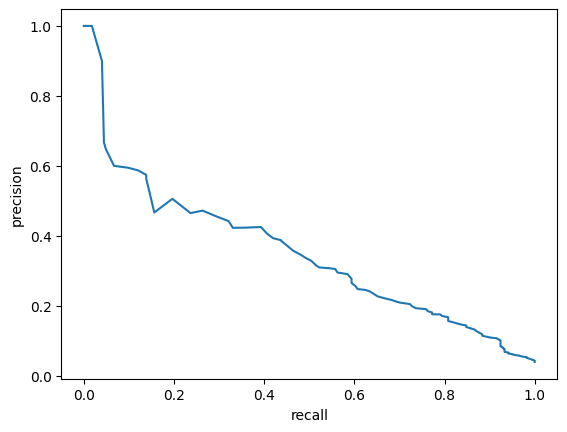

In [125]:
metrics_of_methodes["Forest_Randomized_Trees"] = calculate_metrics(y_test, y_pred[:,1], is_prob=True, threshold=0.8)

PCA 3D: 


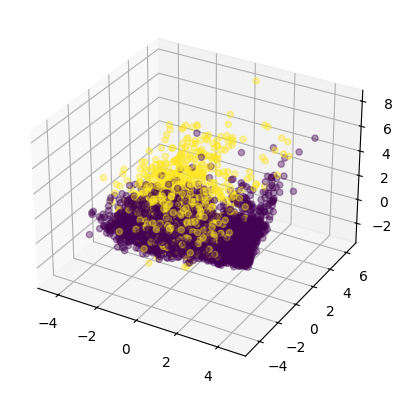


PCA 2D: 


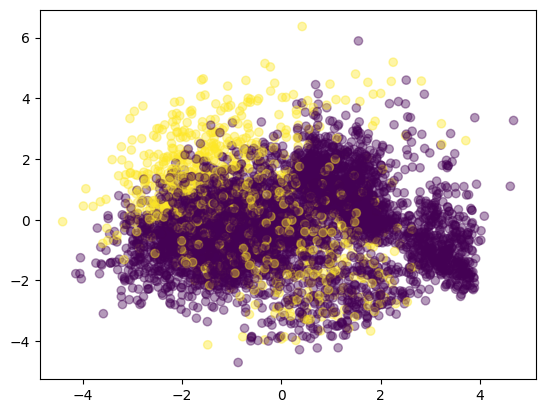


t-SNE 3D: 


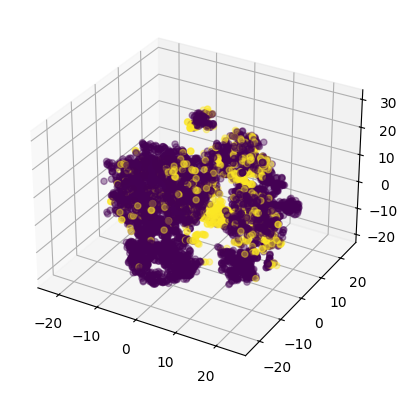


t-SNE 2D: 


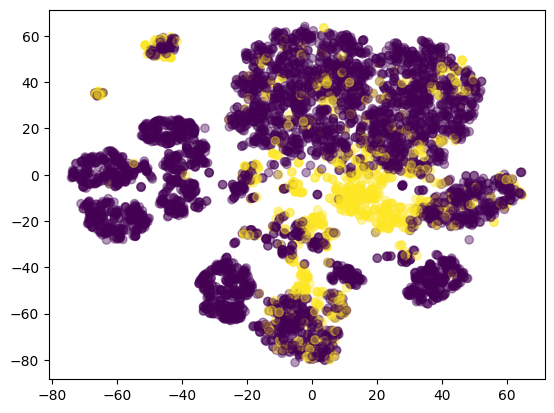

In [170]:
do_visualize(y_pred, True)

In [171]:
brf = BalancedRandomForestClassifier(
    n_estimators=100, random_state=0, sampling_strategy="all", replacement=True
)

In [172]:
brf.fit(reducted_data[:, :5], y_train)

BalancedRandomForestClassifier(random_state=0, replacement=True,
                               sampling_strategy='all')

precision_score: 0.5688299935358759
recall_score: 0.7637482313174719
f1_score: 0.5795242058509984
accuracy_score: 0.8380902043692742

              precision    recall  f1-score   support

           0       0.98      0.84      0.91      5452
           1       0.15      0.68      0.25       224

    accuracy                           0.84      5676
   macro avg       0.57      0.76      0.58      5676
weighted avg       0.95      0.84      0.88      5676




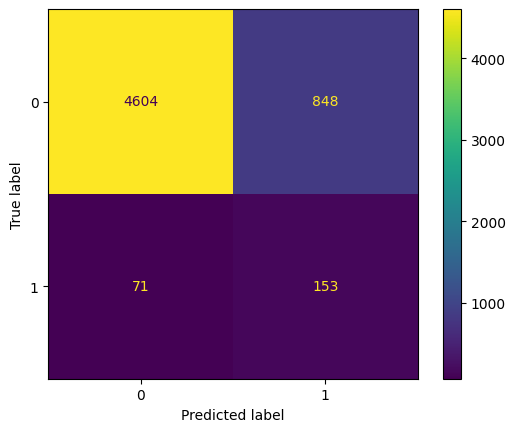

[0.5688299935358759,
 0.7637482313174719,
 0.5795242058509984,
 0.8380902043692742]

In [173]:
y_pred = brf.predict(reducted_test[:, :5])
calculate_metrics(y_test, y_pred)

##### RUS Boost Classifier

In [127]:
from imblearn.ensemble import RUSBoostClassifier
rusboost = RUSBoostClassifier(n_estimators=200, algorithm='SAMME.R',
                              random_state=0)

In [128]:
rusboost.fit(X_train_normal, y_train)

RUSBoostClassifier(n_estimators=200, random_state=0)

In [129]:
y_pred = rusboost.predict_proba(X_test_normal)

precision_score: 0.5787824147780305
recall_score: 0.796159338643748
f1_score: 0.5954144868768031
accuracy_score: 0.8468992248062015

              precision    recall  f1-score   support

           0       0.99      0.85      0.91      5452
           1       0.17      0.74      0.28       224

    accuracy                           0.85      5676
   macro avg       0.58      0.80      0.60      5676
weighted avg       0.96      0.85      0.89      5676




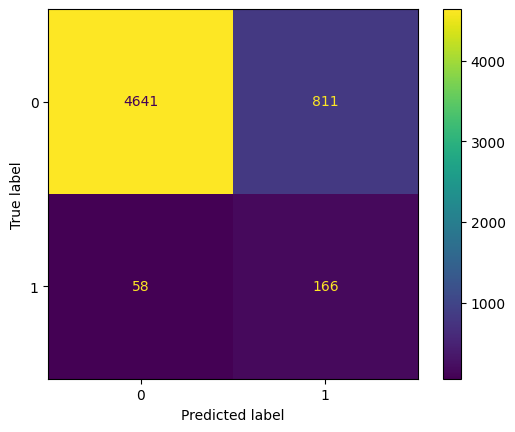

AUC score is  0.8696456411801698


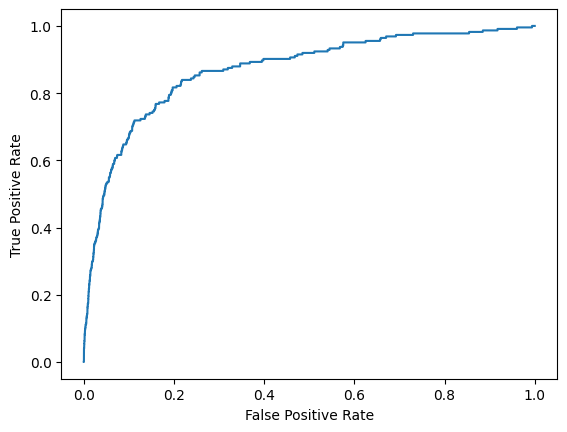

AUPRC score is  0.3103461814992752


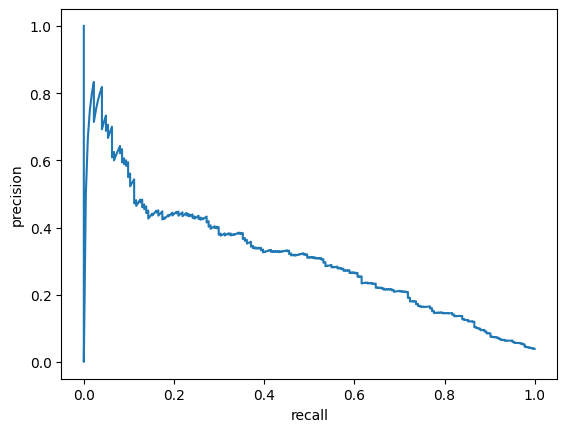

In [143]:
metrics_of_methodes["RUS-Boosting"] = calculate_metrics(y_test, y_pred[:, 1], is_prob=True)

PCA 3D: 


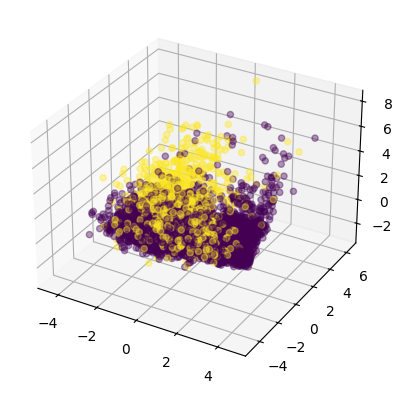


PCA 2D: 


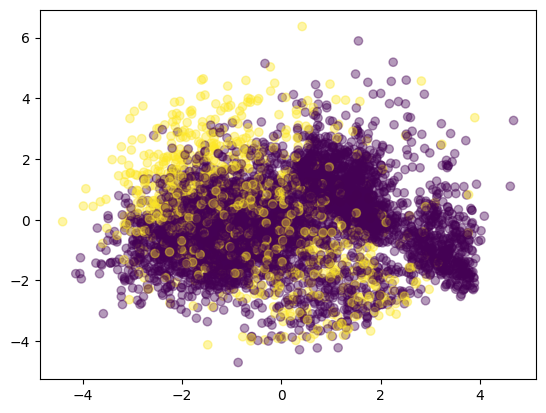


t-SNE 3D: 


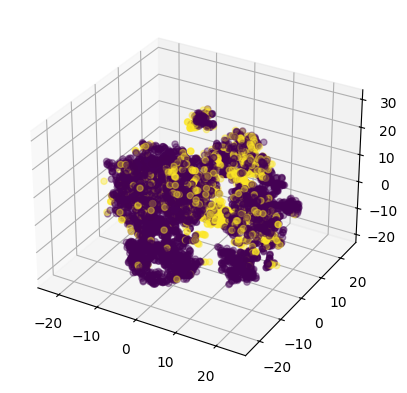


t-SNE 2D: 


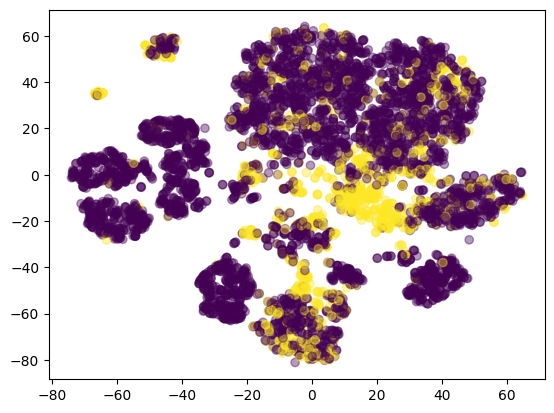

In [177]:
do_visualize(y_pred, True)

In [178]:
rusboost = RUSBoostClassifier(n_estimators=200, algorithm='SAMME.R',
                              random_state=0)

In [179]:
rusboost.fit(reducted_data[:, :5], y_train)

RUSBoostClassifier(n_estimators=200, random_state=0)

precision_score: 0.532255531897521
recall_score: 0.651384485378891
f1_score: 0.5096371177503649
accuracy_score: 0.7702607470049331

              precision    recall  f1-score   support

           0       0.98      0.78      0.87      5452
           1       0.09      0.52      0.15       224

    accuracy                           0.77      5676
   macro avg       0.53      0.65      0.51      5676
weighted avg       0.94      0.77      0.84      5676




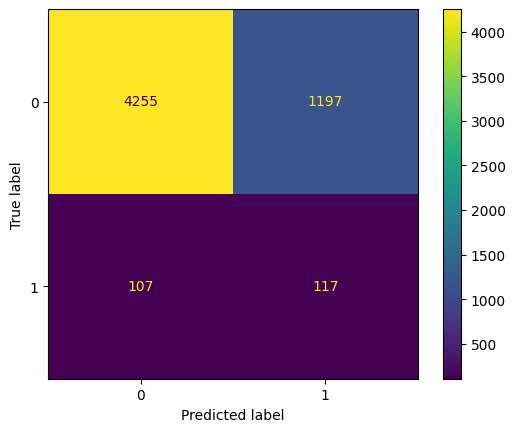

[0.532255531897521, 0.651384485378891, 0.5096371177503649, 0.7702607470049331]

In [180]:
y_pred = rusboost.predict(reducted_test[:, :5])
calculate_metrics(y_test, y_pred)

##### XGboost

In [145]:
from xgboost import XGBClassifier

In [146]:
xgb = XGBClassifier(n_estimators = 200)
xgb.fit(X_train_normal, y_train)


XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=200, n_jobs=None,
              num_parallel_tree=None, random_state=None, ...)

In [147]:
y_pred = xgb.predict_proba(X_test_normal)

precision_score: 0.7036793809126568
recall_score: 0.6879307069489571
f1_score: 0.6954403955319538
accuracy_score: 0.9556025369978859

              precision    recall  f1-score   support

           0       0.98      0.98      0.98      5452
           1       0.43      0.40      0.41       224

    accuracy                           0.96      5676
   macro avg       0.70      0.69      0.70      5676
weighted avg       0.95      0.96      0.95      5676




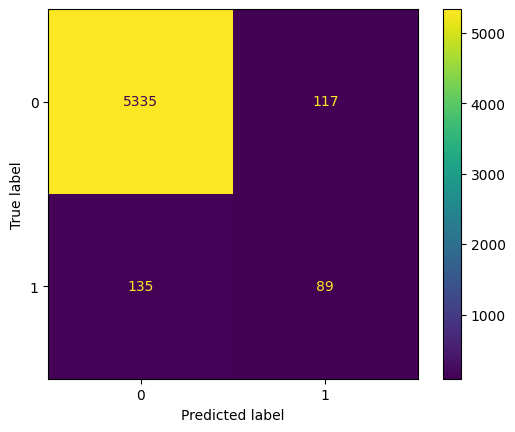

AUC score is  0.8718147337805262


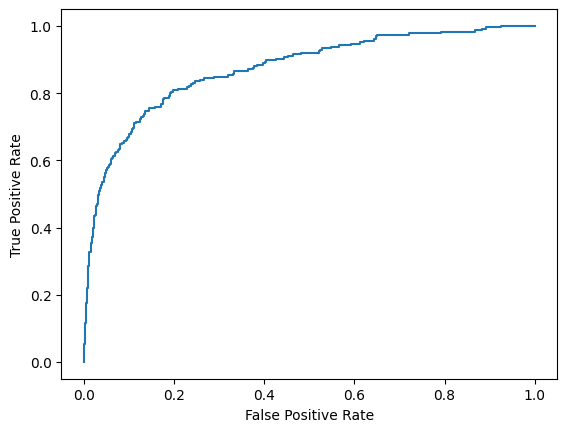

AUPRC score is  0.3557708261545487


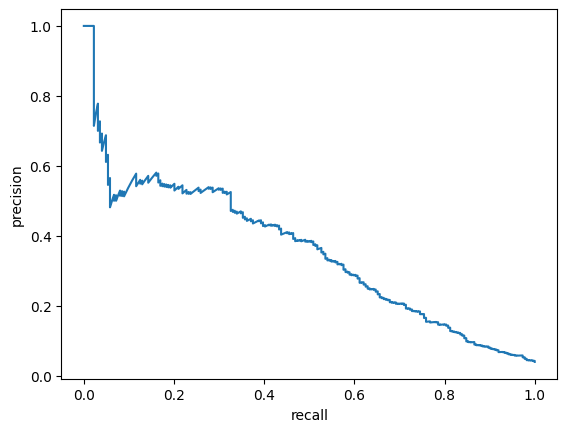

In [151]:
metrics_of_methodes["XGBoost"] = calculate_metrics(y_test, y_pred[:,1], is_prob=True, threshold=0.2)

PCA 3D: 


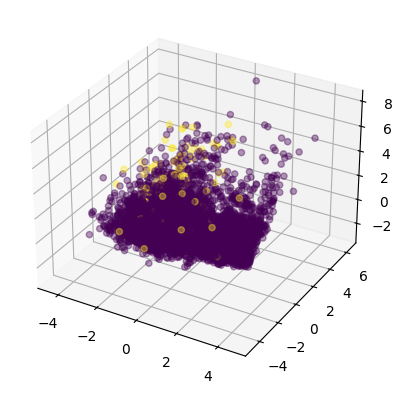


PCA 2D: 


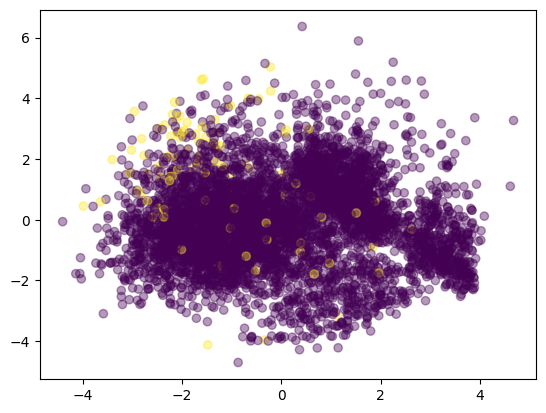


t-SNE 3D: 


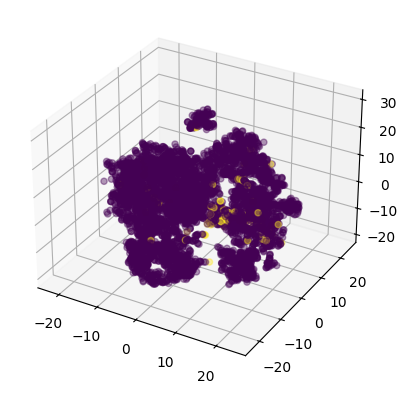


t-SNE 2D: 


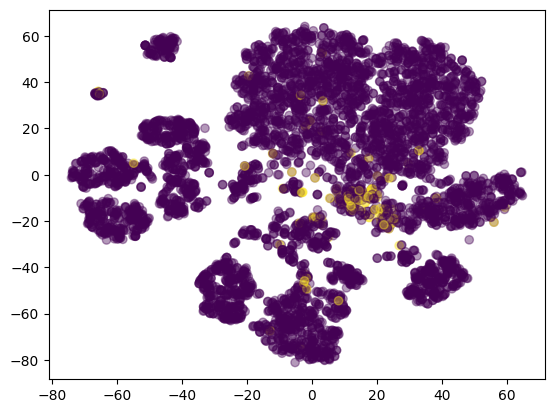

In [184]:
y_pred = np.where(y_pred[:,1]>0.5, 1, 0)
do_visualize(y_pred, True)

In [185]:
xgb = XGBClassifier(n_estimators = 200)
xgb.fit(reducted_data[:, :5], y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=200, n_jobs=None,
              num_parallel_tree=None, random_state=None, ...)

precision_score: 0.651404422979156
recall_score: 0.5390174641022953
f1_score: 0.5569286746490504
accuracy_score: 0.9573643410852714

              precision    recall  f1-score   support

           0       0.96      0.99      0.98      5452
           1       0.34      0.08      0.14       224

    accuracy                           0.96      5676
   macro avg       0.65      0.54      0.56      5676
weighted avg       0.94      0.96      0.94      5676




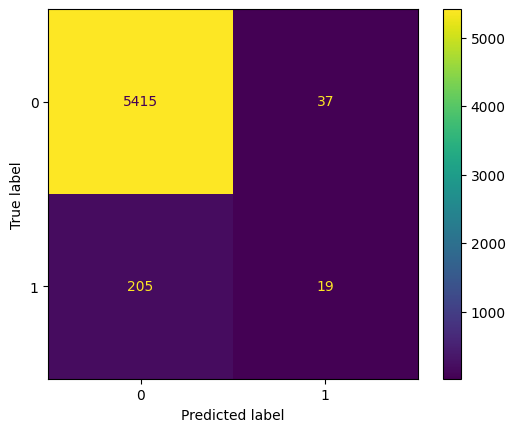

AUC score is  0.7701375969500053


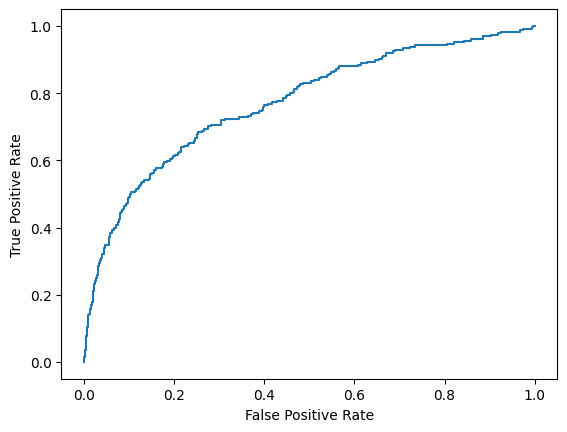

AUPRC score is  0.17020416202764005


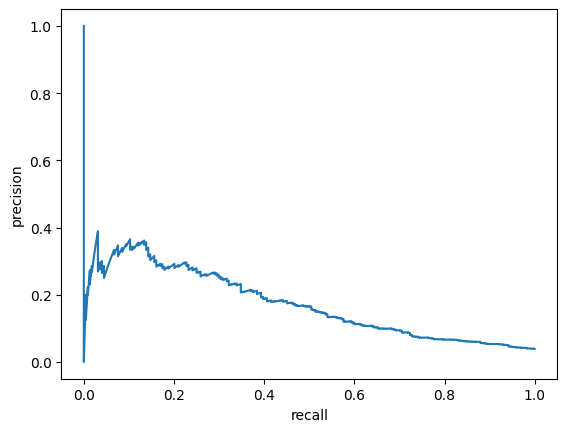

[0.651404422979156,
 0.5390174641022953,
 0.5569286746490504,
 0.9573643410852714,
 0.7701375969500053,
 0.17020416202764005]

In [186]:
y_pred = xgb.predict_proba(reducted_test[:, :5])
calculate_metrics(y_test, y_pred[:,1], is_prob=True)

##### Balance Bagging (Self Implementation)

In [153]:
def balance_bag (X, y, rate = 1):
    y_np = np.array(y)
    X_np = np.array(X)
    minor_label = np.copy(y_np[y_np == 1])
    minor_data = np.copy(X_np[y_np == 1])
    major_label = np.copy(y_np[y_np == 0])
    major_data = np.copy(X_np[y_np == 0])

    idx = np.random.permutation(major_data.shape[0])
    major_data, major_label = major_data[idx], major_label[idx]

    window = minor_data.shape[0] * rate

    list_bag = []
    itr = 0
    while (itr + window < major_data.shape[0]):
        sub = np.copy(major_data[itr: itr+window])
        sub = np.vstack((sub, minor_data))
        sub_label = np.copy(major_label[itr: itr+window])
        sub_label = np.hstack((sub_label, minor_label))

        idx = np.random.permutation(sub.shape[0])
        sub, sub_label = sub[idx], sub_label[idx]

        list_bag.append((sub, sub_label))
        itr += window

    return(list_bag)
    

In [154]:
bag_of_sub_data = balance_bag(X_train_normal, y_train)

In [155]:
list_of_models = []
for data in bag_of_sub_data:
    b_model, _ = train_base_model(data[0], data[1], 17)
    list_of_models.append(b_model)

Epoch 1/10
51/51 [==============================] - 3s 10ms/step - loss: 0.7188 - accuracy: 0.7435 - val_loss: 0.5984 - val_accuracy: 0.7778
Epoch 2/10
51/51 [==============================] - 0s 6ms/step - loss: 0.4858 - accuracy: 0.7720 - val_loss: 0.5039 - val_accuracy: 0.8000
Epoch 3/10
51/51 [==============================] - 0s 6ms/step - loss: 0.4733 - accuracy: 0.7850 - val_loss: 0.4758 - val_accuracy: 0.8111
Epoch 4/10
51/51 [==============================] - 0s 5ms/step - loss: 0.4567 - accuracy: 0.7986 - val_loss: 0.4506 - val_accuracy: 0.8167
Epoch 5/10
51/51 [==============================] - 0s 6ms/step - loss: 0.4393 - accuracy: 0.8061 - val_loss: 0.4713 - val_accuracy: 0.8389
Epoch 6/10
51/51 [==============================] - 0s 5ms/step - loss: 0.4531 - accuracy: 0.7980 - val_loss: 0.4757 - val_accuracy: 0.8500
Epoch 7/10
51/51 [==============================] - 0s 5ms/step - loss: 0.4601 - accuracy: 0.7943 - val_loss: 0.4213 - val_accuracy: 0.8333
Epoch 8/10
51/51 [=

In [156]:
flag = True
for model in list_of_models:
    if flag:
        pred_sum = np.copy(model.predict(X_test_normal)) 
        flag = False
    else:
        pred_sum += model.predict(X_test_normal)

178/178 [==============================] - 1s 2ms/step


In [157]:
y_pred = pred_sum / len(list_of_models)


precision_score: 0.6930668496765369
recall_score: 0.6723057069489571
f1_score: 0.682004219368211
accuracy_score: 0.954369274136716

              precision    recall  f1-score   support

           0       0.97      0.98      0.98      5452
           1       0.41      0.37      0.39       224

    accuracy                           0.95      5676
   macro avg       0.69      0.67      0.68      5676
weighted avg       0.95      0.95      0.95      5676




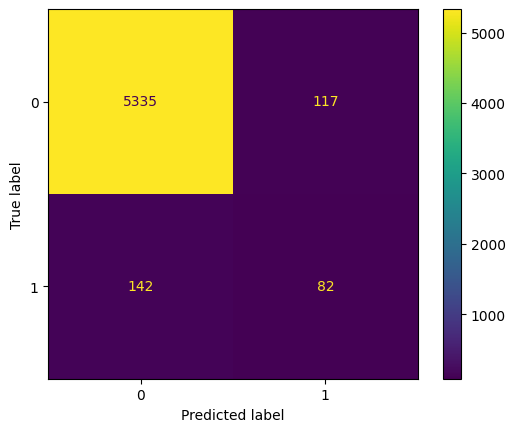

AUC score is  0.8548050846347344


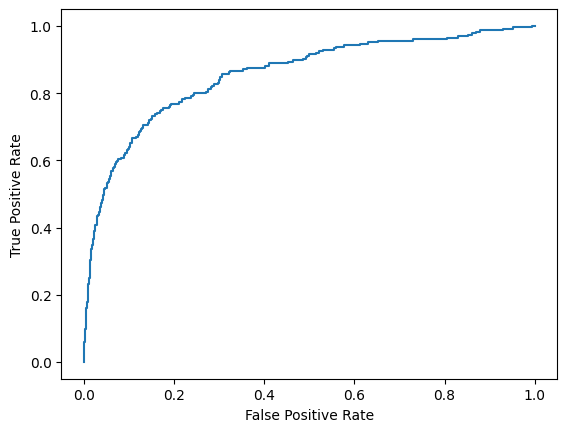

AUPRC score is  0.31390312299570905


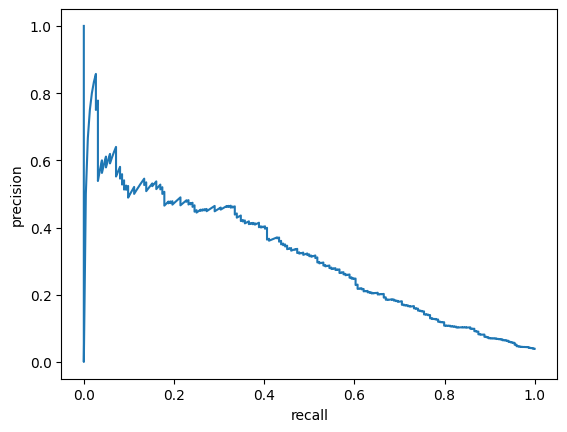

In [166]:
metrics_of_methodes["Self_Bagging"] = calculate_metrics(y_test, y_pred, is_prob=True, threshold=0.9)

PCA 3D: 


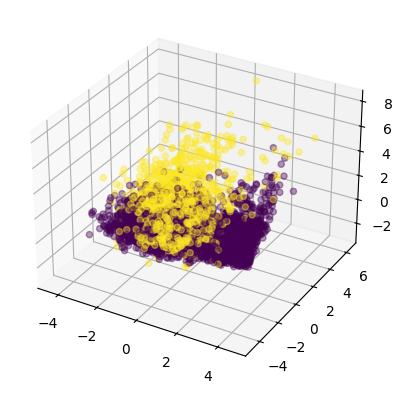


PCA 2D: 


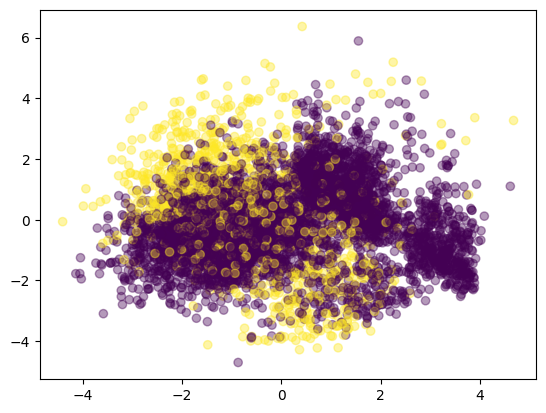


t-SNE 3D: 


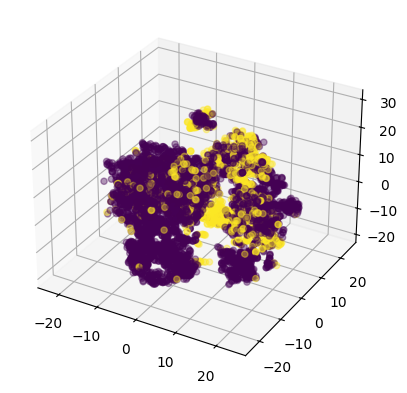


t-SNE 2D: 


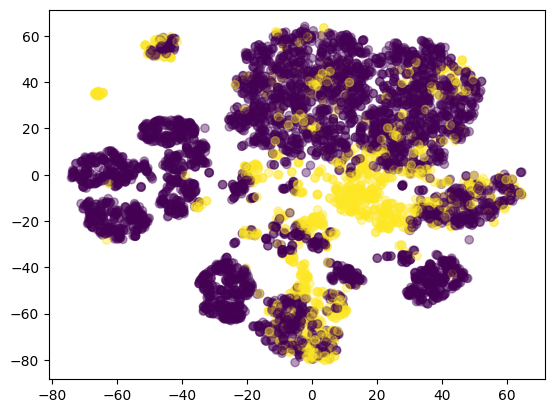

In [192]:
y_pred = np.where(y_pred>0.5, 1, 0)
do_visualize(y_pred, True)

##### Voting Classifier

In [193]:
from sklearn.ensemble import VotingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from xgboost import XGBClassifier

In [194]:
ens_model = VotingClassifier(
    estimators=[
        ('RF', RandomForestClassifier(max_depth=15, min_samples_split=2, n_estimators=300)),
        ('SVM', SVC(C=1000, gamma='scale', kernel='rbf')),
        ('XGB', XGBClassifier(max_depth=15, min_samples_split= 2, n_estimators=300))
    ],
)


In [195]:
ens_model.fit(X_train_normal, y_train)

VotingClassifier(estimators=[('RF',
                              RandomForestClassifier(max_depth=15,
                                                     n_estimators=300)),
                             ('SVM', SVC(C=1000)),
                             ('XGB',
                              XGBClassifier(base_score=None, booster=None,
                                            callbacks=None,
                                            colsample_bylevel=None,
                                            colsample_bynode=None,
                                            colsample_bytree=None, device=None,
                                            early_stopping_rounds=None,
                                            enable_categorical=False,
                                            eval_metric=None,
                                            feature_types=None, gamma=None,
                                            grow_policy=None,
                                            importance_type=None,
                                            interaction_constraints=None,
                                            learning_rate=None, max_bin=None,
                                            max_cat_threshold=None,
                                            max_cat_to_onehot=None,
                                            max_delta_step=None, max_depth=15,
                                            max_leaves=None,
                                            min_child_weight=None,
                                            min_samples_split=2, missing=nan,
                                            monotone_constraints=None,
                                            multi_strategy=None,
                                            n_estimators=300, n_jobs=None,
                                            num_parallel_tree=None, ...))])

precision_score: 0.7637529012676307
recall_score: 0.590723587674248
f1_score: 0.6307423611441013
accuracy_score: 0.9621212121212122

              precision    recall  f1-score   support

           0       0.97      0.99      0.98      5452
           1       0.56      0.19      0.28       224

    accuracy                           0.96      5676
   macro avg       0.76      0.59      0.63      5676
weighted avg       0.95      0.96      0.95      5676




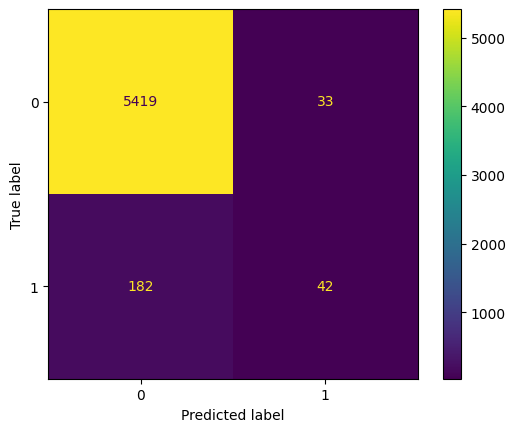

[0.7637529012676307, 0.590723587674248, 0.6307423611441013, 0.9621212121212122]

In [196]:
y_pred = ens_model.predict(X_test_normal)
calculate_metrics(y_test, y_pred)

PCA 3D: 


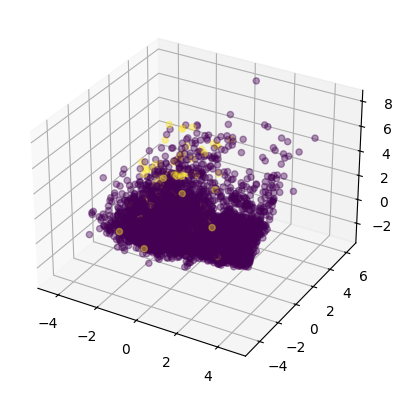


PCA 2D: 


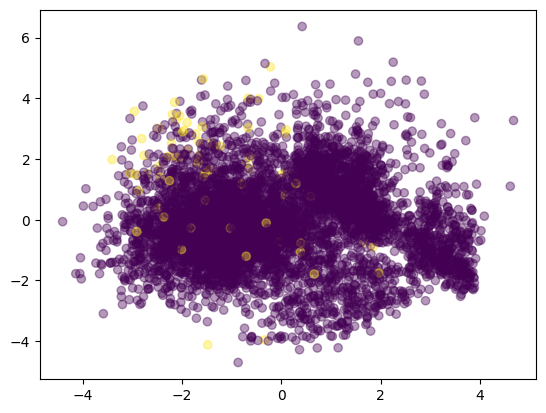


t-SNE 3D: 


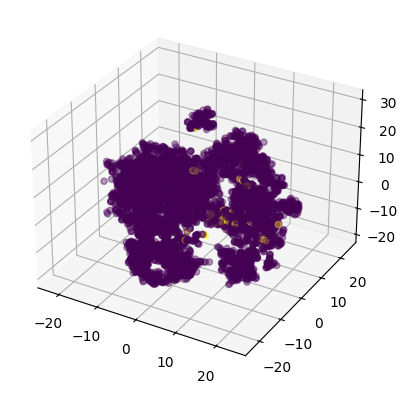


t-SNE 2D: 


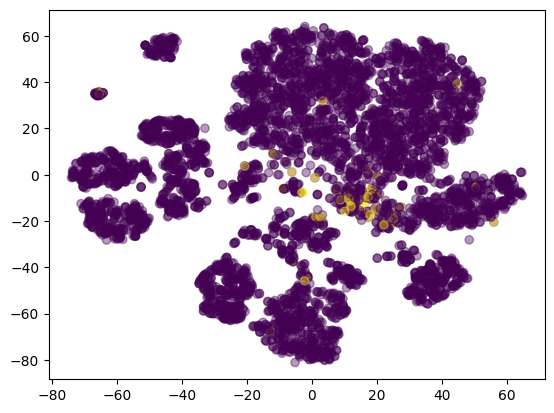

In [197]:
do_visualize(y_pred, True)

In [198]:
ens_model = VotingClassifier(
    estimators=[
        ('RF', RandomForestClassifier(max_depth=15, min_samples_split=2, n_estimators=300)),
        ('SVM', SVC(C=1000, gamma='scale', kernel='rbf')),
        ('XGB', XGBClassifier(max_depth=15, min_samples_split= 2, n_estimators=300))
    ],
)

In [199]:
ens_model.fit(reducted_data[:, :5], y_train)

VotingClassifier(estimators=[('RF',
                              RandomForestClassifier(max_depth=15,
                                                     n_estimators=300)),
                             ('SVM', SVC(C=1000)),
                             ('XGB',
                              XGBClassifier(base_score=None, booster=None,
                                            callbacks=None,
                                            colsample_bylevel=None,
                                            colsample_bynode=None,
                                            colsample_bytree=None, device=None,
                                            early_stopping_rounds=None,
                                            enable_categorical=False,
                                            eval_metric=None,
                                            feature_types=None, gamma=None,
                                            grow_policy=None,
                                            importance_type=None,
                                            interaction_constraints=None,
                                            learning_rate=None, max_bin=None,
                                            max_cat_threshold=None,
                                            max_cat_to_onehot=None,
                                            max_delta_step=None, max_depth=15,
                                            max_leaves=None,
                                            min_child_weight=None,
                                            min_samples_split=2, missing=nan,
                                            monotone_constraints=None,
                                            multi_strategy=None,
                                            n_estimators=300, n_jobs=None,
                                            num_parallel_tree=None, ...))])

precision_score: 0.7120081688223281
recall_score: 0.5255017817838801
f1_score: 0.53782165375608
accuracy_score: 0.9601832276250881

              precision    recall  f1-score   support

           0       0.96      1.00      0.98      5452
           1       0.46      0.05      0.10       224

    accuracy                           0.96      5676
   macro avg       0.71      0.53      0.54      5676
weighted avg       0.94      0.96      0.94      5676




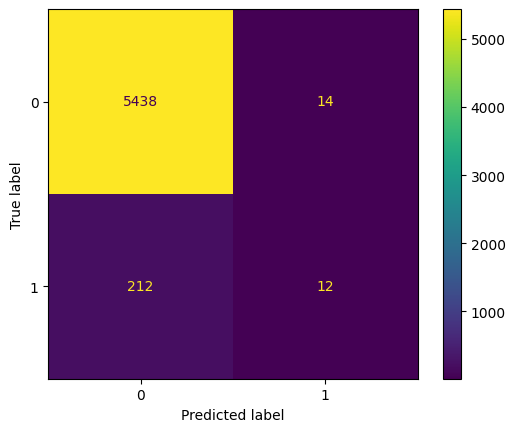

[0.7120081688223281, 0.5255017817838801, 0.53782165375608, 0.9601832276250881]

In [200]:
y_pred = ens_model.predict(reducted_test[:, :5])
calculate_metrics(y_test, y_pred)

### Data Level

#### UnderSampling

##### Near Miss

In [168]:
from imblearn.under_sampling import NearMiss
from collections import Counter

In [169]:
counter = Counter(y_train)
counter

Counter({0: 21804, 1: 897})

In [170]:
undersample = NearMiss(version=1)
X_NM, y_NM = undersample.fit_resample(X_train_normal, y_train)
counter = Counter(y_NM)
counter

Counter({0: 897, 1: 897})

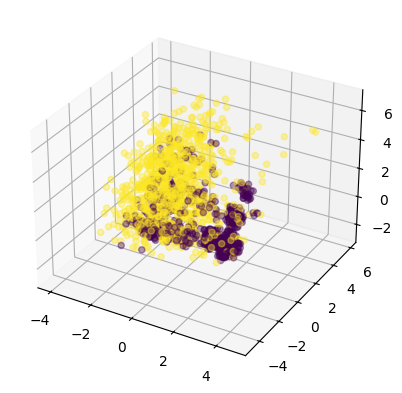

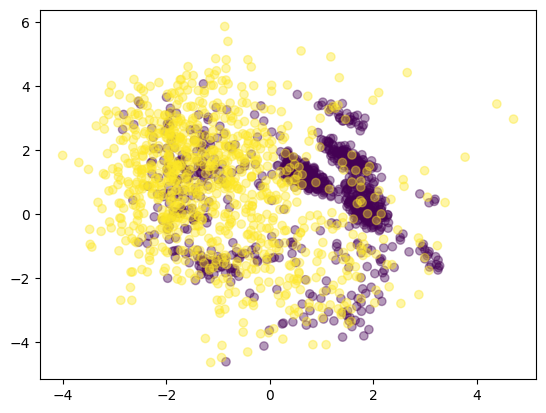

In [171]:
temp = pca.transform(X_NM)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(temp[:,0], temp[:,1], temp[:,2], c=y_NM, cmap="viridis", alpha=0.4)
plt.show()

fig = plt.figure()
ax = fig.add_subplot()
ax.scatter(temp[:,0], temp[:,1], c=y_NM, cmap="viridis", alpha=0.4)
plt.show()

In [172]:
b_model, y_pred, _ = train_base_model(X_NM, y_NM, 17, X_test_normal)

Epoch 1/10


51/51 [==============================] - 3s 10ms/step - loss: 0.6749 - accuracy: 0.7633 - val_loss: 0.6549 - val_accuracy: 0.7000
Epoch 2/10
51/51 [==============================] - 0s 6ms/step - loss: 0.3867 - accuracy: 0.8290 - val_loss: 0.4294 - val_accuracy: 0.8278
Epoch 3/10
51/51 [==============================] - 0s 5ms/step - loss: 0.3763 - accuracy: 0.8309 - val_loss: 0.4973 - val_accuracy: 0.7556
Epoch 4/10
51/51 [==============================] - 0s 6ms/step - loss: 0.3552 - accuracy: 0.8389 - val_loss: 0.4982 - val_accuracy: 0.7444
Epoch 5/10
51/51 [==============================] - 0s 6ms/step - loss: 0.3605 - accuracy: 0.8439 - val_loss: 0.3529 - val_accuracy: 0.8500
Epoch 6/10
51/51 [==============================] - 0s 6ms/step - loss: 0.3605 - accuracy: 0.8377 - val_loss: 0.3904 - val_accuracy: 0.8444
Epoch 7/10
51/51 [==============================] - 0s 6ms/step - loss: 0.3517 - accuracy: 0.8457 - val_loss: 0.6683 - val_accuracy: 0.6444
Epoch 8/10
51/51 [============

precision_score: 0.5345952476842529
recall_score: 0.5998797950948538
f1_score: 0.5380059960462106
accuracy_score: 0.8604651162790697

              precision    recall  f1-score   support

           0       0.97      0.88      0.92      5452
           1       0.10      0.32      0.15       224

    accuracy                           0.86      5676
   macro avg       0.53      0.60      0.54      5676
weighted avg       0.93      0.86      0.89      5676




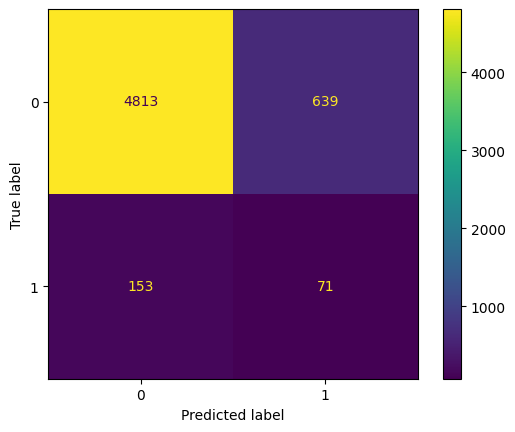

AUC score is  0.73796436104706


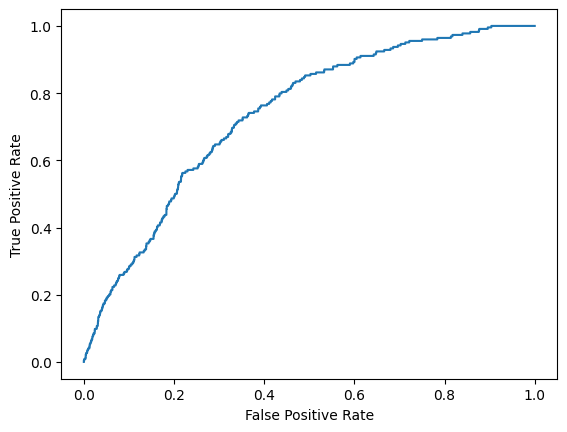

AUPRC score is  0.09754659982369103


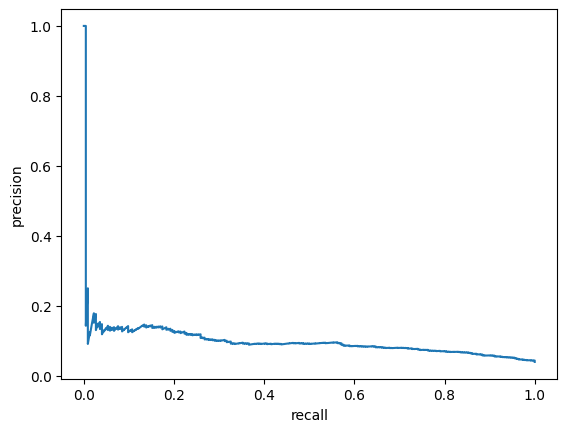

In [182]:
metrics_of_methodes["Near_Miss"] = calculate_metrics(y_test, y_pred, is_prob=True, threshold=0.9)

PCA 3D: 


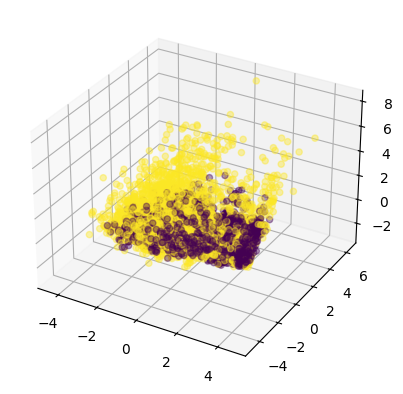


PCA 2D: 


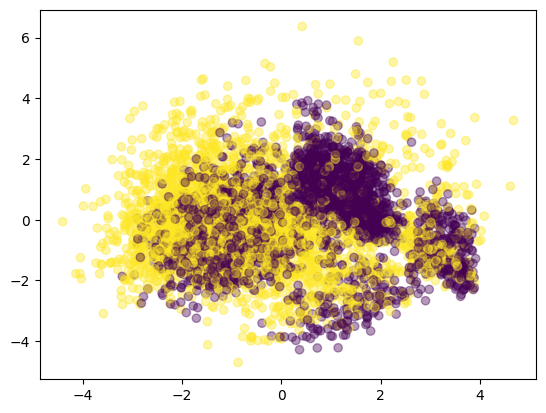


t-SNE 3D: 


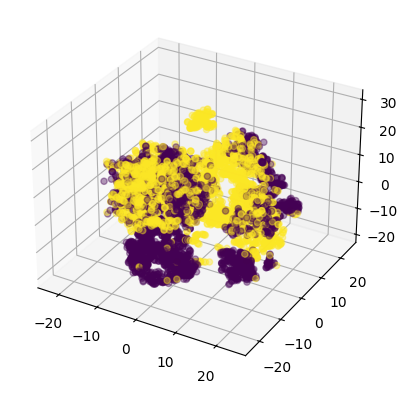


t-SNE 2D: 


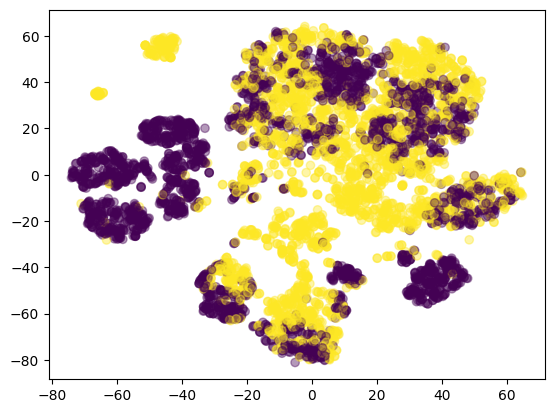

In [206]:
y_pred = np.where(y_pred>0.5, 1, 0)
do_visualize(y_pred, True)

In [207]:
undersample = NearMiss(version=2)
X_NM, y_NM = undersample.fit_resample(X_train_normal, y_train)
counter = Counter(y_NM)
counter

Counter({0: 897, 1: 897})

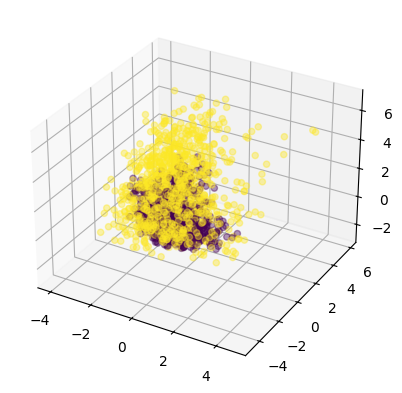

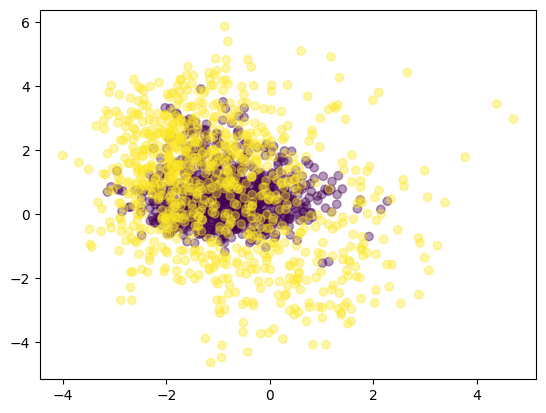

In [208]:
temp = pca.transform(X_NM)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(temp[:,0], temp[:,1], temp[:,2], c=y_NM, cmap="viridis", alpha=0.4)
plt.show()

fig = plt.figure()
ax = fig.add_subplot()
ax.scatter(temp[:,0], temp[:,1], c=y_NM, cmap="viridis", alpha=0.4)
plt.show()

Epoch 1/10
51/51 [==============================] - 3s 13ms/step - loss: 0.4721 - accuracy: 0.8451 - val_loss: 1.2832 - val_accuracy: 0.7000
Epoch 2/10
51/51 [==============================] - 1s 10ms/step - loss: 0.2683 - accuracy: 0.8879 - val_loss: 1.0290 - val_accuracy: 0.5611
Epoch 3/10
51/51 [==============================] - 1s 10ms/step - loss: 0.2554 - accuracy: 0.8984 - val_loss: 0.7976 - val_accuracy: 0.6722
Epoch 4/10
51/51 [==============================] - 1s 10ms/step - loss: 0.2698 - accuracy: 0.8879 - val_loss: 0.4382 - val_accuracy: 0.7833
Epoch 5/10
51/51 [==============================] - 0s 10ms/step - loss: 0.2507 - accuracy: 0.8965 - val_loss: 0.2928 - val_accuracy: 0.8722
Epoch 6/10
51/51 [==============================] - 0s 9ms/step - loss: 0.2440 - accuracy: 0.9040 - val_loss: 0.3030 - val_accuracy: 0.8667
Epoch 7/10
51/51 [==============================] - 0s 10ms/step - loss: 0.2316 - accuracy: 0.9071 - val_loss: 0.3524 - val_accuracy: 0.8056
Epoch 8/10
51/

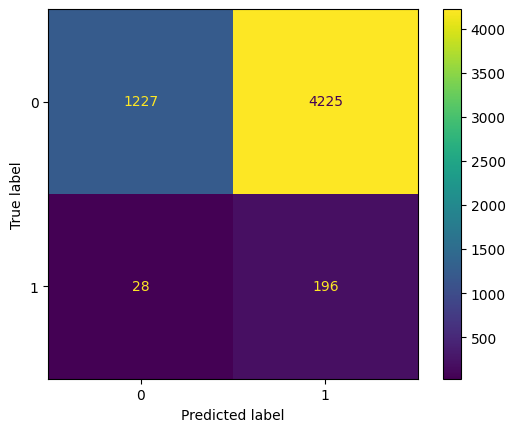

AUC score is  0.5777536585525627


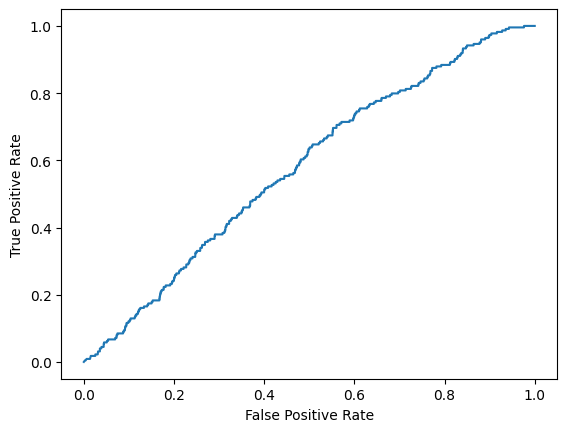

AUPRC score is  0.048954674537011425


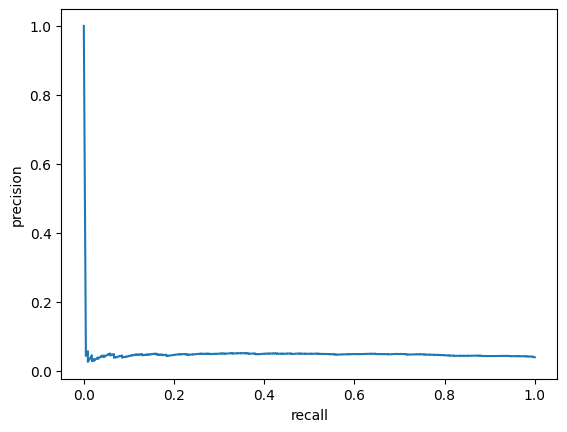

[0.5110115520726414,
 0.550027512839325,
 0.2251391032584404,
 0.2507047216349542,
 0.5777536585525627,
 0.048954674537011425]

In [209]:
b_model, y_pred, _ = train_base_model(X_NM, y_NM, 17, X_test_normal)
calculate_metrics(y_test, y_pred, is_prob=True)

PCA 3D: 


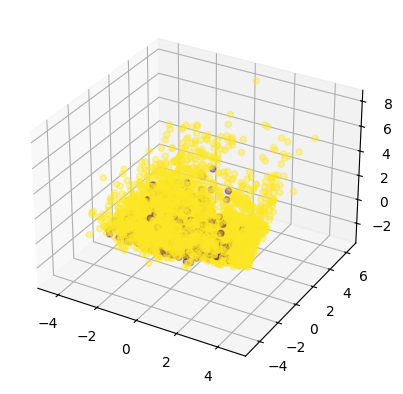


PCA 2D: 


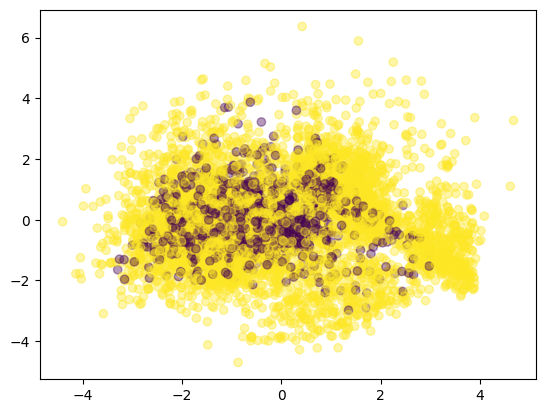


t-SNE 3D: 


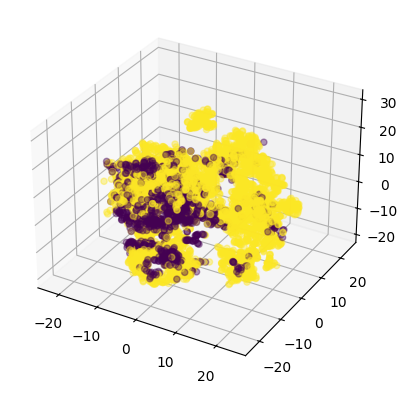


t-SNE 2D: 


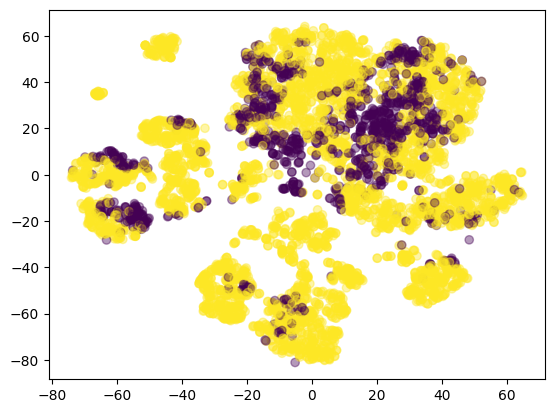

In [210]:
y_pred = np.where(y_pred>0.5, 1, 0)
do_visualize(y_pred, True)

In [211]:
undersample = NearMiss(version=3)
X_NM, y_NM = undersample.fit_resample(X_train_normal, y_train)
counter = Counter(y_NM)
counter

Counter({0: 897, 1: 897})

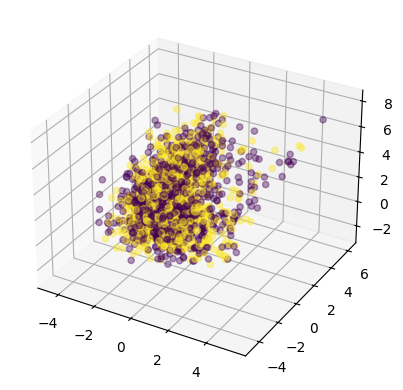

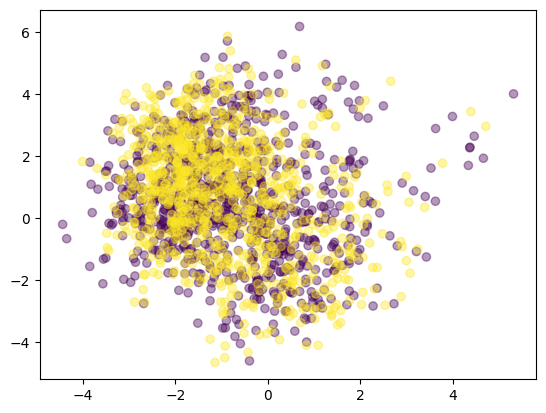

In [212]:
temp = pca.transform(X_NM)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(temp[:,0], temp[:,1], temp[:,2], c=y_NM, cmap="viridis", alpha=0.4)
plt.show()

fig = plt.figure()
ax = fig.add_subplot()
ax.scatter(temp[:,0], temp[:,1], c=y_NM, cmap="viridis", alpha=0.4)
plt.show()

Epoch 1/10
51/51 [==============================] - 3s 13ms/step - loss: 0.9691 - accuracy: 0.5508 - val_loss: 0.6027 - val_accuracy: 0.6444
Epoch 2/10
51/51 [==============================] - 1s 10ms/step - loss: 0.6972 - accuracy: 0.5911 - val_loss: 0.7312 - val_accuracy: 0.6278
Epoch 3/10
51/51 [==============================] - 0s 10ms/step - loss: 0.6911 - accuracy: 0.5886 - val_loss: 0.7331 - val_accuracy: 0.5389
Epoch 4/10
51/51 [==============================] - 0s 9ms/step - loss: 0.7099 - accuracy: 0.5861 - val_loss: 0.7024 - val_accuracy: 0.6167
Epoch 5/10
51/51 [==============================] - 1s 10ms/step - loss: 0.6665 - accuracy: 0.6053 - val_loss: 0.6291 - val_accuracy: 0.6500
Epoch 6/10
51/51 [==============================] - 0s 10ms/step - loss: 0.6511 - accuracy: 0.6171 - val_loss: 0.8053 - val_accuracy: 0.5444
Epoch 7/10
51/51 [==============================] - 0s 9ms/step - loss: 0.6448 - accuracy: 0.6208 - val_loss: 0.8231 - val_accuracy: 0.4889
Epoch 8/10
51/5

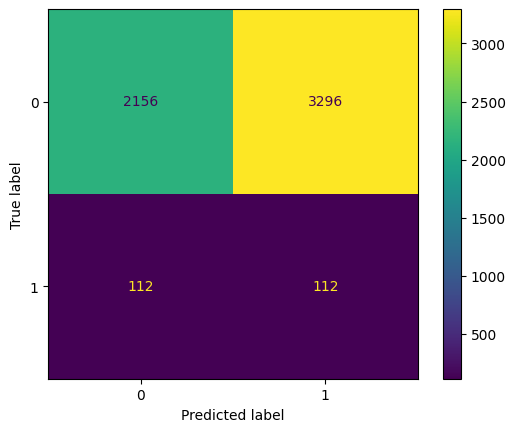

AUC score is  0.4124117296404989


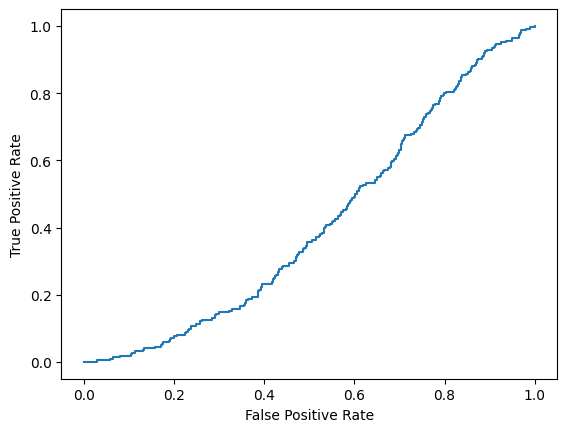

AUPRC score is  0.030154340377354677


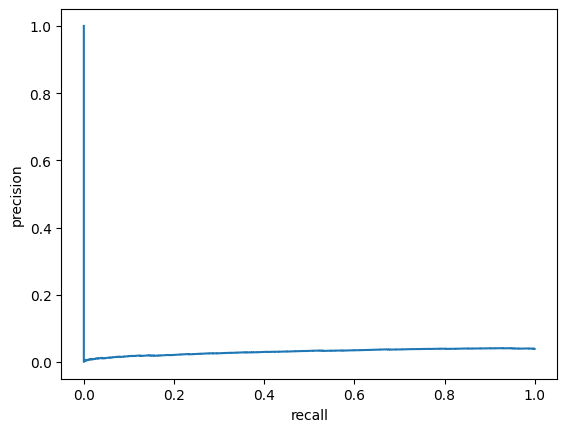

[0.49174056685793777,
 0.4477256052824652,
 0.3101116158042501,
 0.39957716701902746,
 0.4124117296404989,
 0.030154340377354677]

In [213]:
b_model, y_pred, _ = train_base_model(X_NM, y_NM, 17, X_test_normal)
calculate_metrics(y_test, y_pred, is_prob=True)

PCA 3D: 


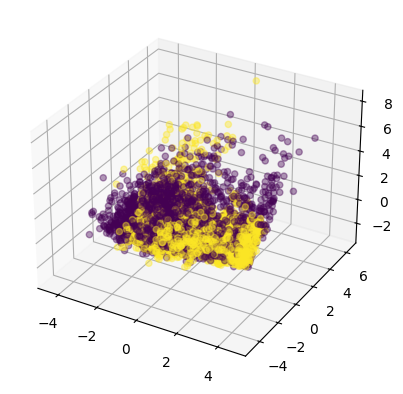


PCA 2D: 


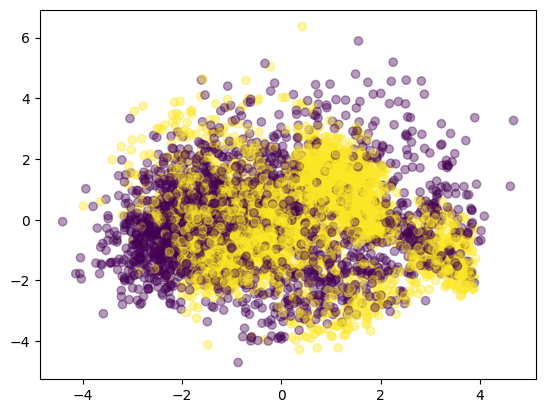


t-SNE 3D: 


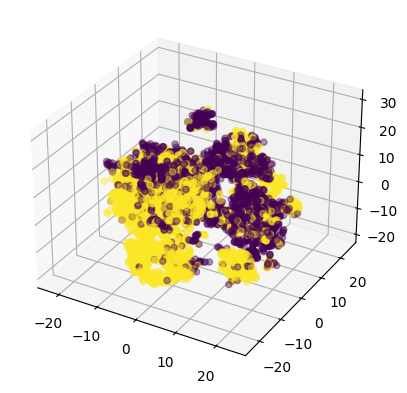


t-SNE 2D: 


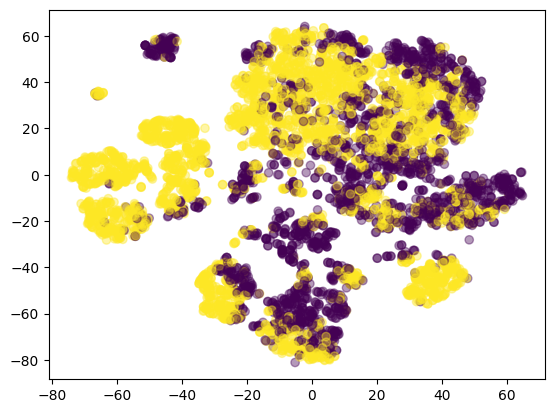

In [214]:
y_pred = np.where(y_pred>0.5, 1, 0)
do_visualize(y_pred, True)

##### Condensed Nearest Neighbor

In [215]:
from imblearn.under_sampling import CondensedNearestNeighbour
from collections import Counter

In [216]:
# counter = Counter(y_train)
# counter

In [217]:
# undersample = CondensedNearestNeighbour(n_neighbors=1)
# X_CNN, y_CNN = undersample.fit_resample(X_train_normal, y_train)
# counter = Counter(y_CNN)
# counter

In [218]:
# b_model, y_pred, _ = train_base_model(X_NM, y_NM, X_test_normal)
# calculate_metrics(y_test, y_pred, is_prob=True)

##### Edited Nearest Neighbors

In [183]:
from imblearn.under_sampling import EditedNearestNeighbours
from collections import Counter

In [184]:
counter = Counter(y_train)
counter

Counter({0: 21804, 1: 897})

In [185]:
undersample = EditedNearestNeighbours()
X_ENN, y_ENN = undersample.fit_resample(X_train_normal, y_train)
counter = Counter(y_ENN)
counter

Counter({0: 20414, 1: 897})

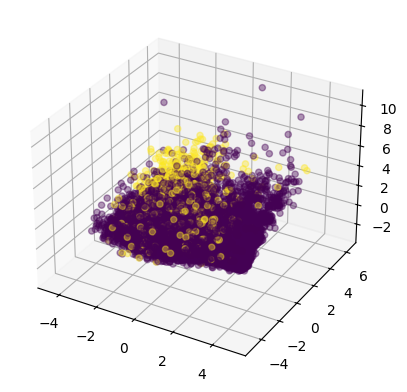

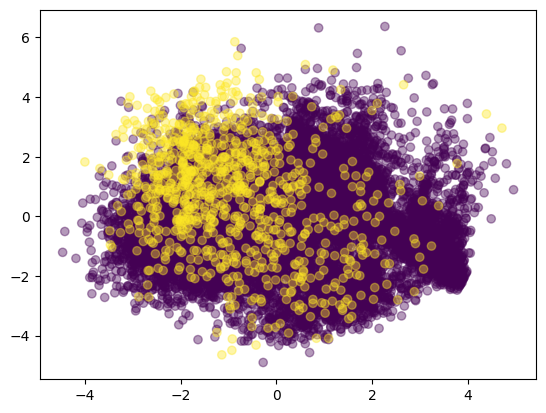

In [186]:
temp = pca.transform(X_ENN)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(temp[:,0], temp[:,1], temp[:,2], c=y_ENN, cmap="viridis", alpha=0.4)
plt.show()

fig = plt.figure()
ax = fig.add_subplot()
ax.scatter(temp[:,0], temp[:,1], c=y_ENN, cmap="viridis", alpha=0.4)
plt.show()

In [191]:
b_model, y_pred, _ = train_base_model(X_ENN, y_ENN, 17, X_test_normal)

Epoch 1/10
600/600 [==============================] - 5s 5ms/step - loss: 0.0318 - accuracy: 0.9937 - val_loss: 3.7988 - val_accuracy: 0.5793
Epoch 2/10
600/600 [==============================] - 3s 5ms/step - loss: 6.5456e-05 - accuracy: 1.0000 - val_loss: 4.3303 - val_accuracy: 0.5793
Epoch 3/10
600/600 [==============================] - 3s 5ms/step - loss: 2.3416e-05 - accuracy: 1.0000 - val_loss: 4.6659 - val_accuracy: 0.5793
Epoch 4/10
600/600 [==============================] - 3s 5ms/step - loss: 1.1581e-05 - accuracy: 1.0000 - val_loss: 4.9193 - val_accuracy: 0.5793
Epoch 5/10
600/600 [==============================] - 3s 5ms/step - loss: 6.5977e-06 - accuracy: 1.0000 - val_loss: 5.1322 - val_accuracy: 0.5793
Epoch 6/10
600/600 [==============================] - 3s 5ms/step - loss: 4.0682e-06 - accuracy: 1.0000 - val_loss: 5.3330 - val_accuracy: 0.5793
Epoch 7/10
600/600 [==============================] - 3s 5ms/step - loss: 2.6330e-06 - accuracy: 1.0000 - val_loss: 5.5066 - val

precision_score: 0.4802677942212826
recall_score: 0.5
f1_score: 0.48993529834651334
accuracy_score: 0.9605355884425651

              precision    recall  f1-score   support

           0       0.96      1.00      0.98      5452
           1       0.00      0.00      0.00       224

    accuracy                           0.96      5676
   macro avg       0.48      0.50      0.49      5676
weighted avg       0.92      0.96      0.94      5676




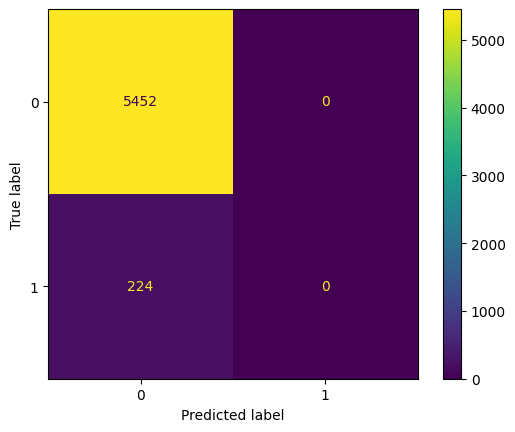

AUC score is  0.5036704256629284


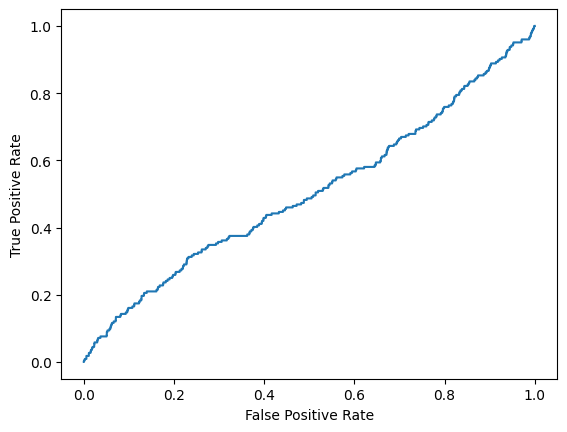

AUPRC score is  0.04718630372520758


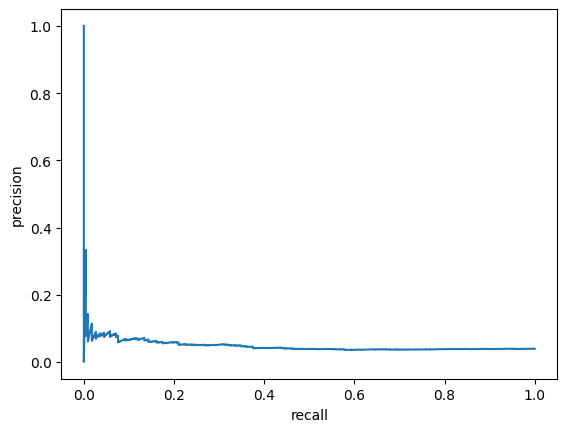

In [194]:
metrics_of_methodes["Edited_Nearest_Neighbors"] = calculate_metrics(y_test, y_pred, is_prob=True, threshold=0.01)

PCA 3D: 


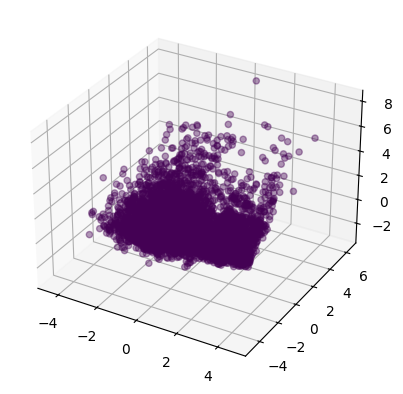


PCA 2D: 


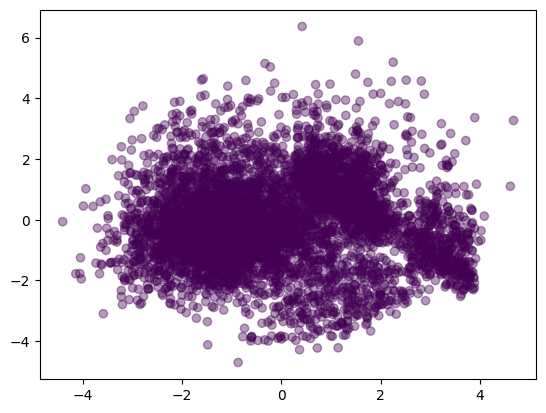


t-SNE 3D: 


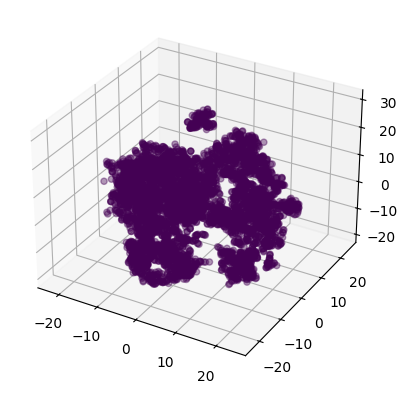


t-SNE 2D: 


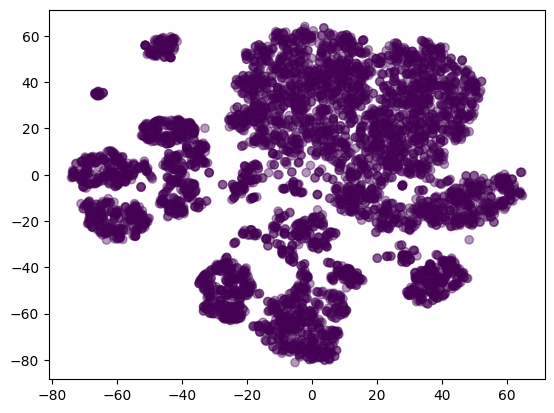

In [224]:
y_pred = np.where(y_pred > .5, 1, 0)
do_visualize(y_pred, True)

##### Tomek Links

In [195]:
from imblearn.under_sampling import TomekLinks
from collections import Counter

In [196]:
counter = Counter(y_train)
counter

Counter({0: 21804, 1: 897})

In [197]:
undersample = TomekLinks()
X_TL, y_TL = undersample.fit_resample(X_train_normal, y_train)
counter = Counter(y_TL)
counter

Counter({0: 21533, 1: 897})

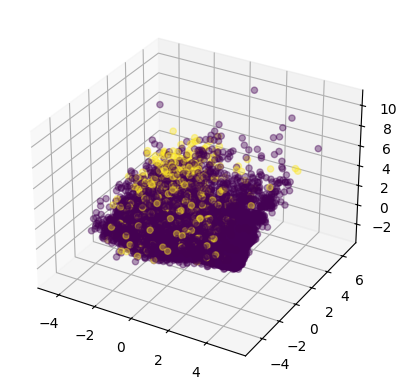

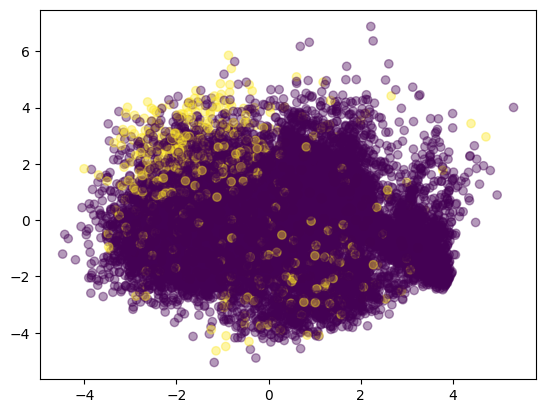

In [198]:
temp = pca.transform(X_TL)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(temp[:,0], temp[:,1], temp[:,2], c=y_TL, cmap="viridis", alpha=0.4)
plt.show()

fig = plt.figure()
ax = fig.add_subplot()
ax.scatter(temp[:,0], temp[:,1], c=y_TL, cmap="viridis", alpha=0.4)
plt.show()

In [200]:
b_model, y_pred, _ = train_base_model(X_TL, y_TL, 17, X_test_normal)

Epoch 1/10
631/631 [==============================] - 5s 5ms/step - loss: 0.1644 - accuracy: 0.9529 - val_loss: 0.1253 - val_accuracy: 0.9608
Epoch 2/10
631/631 [==============================] - 3s 5ms/step - loss: 0.1318 - accuracy: 0.9596 - val_loss: 0.1208 - val_accuracy: 0.9559
Epoch 3/10
631/631 [==============================] - 3s 5ms/step - loss: 0.1294 - accuracy: 0.9596 - val_loss: 0.1112 - val_accuracy: 0.9621
Epoch 4/10
631/631 [==============================] - 3s 5ms/step - loss: 0.1277 - accuracy: 0.9597 - val_loss: 0.1212 - val_accuracy: 0.9532
Epoch 5/10
631/631 [==============================] - 3s 5ms/step - loss: 0.1260 - accuracy: 0.9590 - val_loss: 0.1134 - val_accuracy: 0.9608
Epoch 6/10
631/631 [==============================] - 3s 5ms/step - loss: 0.1228 - accuracy: 0.9598 - val_loss: 0.1095 - val_accuracy: 0.9576
Epoch 7/10
631/631 [==============================] - 3s 5ms/step - loss: 0.1221 - accuracy: 0.9594 - val_loss: 0.1062 - val_accuracy: 0.9617
Epoch 

precision_score: 0.7086899716768983
recall_score: 0.6862488208783146
f1_score: 0.6967376146098382
accuracy_score: 0.9564834390415786

              precision    recall  f1-score   support

           0       0.98      0.98      0.98      5452
           1       0.44      0.39      0.42       224

    accuracy                           0.96      5676
   macro avg       0.71      0.69      0.70      5676
weighted avg       0.95      0.96      0.96      5676




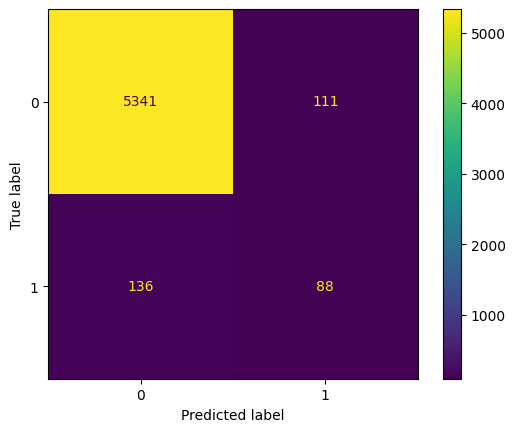

AUC score is  0.861937951996646


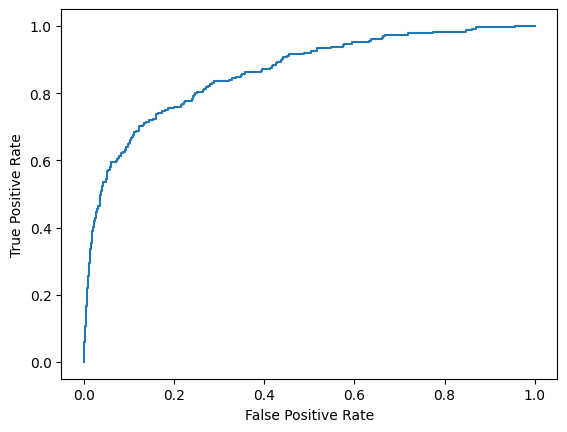

AUPRC score is  0.3308260569594449


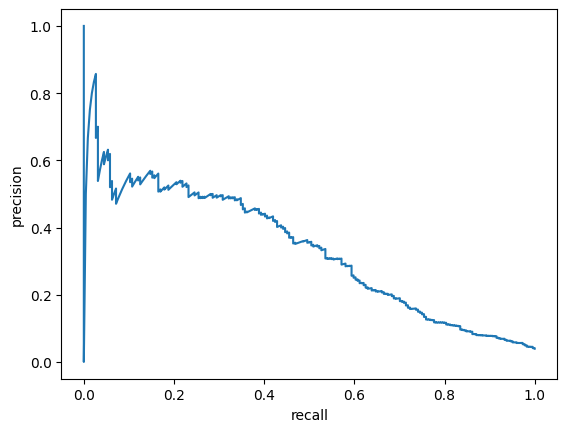

In [203]:
metrics_of_methodes["Tomek_Links"] = calculate_metrics(y_test, y_pred, is_prob=True, threshold=0.3)

PCA 3D: 


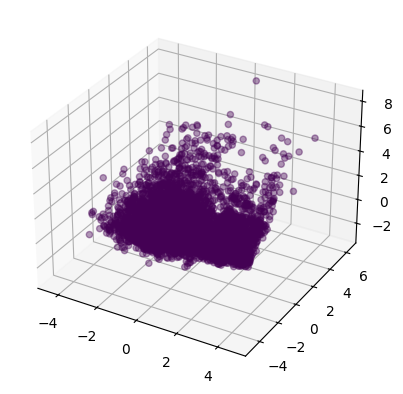


PCA 2D: 


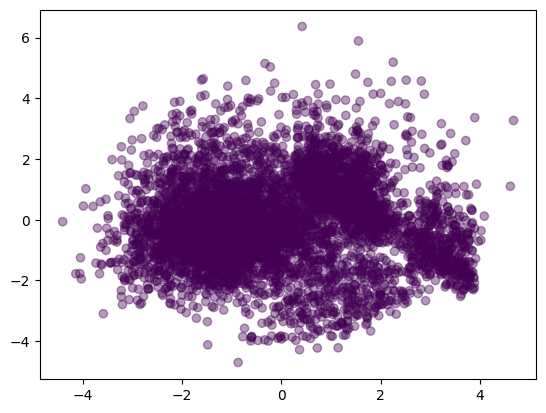


t-SNE 3D: 


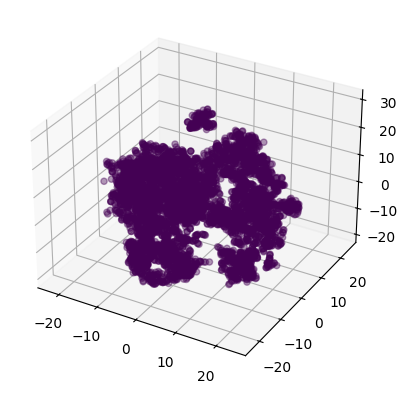


t-SNE 2D: 


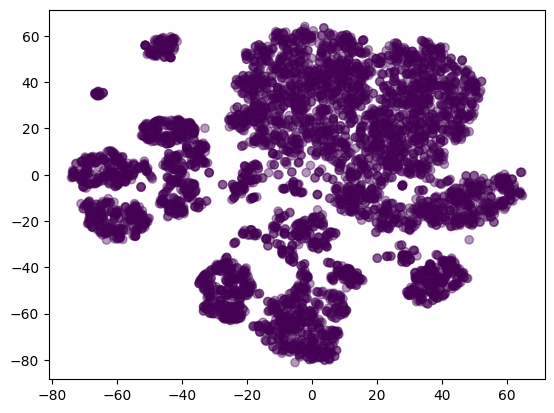

In [230]:
y_pred = np.where(y_pred > .5, 1, 0)
do_visualize(y_pred, True)

#### Oversampling

##### Synthetic Minority Oversampling Technique (SMOTE)

In [205]:
from imblearn.over_sampling  import SMOTE
from collections import Counter

In [206]:
counter = Counter(y_train)
counter

Counter({0: 21804, 1: 897})

In [207]:
oversample = SMOTE()
X_SMOTE, y_SMOTE = oversample.fit_resample(X_train_normal, y_train)
counter = Counter(y_SMOTE)
counter

Counter({0: 21804, 1: 21804})

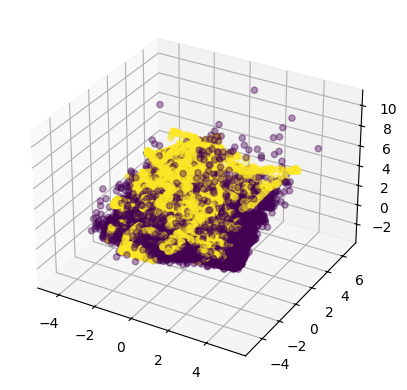

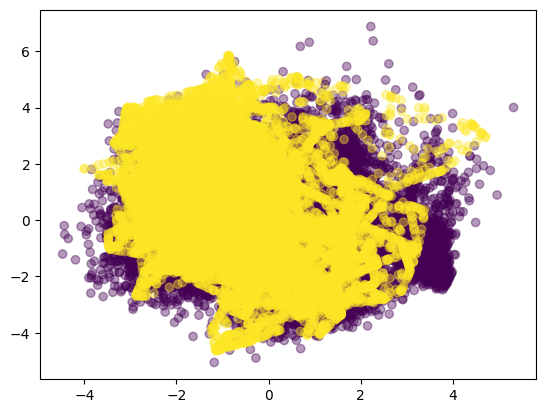

In [208]:
temp = pca.transform(X_SMOTE)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(temp[:,0], temp[:,1], temp[:,2], c=y_SMOTE, cmap="viridis", alpha=0.4)
plt.show()

fig = plt.figure()
ax = fig.add_subplot()
ax.scatter(temp[:,0], temp[:,1], c=y_SMOTE, cmap="viridis", alpha=0.4)
plt.show()

In [209]:
b_model, y_pred, _ = train_base_model(X_SMOTE, y_SMOTE, 17, X_test_normal)

Epoch 1/10
1227/1227 [==============================] - 9s 5ms/step - loss: 0.4436 - accuracy: 0.8091 - val_loss: 0.4078 - val_accuracy: 0.8354
Epoch 2/10
1227/1227 [==============================] - 5s 4ms/step - loss: 0.3676 - accuracy: 0.8431 - val_loss: 0.3253 - val_accuracy: 0.8649
Epoch 3/10
1227/1227 [==============================] - 6s 5ms/step - loss: 0.3237 - accuracy: 0.8646 - val_loss: 0.2103 - val_accuracy: 0.9291
Epoch 4/10
1227/1227 [==============================] - 6s 5ms/step - loss: 0.2816 - accuracy: 0.8847 - val_loss: 0.1943 - val_accuracy: 0.9459
Epoch 5/10
1227/1227 [==============================] - 6s 5ms/step - loss: 0.2524 - accuracy: 0.9001 - val_loss: 0.6757 - val_accuracy: 0.7058
Epoch 6/10
1227/1227 [==============================] - 6s 4ms/step - loss: 0.2262 - accuracy: 0.9110 - val_loss: 0.1772 - val_accuracy: 0.9459
Epoch 7/10
1227/1227 [==============================] - 6s 5ms/step - loss: 0.2082 - accuracy: 0.9186 - val_loss: 0.1659 - val_accuracy:

precision_score: 0.6113415868796696
recall_score: 0.6603834765747825
f1_score: 0.6302711707115068
accuracy_score: 0.9314658210007047

              precision    recall  f1-score   support

           0       0.97      0.95      0.96      5452
           1       0.25      0.37      0.30       224

    accuracy                           0.93      5676
   macro avg       0.61      0.66      0.63      5676
weighted avg       0.94      0.93      0.94      5676




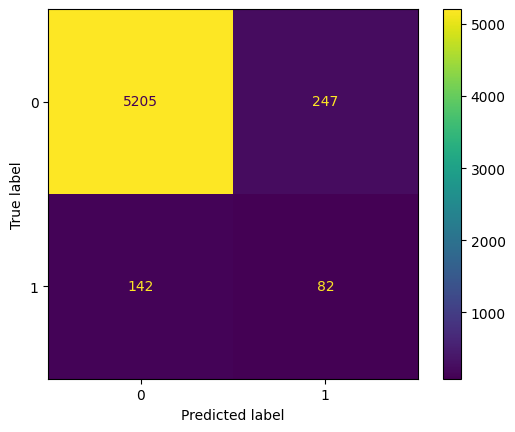

AUC score is  0.7907050820144639


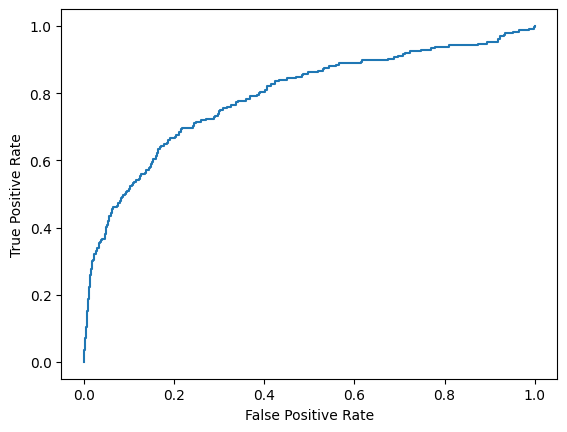

AUPRC score is  0.236580708092772


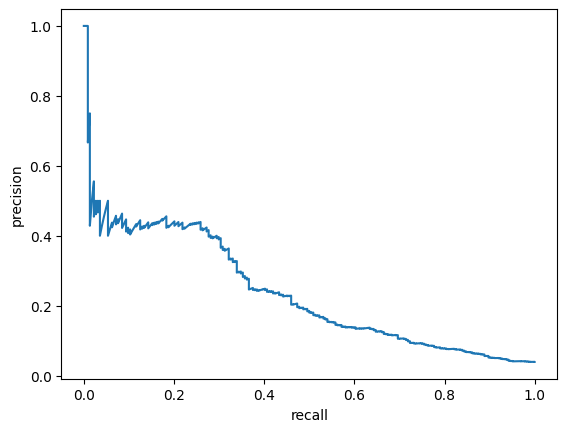

In [212]:
metrics_of_methodes["SMOTE"] = calculate_metrics(y_test, y_pred, is_prob=True, threshold=0.85)

PCA 3D: 


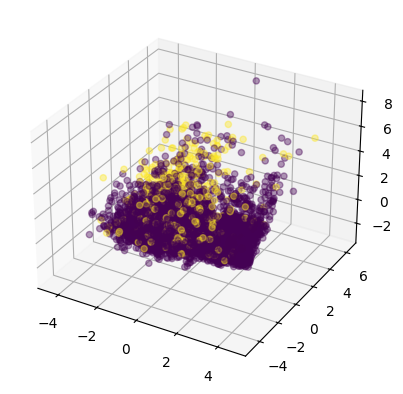


PCA 2D: 


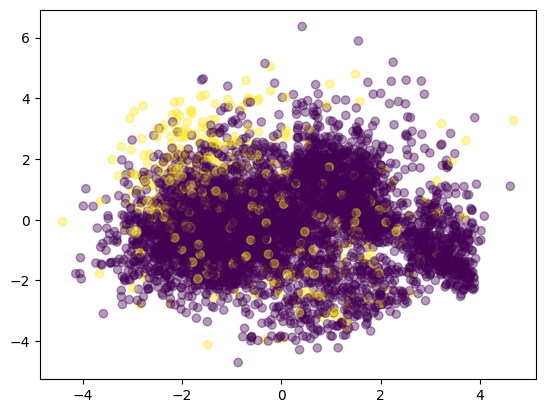


t-SNE 3D: 


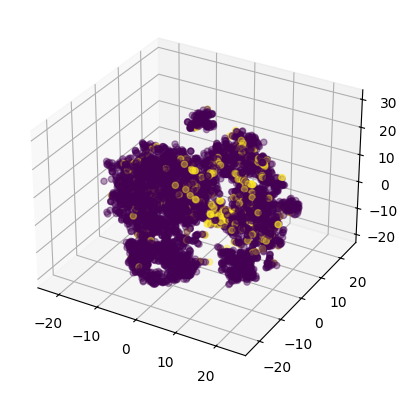


t-SNE 2D: 


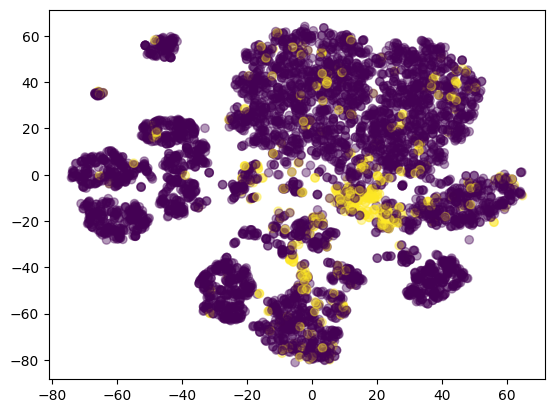

In [236]:
y_pred = np.where(y_pred>.5, 1, 0)
do_visualize(y_pred, True)

In [213]:
oversample = SMOTE(sampling_strategy = 0.3)
X_SMOTE, y_SMOTE = oversample.fit_resample(X_train_normal, y_train)
counter = Counter(y_SMOTE)
counter

Counter({0: 21804, 1: 6541})

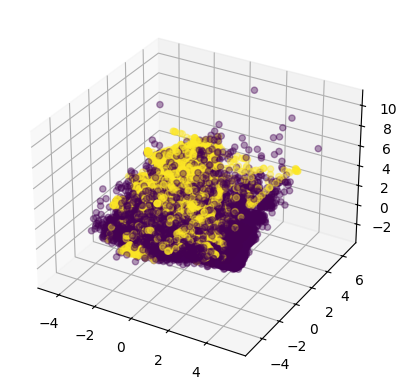

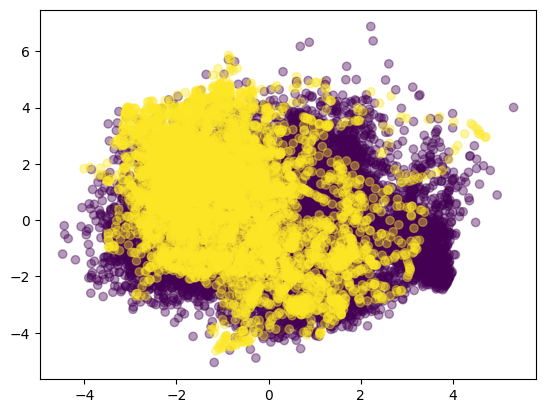

In [214]:
temp = pca.transform(X_SMOTE)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(temp[:,0], temp[:,1], temp[:,2], c=y_SMOTE, cmap="viridis", alpha=0.4)
plt.show()

fig = plt.figure()
ax = fig.add_subplot()
ax.scatter(temp[:,0], temp[:,1], c=y_SMOTE, cmap="viridis", alpha=0.4)
plt.show()

Epoch 1/10
798/798 [==============================] - 8s 8ms/step - loss: 0.3199 - accuracy: 0.8762 - val_loss: 1.3042 - val_accuracy: 0.1605
Epoch 2/10
798/798 [==============================] - 6s 7ms/step - loss: 0.2765 - accuracy: 0.8855 - val_loss: 1.2389 - val_accuracy: 0.3771
Epoch 3/10
798/798 [==============================] - 6s 7ms/step - loss: 0.2600 - accuracy: 0.8951 - val_loss: 0.8995 - val_accuracy: 0.6049
Epoch 4/10
798/798 [==============================] - 6s 8ms/step - loss: 0.2489 - accuracy: 0.8976 - val_loss: 0.6981 - val_accuracy: 0.7108
Epoch 5/10
798/798 [==============================] - 6s 7ms/step - loss: 0.2403 - accuracy: 0.9015 - val_loss: 0.8412 - val_accuracy: 0.6360
Epoch 6/10
798/798 [==============================] - 6s 8ms/step - loss: 0.2266 - accuracy: 0.9076 - val_loss: 0.9438 - val_accuracy: 0.6169
Epoch 7/10
798/798 [==============================] - 6s 7ms/step - loss: 0.2172 - accuracy: 0.9112 - val_loss: 0.7579 - val_accuracy: 0.6790
Epoch 

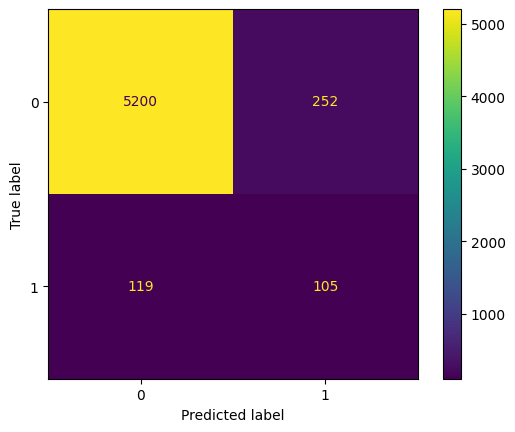

AUC score is  0.8398490724242741


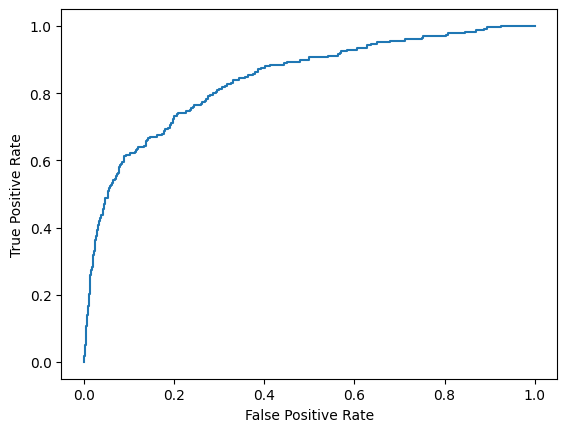

AUPRC score is  0.2520917390905364


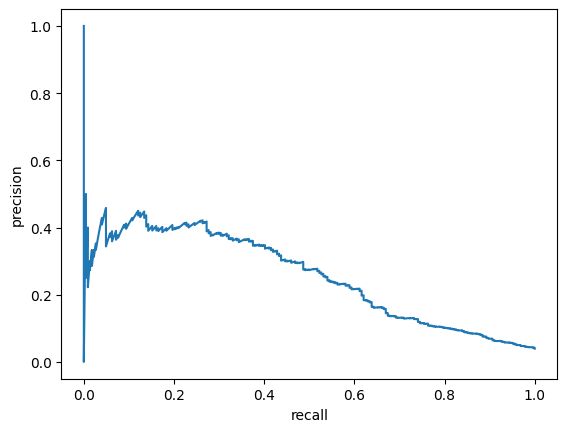

[0.6358725103126417,
 0.7112642149669846,
 0.6635007209228708,
 0.9346370683579986,
 0.8398490724242741,
 0.2520917390905364]

In [239]:
b_model, y_pred, _ = train_base_model(X_SMOTE, y_SMOTE, 17, X_test_normal)
calculate_metrics(y_test, y_pred, is_prob=True)

PCA 3D: 


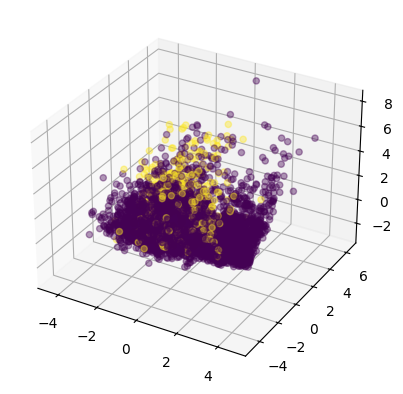


PCA 2D: 


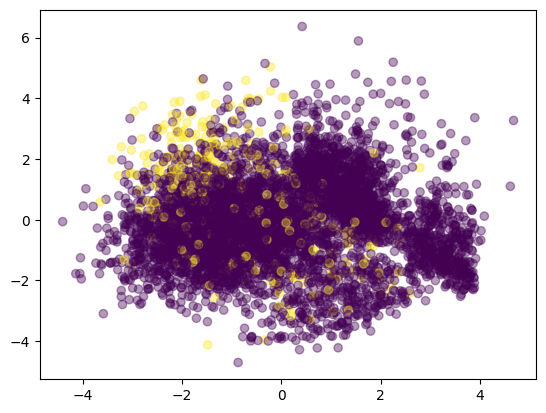


t-SNE 3D: 


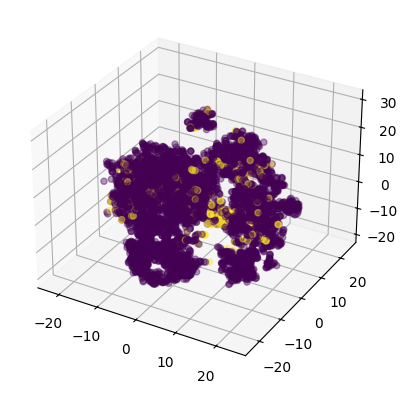


t-SNE 2D: 


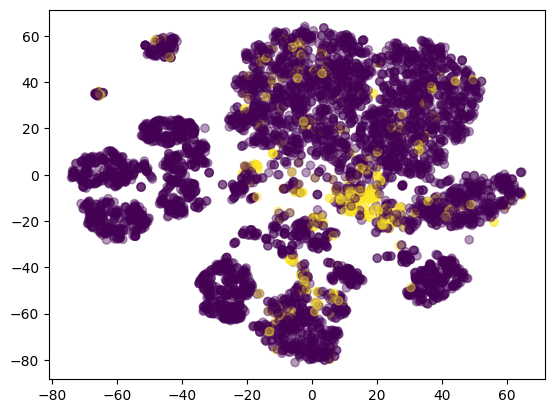

In [240]:
y_pred = np.where(y_pred>.5, 1, 0)
do_visualize(y_pred, True)

##### Borderline-SMOTE

In [215]:
from imblearn.over_sampling import BorderlineSMOTE
from collections import Counter

In [216]:
counter = Counter(y_train)
counter

Counter({0: 21804, 1: 897})

In [217]:
oversample = BorderlineSMOTE()
X_Border_SMOTE, y_Border_SMOTE = oversample.fit_resample(X_train_normal, y_train)
counter = Counter(y_Border_SMOTE)
counter

Counter({0: 21804, 1: 21804})

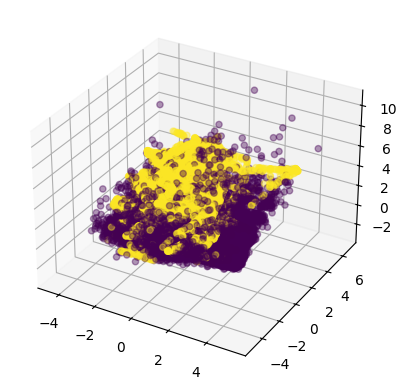

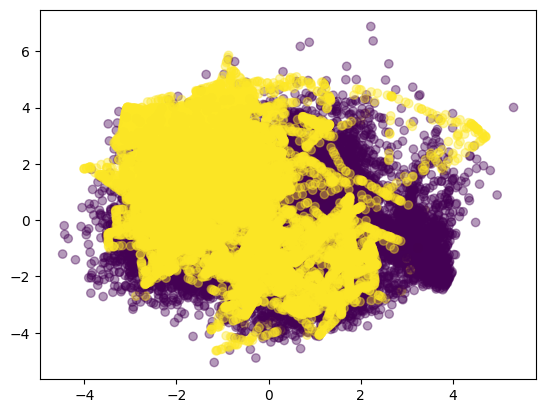

In [218]:
temp = pca.transform(X_Border_SMOTE)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(temp[:,0], temp[:,1], temp[:,2], c=y_Border_SMOTE, cmap="viridis", alpha=0.4)
plt.show()

fig = plt.figure()
ax = fig.add_subplot()
ax.scatter(temp[:,0], temp[:,1], c=y_Border_SMOTE, cmap="viridis", alpha=0.4)
plt.show()

In [219]:
b_model, y_pred, _ = train_base_model(X_Border_SMOTE, y_Border_SMOTE, 17, X_test_normal)

Epoch 1/10


1227/1227 [==============================] - 9s 6ms/step - loss: 0.3309 - accuracy: 0.8713 - val_loss: 0.2505 - val_accuracy: 0.9103
Epoch 2/10
1227/1227 [==============================] - 7s 6ms/step - loss: 0.2614 - accuracy: 0.9000 - val_loss: 0.1681 - val_accuracy: 0.9564
Epoch 3/10
1227/1227 [==============================] - 7s 6ms/step - loss: 0.2255 - accuracy: 0.9174 - val_loss: 0.0721 - val_accuracy: 0.9812
Epoch 4/10
1227/1227 [==============================] - 6s 5ms/step - loss: 0.2030 - accuracy: 0.9285 - val_loss: 0.1386 - val_accuracy: 0.9640
Epoch 5/10
1227/1227 [==============================] - 6s 5ms/step - loss: 0.1850 - accuracy: 0.9362 - val_loss: 0.0527 - val_accuracy: 0.9888
Epoch 6/10
1227/1227 [==============================] - 6s 5ms/step - loss: 0.1713 - accuracy: 0.9432 - val_loss: 0.1057 - val_accuracy: 0.9780
Epoch 7/10
1227/1227 [==============================] - 7s 6ms/step - loss: 0.1627 - accuracy: 0.9460 - val_loss: 0.0926 - val_accuracy: 0.9789
Epo

precision_score: 0.6894985465116279
recall_score: 0.6468956346294938
f1_score: 0.6650845807472314
accuracy_score: 0.9548978153629316

              precision    recall  f1-score   support

           0       0.97      0.98      0.98      5452
           1       0.41      0.31      0.35       224

    accuracy                           0.95      5676
   macro avg       0.69      0.65      0.67      5676
weighted avg       0.95      0.95      0.95      5676




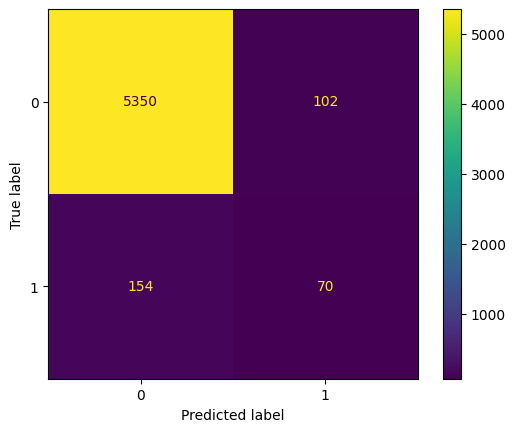

AUC score is  0.8159399237501312


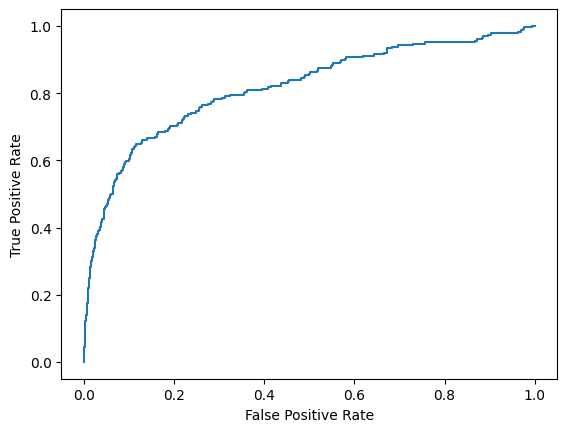

AUPRC score is  0.28054873193742236


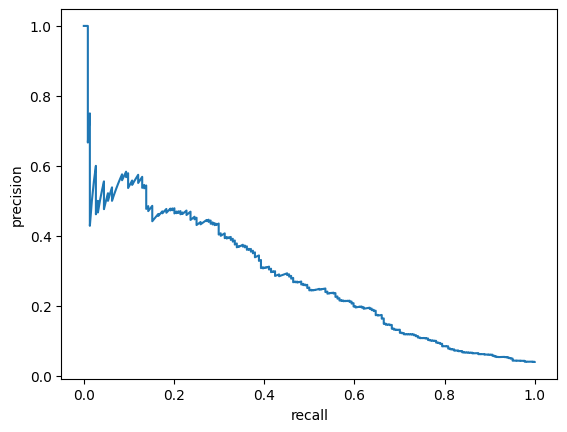

In [220]:
metrics_of_methodes["Borderline-SMOTE"] = calculate_metrics(y_test, y_pred, is_prob=True, threshold=0.85)

PCA 3D: 


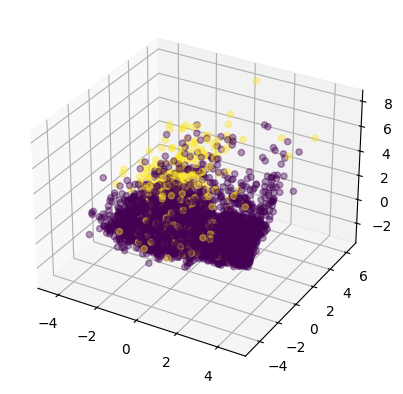


PCA 2D: 


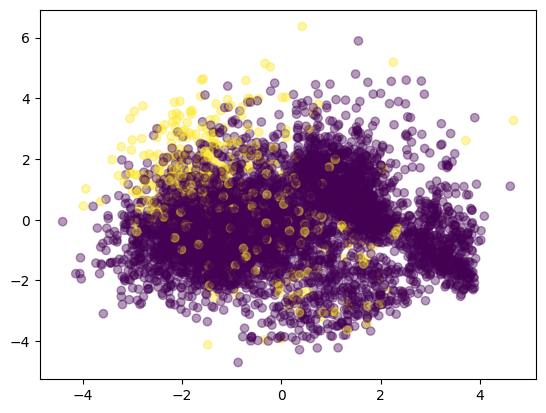


t-SNE 3D: 


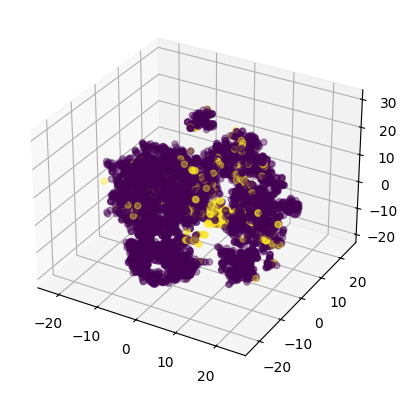


t-SNE 2D: 


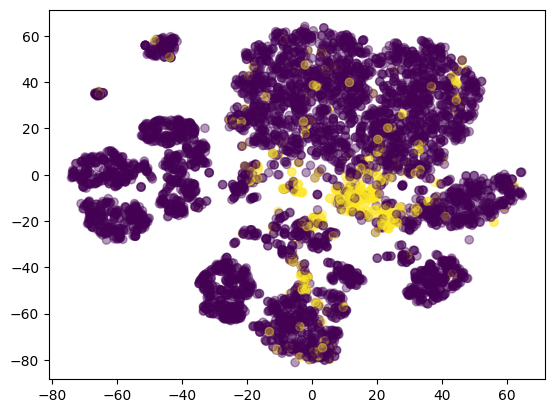

In [246]:
y_pred = np.where(y_pred>.5, 1, 0)
do_visualize(y_pred, True)

In [221]:
oversample = BorderlineSMOTE(sampling_strategy = 0.3)
X_Border_SMOTE, y_Border_SMOTE = oversample.fit_resample(X_train_normal, y_train)
counter = Counter(y_Border_SMOTE)
counter

Counter({0: 21804, 1: 6541})

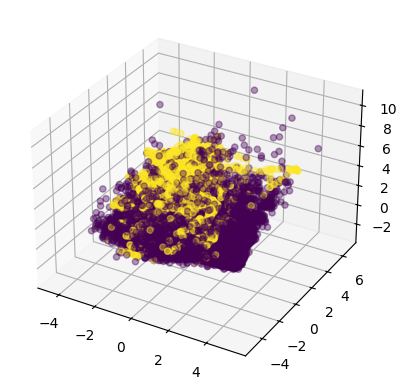

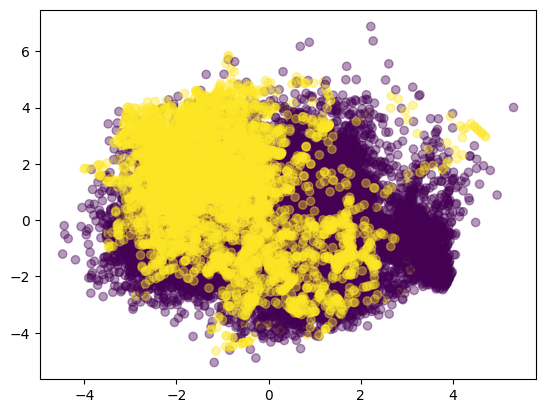

In [222]:
temp = pca.transform(X_Border_SMOTE)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(temp[:,0], temp[:,1], temp[:,2], c=y_Border_SMOTE, cmap="viridis", alpha=0.4)
plt.show()

fig = plt.figure()
ax = fig.add_subplot()
ax.scatter(temp[:,0], temp[:,1], c=y_Border_SMOTE, cmap="viridis", alpha=0.4)
plt.show()

In [249]:
b_model, y_pred, _ = train_base_model(X_Border_SMOTE, y_Border_SMOTE, 17, X_test_normal)

Epoch 1/10
798/798 [==============================] - 8s 7ms/step - loss: 0.2798 - accuracy: 0.8891 - val_loss: 0.5304 - val_accuracy: 0.7661
Epoch 2/10
798/798 [==============================] - 6s 7ms/step - loss: 0.2320 - accuracy: 0.9060 - val_loss: 0.9972 - val_accuracy: 0.5411
Epoch 3/10
798/798 [==============================] - 6s 7ms/step - loss: 0.2158 - accuracy: 0.9104 - val_loss: 0.6073 - val_accuracy: 0.7704
Epoch 4/10
798/798 [==============================] - 6s 7ms/step - loss: 0.2045 - accuracy: 0.9168 - val_loss: 0.5493 - val_accuracy: 0.7873
Epoch 5/10
798/798 [==============================] - 6s 7ms/step - loss: 0.1948 - accuracy: 0.9228 - val_loss: 0.5358 - val_accuracy: 0.7961
Epoch 6/10
798/798 [==============================] - 6s 7ms/step - loss: 0.1854 - accuracy: 0.9272 - val_loss: 0.4473 - val_accuracy: 0.8437
Epoch 7/10
798/798 [==============================] - 6s 7ms/step - loss: 0.1768 - accuracy: 0.9314 - val_loss: 0.3799 - val_accuracy: 0.8631
Epoch 

precision_score: 0.6199172576832152
recall_score: 0.5199369824965937
f1_score: 0.5276429304557685
accuracy_score: 0.9577167019027484

              precision    recall  f1-score   support

           0       0.96      1.00      0.98      5452
           1       0.28      0.04      0.08       224

    accuracy                           0.96      5676
   macro avg       0.62      0.52      0.53      5676
weighted avg       0.94      0.96      0.94      5676




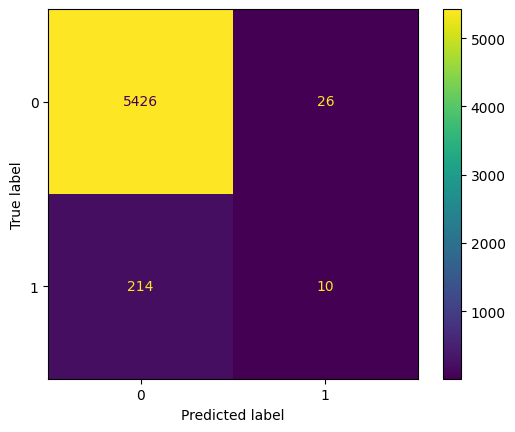

AUC score is  0.8441569607483493


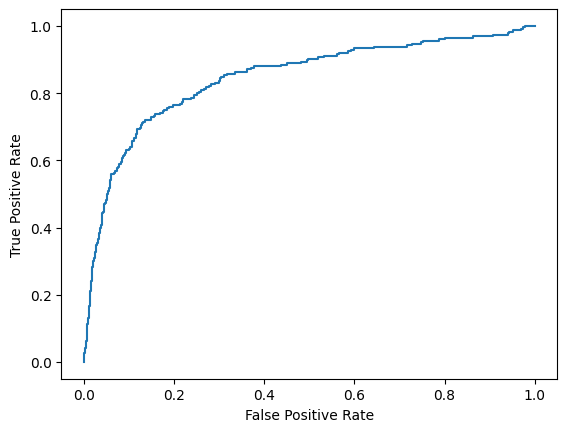

AUPRC score is  0.2409919117059716


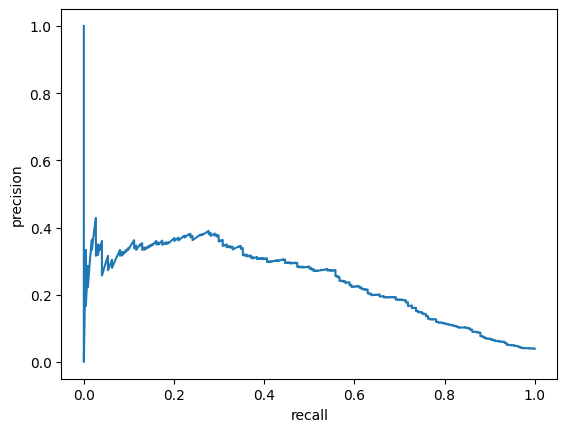

[0.6199172576832152,
 0.5199369824965937,
 0.5276429304557685,
 0.9577167019027484,
 0.8441569607483493,
 0.2409919117059716]

In [250]:
calculate_metrics(y_test, y_pred, is_prob=True, threshold=0.9)

PCA 3D: 


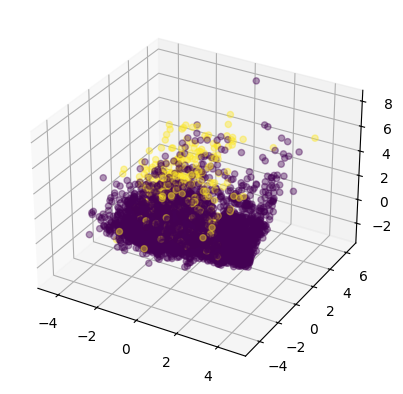


PCA 2D: 


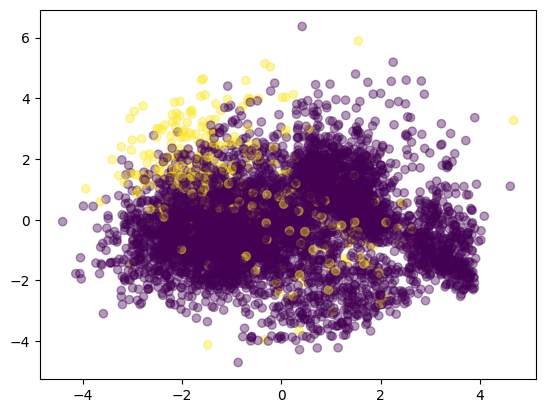


t-SNE 3D: 


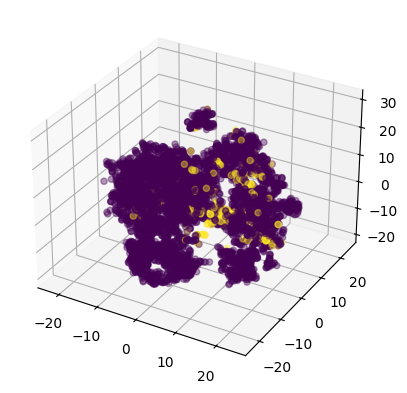


t-SNE 2D: 


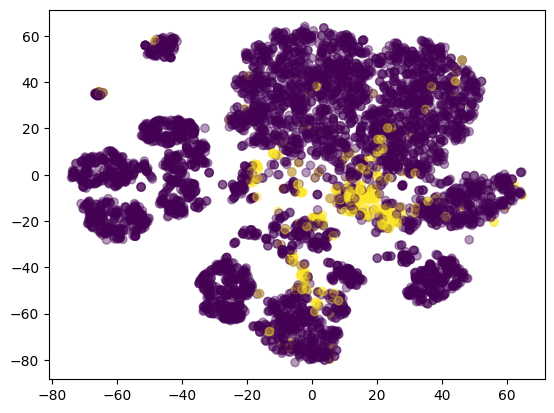

In [251]:
y_pred = np.where(y_pred>.5, 1, 0)
do_visualize(y_pred, True)

##### Borderline-SMOTE SVM

In [223]:
from imblearn.over_sampling import SVMSMOTE
from collections import Counter

In [224]:
counter = Counter(y_train)
counter

Counter({0: 21804, 1: 897})

In [225]:
oversample = SVMSMOTE()
X_SVM_SMOTE, y_SVM_SMOTE = oversample.fit_resample(X_train_normal, y_train)
counter = Counter(y_SVM_SMOTE)
counter

Counter({0: 21804, 1: 21804})

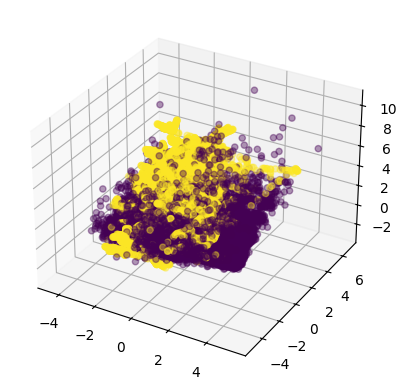

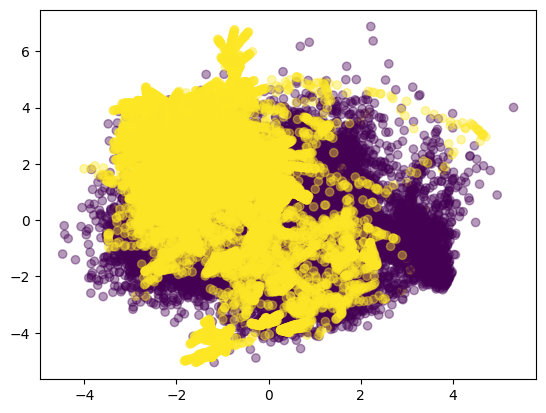

In [226]:
temp = pca.transform(X_SVM_SMOTE)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(temp[:,0], temp[:,1], temp[:,2], c=y_SVM_SMOTE, cmap="viridis", alpha=0.4)
plt.show()

fig = plt.figure()
ax = fig.add_subplot()
ax.scatter(temp[:,0], temp[:,1], c=y_SVM_SMOTE, cmap="viridis", alpha=0.4)
plt.show()

In [227]:
b_model, y_pred, _ = train_base_model(X_SVM_SMOTE, y_SVM_SMOTE, 17, X_test_normal)

Epoch 1/10


1227/1227 [==============================] - 9s 6ms/step - loss: 0.2883 - accuracy: 0.8921 - val_loss: 0.1405 - val_accuracy: 1.0000
Epoch 2/10
1227/1227 [==============================] - 6s 5ms/step - loss: 0.2284 - accuracy: 0.9172 - val_loss: 0.0335 - val_accuracy: 1.0000
Epoch 3/10
1227/1227 [==============================] - 7s 6ms/step - loss: 0.2019 - accuracy: 0.9271 - val_loss: 0.0077 - val_accuracy: 1.0000
Epoch 4/10
1227/1227 [==============================] - 6s 5ms/step - loss: 0.1849 - accuracy: 0.9348 - val_loss: 0.0373 - val_accuracy: 1.0000
Epoch 5/10
1227/1227 [==============================] - 7s 6ms/step - loss: 0.1729 - accuracy: 0.9390 - val_loss: 0.0155 - val_accuracy: 1.0000
Epoch 6/10
1227/1227 [==============================] - 6s 5ms/step - loss: 0.1599 - accuracy: 0.9453 - val_loss: 0.0207 - val_accuracy: 0.9998
Epoch 7/10
1227/1227 [==============================] - 7s 5ms/step - loss: 0.1511 - accuracy: 0.9496 - val_loss: 0.0441 - val_accuracy: 0.9817
Epo

precision_score: 0.6772614750416992
recall_score: 0.5959837805261503
f1_score: 0.6227110233424177
accuracy_score: 0.9557787174066243

              precision    recall  f1-score   support

           0       0.97      0.99      0.98      5452
           1       0.39      0.21      0.27       224

    accuracy                           0.96      5676
   macro avg       0.68      0.60      0.62      5676
weighted avg       0.95      0.96      0.95      5676




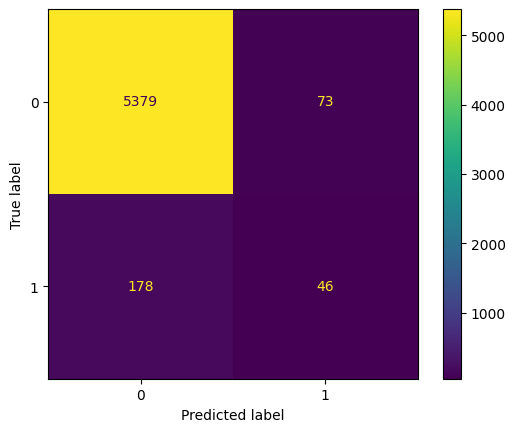

AUC score is  0.8206965333822449


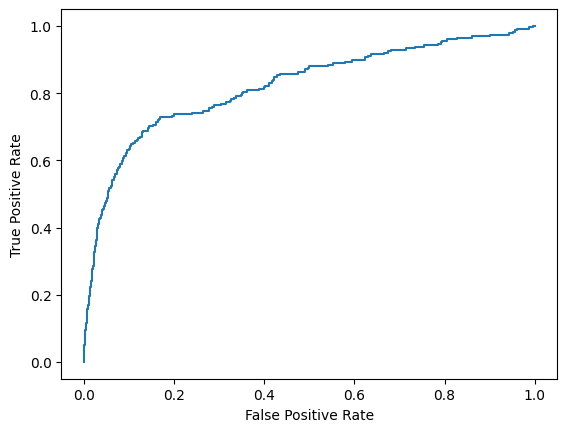

AUPRC score is  0.2746651007464299


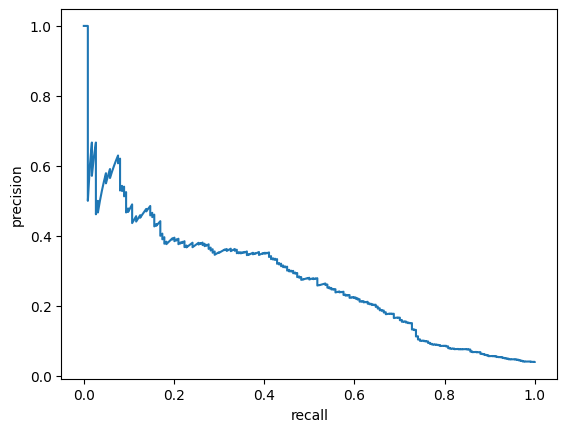

In [228]:
metrics_of_methodes["Borderline-SMOTE_SVM"] = calculate_metrics(y_test, y_pred, is_prob=True, threshold=0.85)

PCA 3D: 


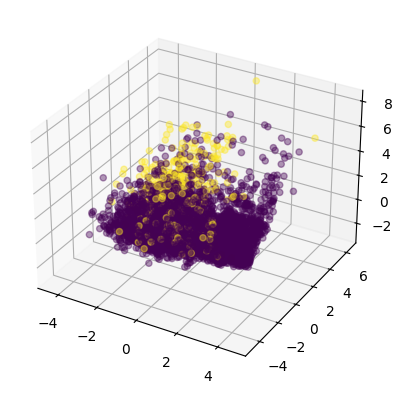


PCA 2D: 


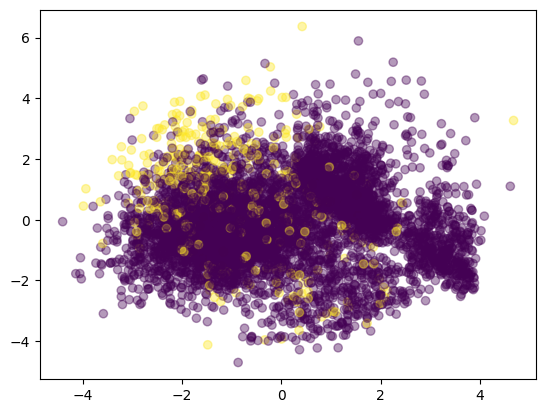


t-SNE 3D: 


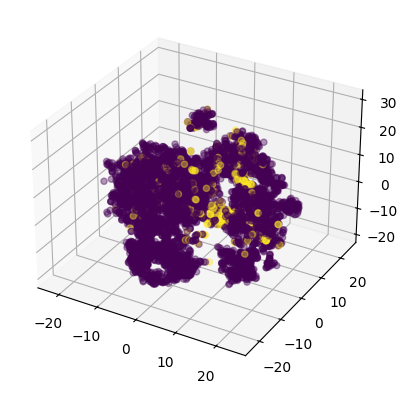


t-SNE 2D: 


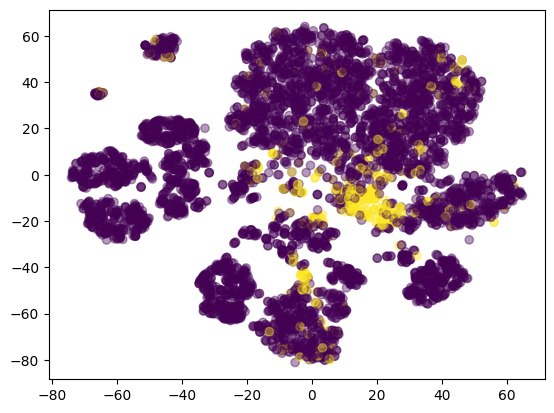

In [257]:
y_pred = np.where(y_pred>.5, 1, 0)
do_visualize(y_pred, True)

In [229]:
oversample = SVMSMOTE(sampling_strategy = 0.3)
X_SVM_SMOTE, y_SVM_SMOTE = oversample.fit_resample(X_train_normal, y_train)
counter = Counter(y_SVM_SMOTE)
counter

Counter({0: 21804, 1: 6541})

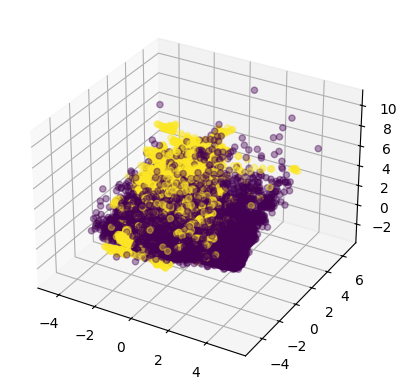

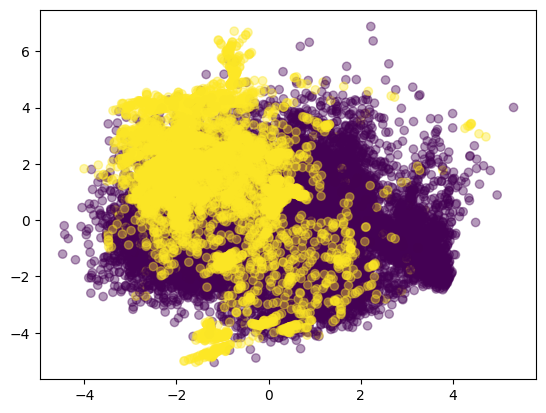

In [230]:
temp = pca.transform(X_SVM_SMOTE)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(temp[:,0], temp[:,1], temp[:,2], c=y_SVM_SMOTE, cmap="viridis", alpha=0.4)
plt.show()

fig = plt.figure()
ax = fig.add_subplot()
ax.scatter(temp[:,0], temp[:,1], c=y_SVM_SMOTE, cmap="viridis", alpha=0.4)
plt.show()

Epoch 1/10
920/920 [==============================] - 10s 9ms/step - loss: 0.3107 - accuracy: 0.8794 - val_loss: 0.1296 - val_accuracy: 0.9982
Epoch 2/10
920/920 [==============================] - 7s 7ms/step - loss: 0.2552 - accuracy: 0.9012 - val_loss: 0.0498 - val_accuracy: 0.9997
Epoch 3/10
920/920 [==============================] - 7s 8ms/step - loss: 0.2333 - accuracy: 0.9109 - val_loss: 0.1163 - val_accuracy: 0.9991
Epoch 4/10
920/920 [==============================] - 7s 8ms/step - loss: 0.2153 - accuracy: 0.9191 - val_loss: 0.0682 - val_accuracy: 0.9991
Epoch 5/10
920/920 [==============================] - 6s 7ms/step - loss: 0.2013 - accuracy: 0.9262 - val_loss: 0.0383 - val_accuracy: 1.0000
Epoch 6/10
920/920 [==============================] - 7s 7ms/step - loss: 0.1890 - accuracy: 0.9308 - val_loss: 0.1279 - val_accuracy: 0.9899
Epoch 7/10
920/920 [==============================] - 6s 7ms/step - loss: 0.1788 - accuracy: 0.9376 - val_loss: 0.0883 - val_accuracy: 0.9933
Epoch

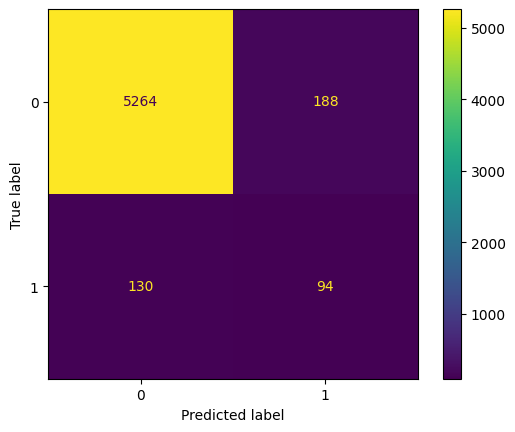

AUC score is  0.8378036238339798


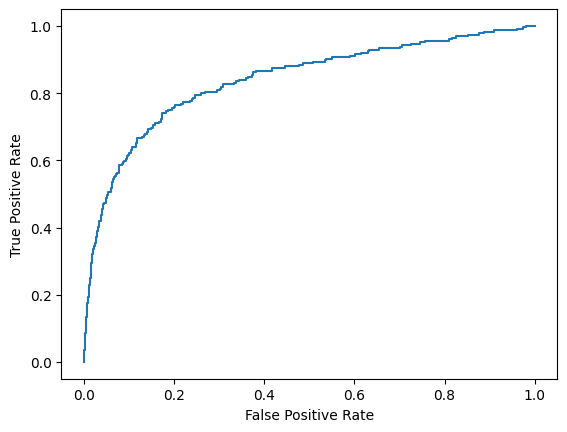

AUPRC score is  0.278634289921419


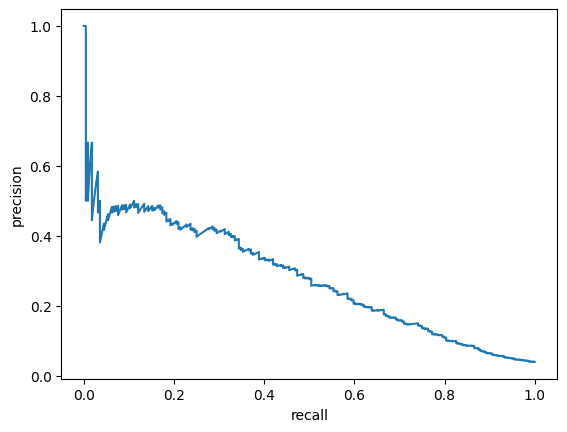

[0.6546162402669633,
 0.6925800492610837,
 0.6711109685798812,
 0.9439746300211417,
 0.8378036238339798,
 0.278634289921419]

In [260]:
b_model, y_pred, _ = train_base_model(X_SVM_SMOTE, y_SVM_SMOTE, 17, X_test_normal)
calculate_metrics(y_test, y_pred, is_prob=True)

PCA 3D: 


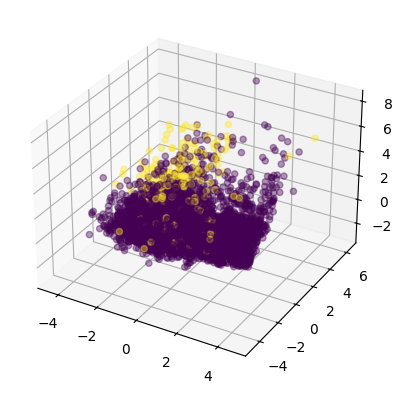


PCA 2D: 


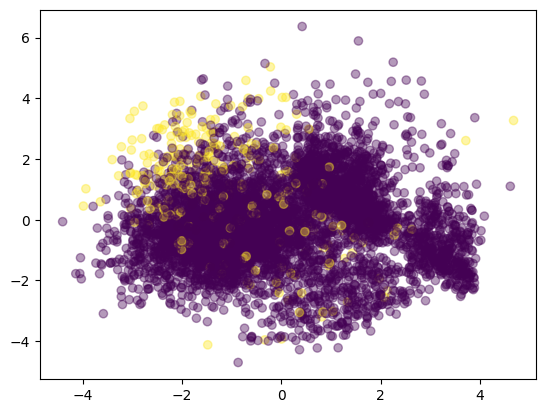


t-SNE 3D: 


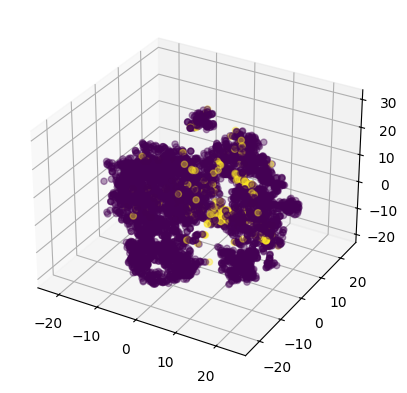


t-SNE 2D: 


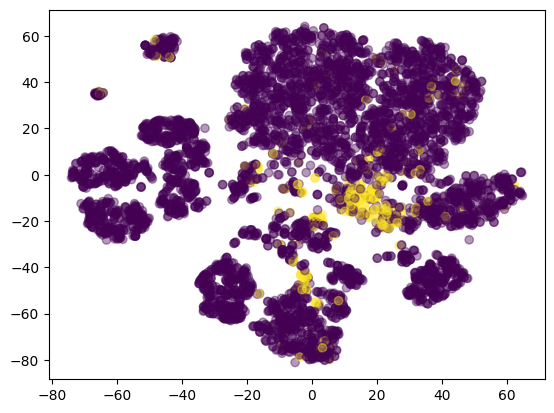

In [261]:
y_pred = np.where(y_pred>.5, 1, 0)
do_visualize(y_pred, True)

##### Adaptive Synthetic Sampling (ADASYN)

In [231]:
from imblearn.over_sampling import ADASYN
from collections import Counter

In [232]:
counter = Counter(y_train)
counter

Counter({0: 21804, 1: 897})

In [233]:
oversample = ADASYN()
X_ADASYN, y_ADASYN = oversample.fit_resample(X_train_normal, y_train)
counter = Counter(y_ADASYN)
counter

Counter({0: 21804, 1: 21892})

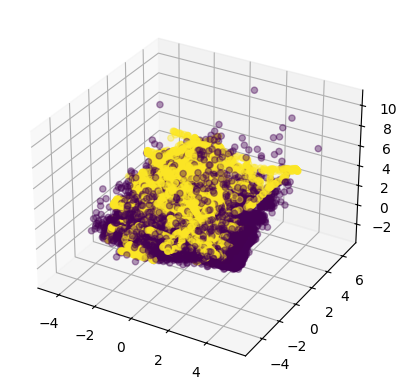

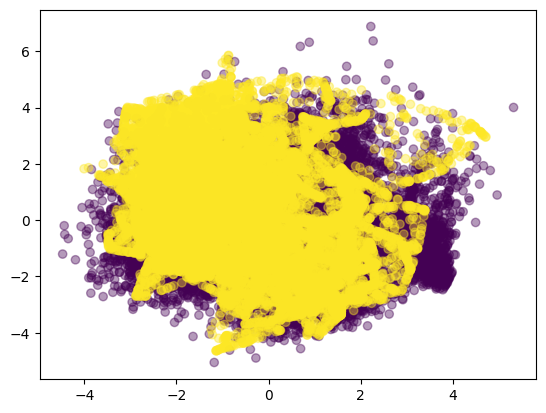

In [234]:
temp = pca.transform(X_ADASYN)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(temp[:,0], temp[:,1], temp[:,2], c=y_ADASYN, cmap="viridis", alpha=0.4)
plt.show()

fig = plt.figure()
ax = fig.add_subplot()
ax.scatter(temp[:,0], temp[:,1], c=y_ADASYN, cmap="viridis", alpha=0.4)
plt.show()

In [235]:
b_model, y_pred, _ = train_base_model(X_ADASYN, y_ADASYN, 17, X_test_normal)

Epoch 1/10
1229/1229 [==============================] - 9s 6ms/step - loss: 0.4843 - accuracy: 0.7840 - val_loss: 0.5520 - val_accuracy: 0.7984
Epoch 2/10
1229/1229 [==============================] - 7s 6ms/step - loss: 0.3905 - accuracy: 0.8300 - val_loss: 0.4453 - val_accuracy: 0.8359
Epoch 3/10
1229/1229 [==============================] - 7s 6ms/step - loss: 0.3332 - accuracy: 0.8579 - val_loss: 0.5939 - val_accuracy: 0.7645
Epoch 4/10
1229/1229 [==============================] - 7s 5ms/step - loss: 0.2872 - accuracy: 0.8834 - val_loss: 0.5685 - val_accuracy: 0.7961
Epoch 5/10
1229/1229 [==============================] - 7s 6ms/step - loss: 0.2505 - accuracy: 0.8999 - val_loss: 0.4090 - val_accuracy: 0.8428
Epoch 6/10
1229/1229 [==============================] - 6s 5ms/step - loss: 0.2280 - accuracy: 0.9100 - val_loss: 0.2334 - val_accuracy: 0.9124
Epoch 7/10
1229/1229 [==============================] - 6s 5ms/step - loss: 0.2088 - accuracy: 0.9212 - val_loss: 0.2720 - val_accuracy:

precision_score: 0.6556099169648615
recall_score: 0.6294364453411592
f1_score: 0.6411035892366915
accuracy_score: 0.9501409443269908

              precision    recall  f1-score   support

           0       0.97      0.98      0.97      5452
           1       0.34      0.28      0.31       224

    accuracy                           0.95      5676
   macro avg       0.66      0.63      0.64      5676
weighted avg       0.95      0.95      0.95      5676




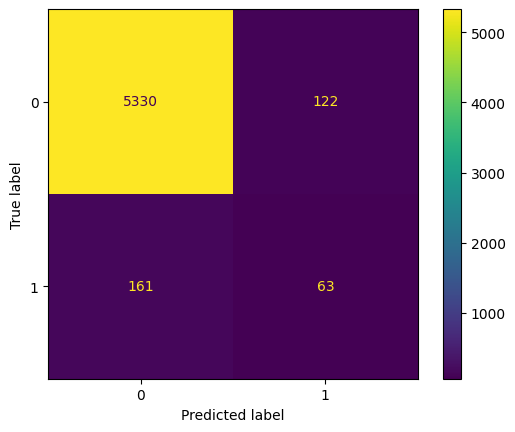

AUC score is  0.8132549654124307


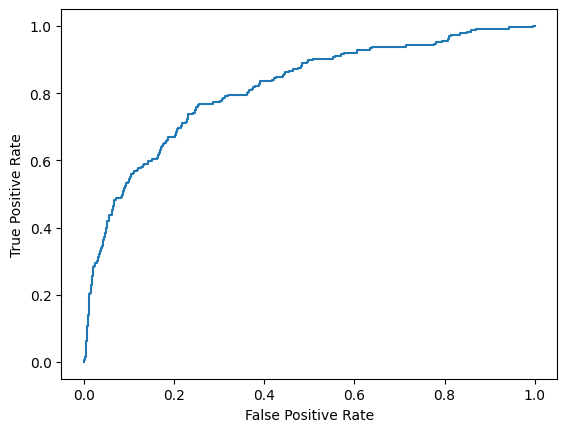

AUPRC score is  0.19896778460571912


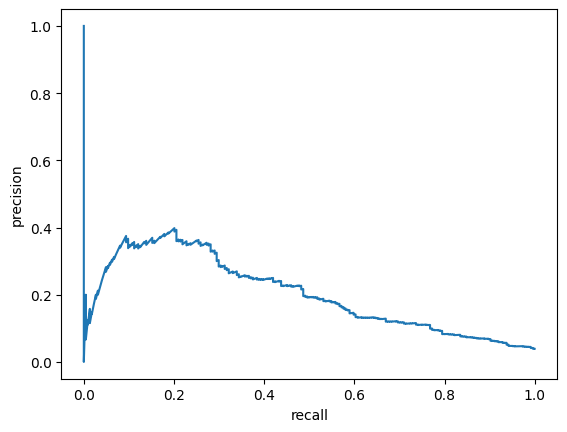

In [236]:
metrics_of_methodes["ADASYN"] = calculate_metrics(y_test, y_pred, is_prob=True, threshold=0.85)

PCA 3D: 


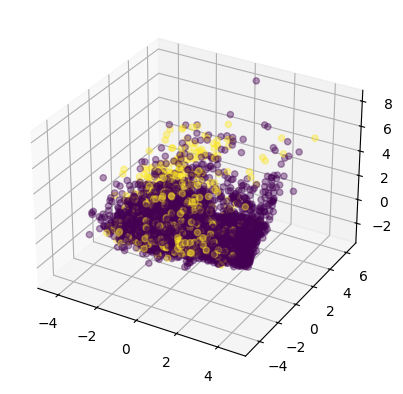


PCA 2D: 


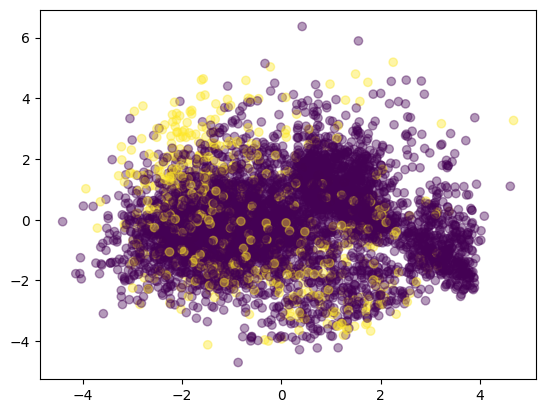


t-SNE 3D: 


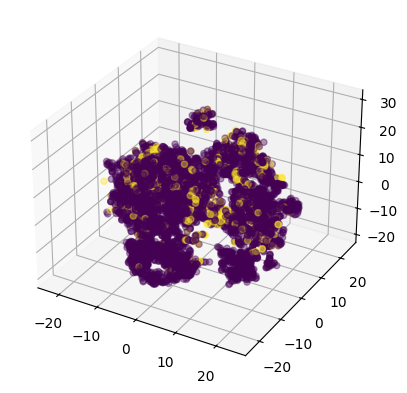


t-SNE 2D: 


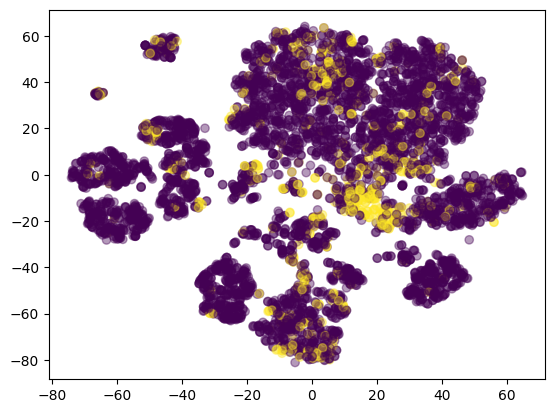

In [267]:
y_pred = np.where(y_pred>.5, 1, 0)
do_visualize(y_pred, True)

##### Generative Models

In [237]:
def compare(data_set, data_generated):
    closest = np.zeros((data_generated.shape[0]), dtype="int32")
    for indx, data in enumerate(data_generated):
        closest[indx] = np.argmin((np.sum(((data_set-data)**2), axis=1)))
    return(closest)

In [238]:
def generate_data_with_SMOTE(model, X_data, y_data, label_dict, label = 1, num_class= 2, filter_data = False):

    y_data_one_hot = tf.one_hot(y_data, depth = num_class)
    mean, logvar = model.encode(X_data, y_data_one_hot)
    z = model.reparameterize(mean, logvar)
    extend_z, extend_y = model.Oversample(z, y_data, label_dict)
    new_z = np.copy(extend_z[z.shape[0]:])
    new_y = np.copy(extend_y[z.shape[0]:])

    flag_first_time = True
    for cat in label:
        if flag_first_time:
            generated_num = new_z[new_y == cat].shape[0]
            y_generated = np.ones((generated_num,)) * cat
            y_generated = tf.one_hot(y_generated, depth = num_class)
            X_sample = model.decode(new_z[new_y == cat][0:32*int(generated_num/32)], y_generated[0:32*int(generated_num/32)])

            if (filter_data):
                nearest, error = compare(X_data[y_data == cat], X_sample)
                X_sample = X_sample[error <= 20]

            y_sample = np.ones((X_sample.shape[0],)) * cat
            new_generated_data = np.copy(X_sample)
            new_generated_y = np.copy(y_sample)

            flag_first_time = False
        else:
            generated_num = new_z[new_y == cat].shape[0]
            y_generated = np.ones((generated_num,)) * cat
            y_generated = tf.one_hot(y_generated, depth = num_class)
            X_sample = model.decode(new_z[new_y == cat][0:32*int(generated_num/32)], y_generated[0:32*int(generated_num/32)])

            if (filter_data):
                nearest, error = compare(X_data[y_data == cat], X_sample)
                X_sample = X_sample[error <= 20]

            y_sample = np.ones((X_sample.shape[0],)) * cat
            new_generated_data = np.vstack((new_generated_data, X_sample))
            new_generated_y = np.hstack((new_generated_y, y_sample))

    return(new_generated_data, new_generated_y)

In [239]:
class My_CVAE(tf.keras.Model):

    def __init__(self, latent_dim, inter_dim):
        super(My_CVAE, self).__init__()

        self.latent_dim = latent_dim
        self.inter_dim = inter_dim

        data = tf.keras.layers.Input(shape = (inter_dim,))
        input_y = tf.keras.layers.Input(shape = (2,))

        concat_layer = tf.keras.layers.Concatenate()([data, input_y])
        x = tf.keras.layers.Dense(300, activation='elu')(concat_layer)
        x = tf.keras.layers.Dropout(0.2)(x)
        x = tf.keras.layers.Dense(200, activation='elu')(x)
        x = tf.keras.layers.Dropout(0.2)(x)
        x = tf.keras.layers.Dense(100, activation='elu')(x)
        x = tf.keras.layers.Dropout(0.2)(x)
        x = tf.keras.layers.Dense(50, activation='elu')(x)
        x = tf.keras.layers.Dropout(0.2)(x)
        encoded = tf.keras.layers.Dense(self.latent_dim + self.latent_dim)(x)
        self.encoder = tf.keras.Model(inputs=[data, input_y], outputs=[encoded])  


        embedd = tf.keras.layers.Input((self.latent_dim,))
        merged_input = tf.keras.layers.Concatenate()([embedd, input_y])
        x = tf.keras.layers.Dense(50, activation='elu')(merged_input)
        x = tf.keras.layers.Dropout(0.2)(x)
        x = tf.keras.layers.Dense(100, activation='elu')(x)
        x = tf.keras.layers.Dropout(0.2)(x)
        x = tf.keras.layers.Dense(200, activation='elu')(x)
        x = tf.keras.layers.Dropout(0.2)(x)
        x = tf.keras.layers.Dense(300, activation='elu')(x)
        x = tf.keras.layers.Dense(inter_dim, activation='linear')(x)
        self.decoder = tf.keras.Model(inputs=[embedd, input_y], outputs=[x])

    # Sample z ~ Q(z|X,y)
    @tf.function
    def sample(self, y, eps=None ):
        if eps is None:
            eps = tf.random.normal(shape=(y.shape[0], self.latent_dim))
        #return self.decode(eps)
        return self.decode(eps, y, apply_sigmoid=False)

    def encode(self, x, y):
        mean, logvar = tf.split(self.encoder([x, y]), num_or_size_splits=2, axis=1)
        return mean, logvar

    def reparameterize(self, mean, logvar):
        # eps = tf.random.normal(shape=mean.shape)
        eps = tf.random.normal(shape=mean.shape, mean=0.5, stddev=0.5)
        return eps * tf.exp(logvar * .5) + mean

    def Oversample(self, z, y, ratio):
        oversample = SMOTE(sampling_strategy = ratio)
        X, y = oversample.fit_resample(z, y)
        return(X, y)

    def decode(self, z, y, apply_sigmoid=False):
        logits = self.decoder([z, y])
        if apply_sigmoid:
            probs = tf.sigmoid(logits)
            return probs
        return logits
    
    def call(self, x):
        mean, logvar = self.encode(x[0], x[1])
        z = self.reparameterize(mean, logvar)
        predictions = self.decode(z, x[1])
        return(predictions)

In [240]:
y_train_one_hot = tf.one_hot(y_train, depth=2)
y_test_one_hot = tf.one_hot(y_test, depth=2)

generative_model = My_CVAE(10, X_train.shape[1])
generative_model.compile(optimizer='adam', loss = 'mse')

In [241]:
X_train_normal.shape

(22701, 17)

In [242]:
history = generative_model.fit([X_train_normal[:22688], y_train_one_hot[:22688]], X_train_normal[:22688], 
    batch_size=None,
    epochs=15,
    verbose="auto",
    callbacks=None,
    validation_split=None,
    validation_data=None,
    shuffle=True,
    class_weight=None,
    sample_weight=None,
    initial_epoch=0,
    steps_per_epoch=None,
    validation_steps=None,
    validation_batch_size=None,
    validation_freq=1,
    max_queue_size=10,
    workers=1,
    use_multiprocessing=False,
        )

Epoch 1/15


709/709 [==============================] - 6s 5ms/step - loss: 0.4026
Epoch 2/15
709/709 [==============================] - 3s 5ms/step - loss: 0.2715
Epoch 3/15
709/709 [==============================] - 3s 4ms/step - loss: 0.2380
Epoch 4/15
709/709 [==============================] - 3s 5ms/step - loss: 0.2222
Epoch 5/15
709/709 [==============================] - 3s 4ms/step - loss: 0.2087
Epoch 6/15
709/709 [==============================] - 3s 5ms/step - loss: 0.2034
Epoch 7/15
709/709 [==============================] - 3s 5ms/step - loss: 0.1959
Epoch 8/15
709/709 [==============================] - 3s 5ms/step - loss: 0.1893
Epoch 9/15
709/709 [==============================] - 4s 5ms/step - loss: 0.1863
Epoch 10/15
709/709 [==============================] - 3s 4ms/step - loss: 0.1833
Epoch 11/15
709/709 [==============================] - 3s 4ms/step - loss: 0.1814
Epoch 12/15
709/709 [==============================] - 4s 6ms/step - loss: 0.1748
Epoch 13/15
709/709 [===============

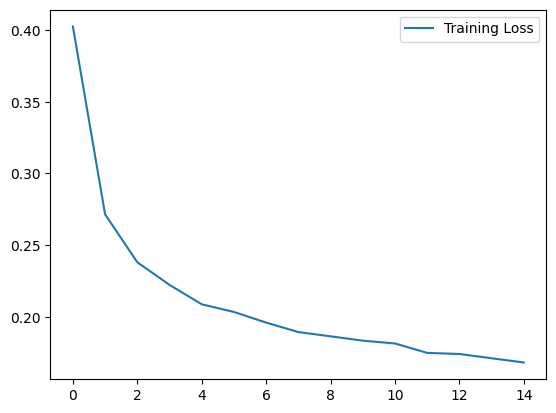

In [243]:
import matplotlib.pyplot as plt

plt.plot(history.history["loss"], label="Training Loss")
plt.legend()

In [244]:
number_data_generation = {1:7000}
new_generated_data, new_generated_y = generate_data_with_SMOTE(generative_model,
                                                               np.array(X_train_normal[:22400]),
                                                               y_train[:22400],
                                                               number_data_generation,
                                                               label = [1],
                                                               num_class= 2)

In [245]:
Counter(new_generated_y)

Counter({1.0: 6112})

In [246]:
closest_data = compare(X_train_normal, new_generated_data)

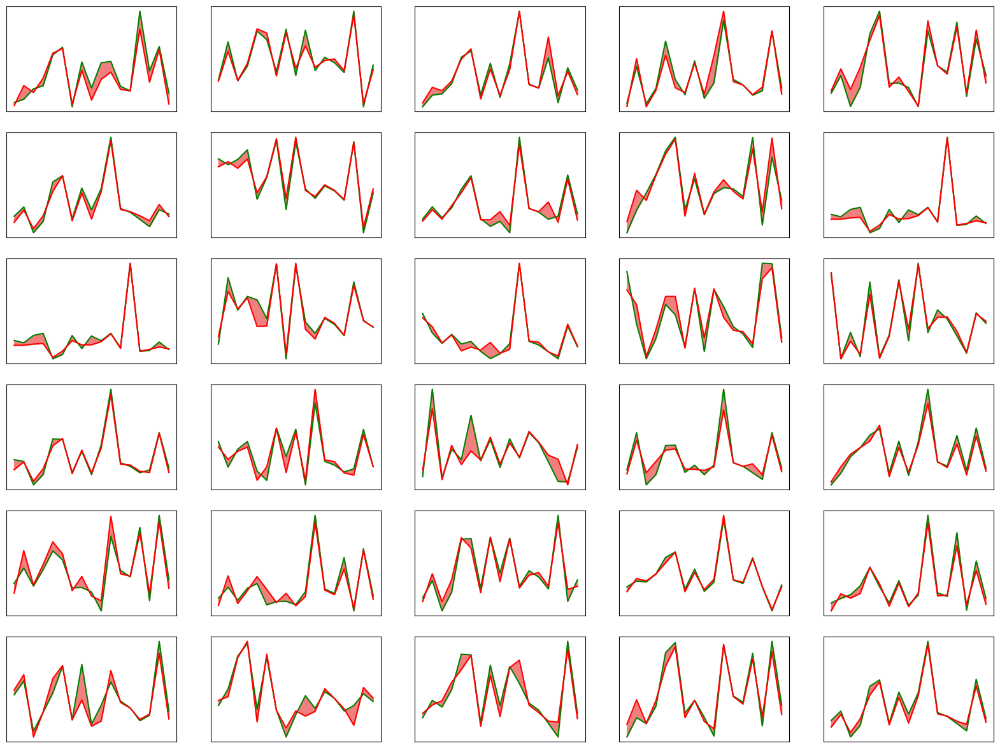

In [247]:
figure = plt.figure(figsize=(20, 15))
for label_index in range(30):
    ax = figure.add_subplot(6, 5, label_index + 1, xticks=[], yticks=[])
    ax.plot(np.array(X_train_normal)[closest_data[label_index]], 'g')
    ax.plot(new_generated_data[label_index], 'r')
    ax.fill_between(np.arange(X_train_normal.shape[1]), np.array(X_train_normal)[closest_data[label_index]], new_generated_data[label_index], color='lightcoral')

In [248]:
idx = np.random.permutation(new_generated_data.shape[0])
new_generated_data, new_generated_y = new_generated_data[idx], new_generated_y[idx]

In [249]:
new_dataset = np.vstack((X_train_normal, new_generated_data))
new_label = np.hstack((y_train, new_generated_y))

In [250]:
idx = np.random.permutation(new_dataset.shape[0])
new_dataset, new_label = new_dataset[idx], new_label[idx]

In [251]:
counter = Counter(new_label)
counter

Counter({0.0: 21804, 1.0: 7009})

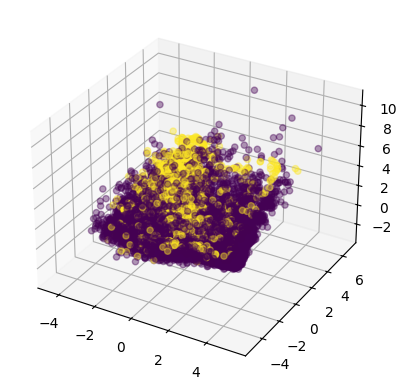

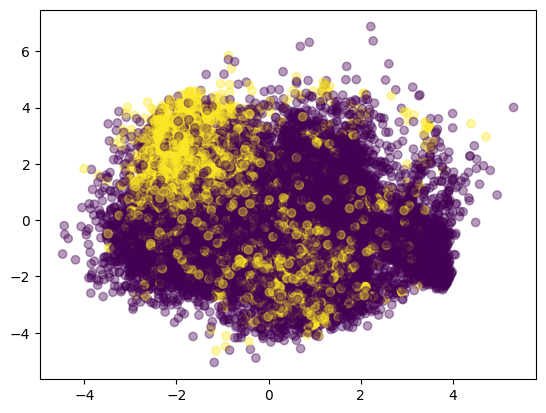

In [252]:
temp = pca.transform(new_dataset)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(temp[:,0], temp[:,1], temp[:,2], c=new_label, cmap="viridis", alpha=0.4)
plt.show()

fig = plt.figure()
ax = fig.add_subplot()
ax.scatter(temp[:,0], temp[:,1], c=new_label, cmap="viridis", alpha=0.4)
plt.show()

In [253]:
b_model, y_pred, _ = train_base_model(new_dataset, new_label, 17, X_test)

Epoch 1/10
811/811 [==============================] - 6s 5ms/step - loss: 0.3772 - accuracy: 0.8465 - val_loss: 0.3133 - val_accuracy: 0.8779
Epoch 2/10
811/811 [==============================] - 4s 5ms/step - loss: 0.2323 - accuracy: 0.9084 - val_loss: 0.1871 - val_accuracy: 0.9316
Epoch 3/10
811/811 [==============================] - 4s 5ms/step - loss: 0.1660 - accuracy: 0.9395 - val_loss: 0.1331 - val_accuracy: 0.9587
Epoch 4/10
811/811 [==============================] - 4s 5ms/step - loss: 0.1408 - accuracy: 0.9519 - val_loss: 0.1240 - val_accuracy: 0.9587
Epoch 5/10
811/811 [==============================] - 4s 5ms/step - loss: 0.1296 - accuracy: 0.9563 - val_loss: 0.1392 - val_accuracy: 0.9427
Epoch 6/10
811/811 [==============================] - 4s 5ms/step - loss: 0.1205 - accuracy: 0.9601 - val_loss: 0.1059 - val_accuracy: 0.9667
Epoch 7/10
811/811 [==============================] - 4s 5ms/step - loss: 0.1198 - accuracy: 0.9597 - val_loss: 0.1137 - val_accuracy: 0.9670
Epoch 

precision_score: 0.5030972534765681
recall_score: 0.5089744261607798
f1_score: 0.4922408417790817
accuracy_score: 0.8461945031712473

              precision    recall  f1-score   support

           0       0.96      0.88      0.92      5452
           1       0.04      0.14      0.07       224

    accuracy                           0.85      5676
   macro avg       0.50      0.51      0.49      5676
weighted avg       0.93      0.85      0.88      5676




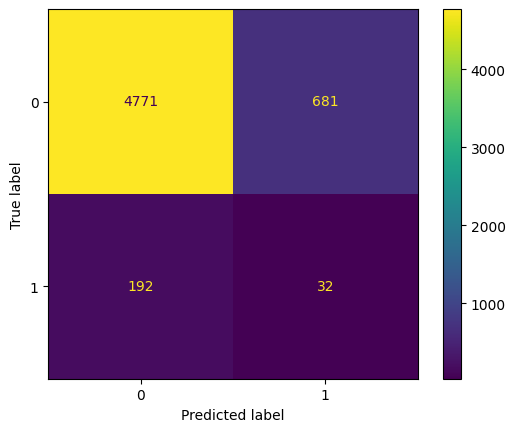

AUC score is  0.49262148228697195


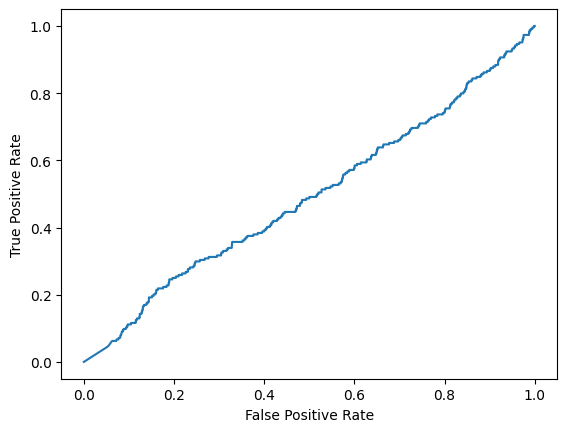

AUPRC score is  0.061591422482392494


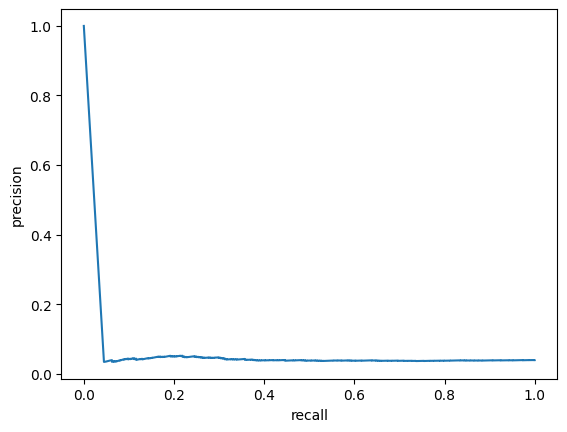

In [267]:
metrics_of_methodes["Deep-SMOTE"] = calculate_metrics(y_test, y_pred, is_prob=True, threshold= 0.9999)

PCA 3D: 


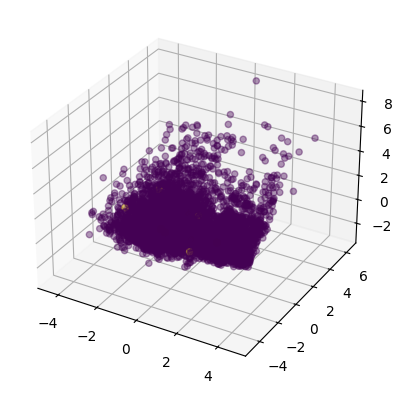


PCA 2D: 


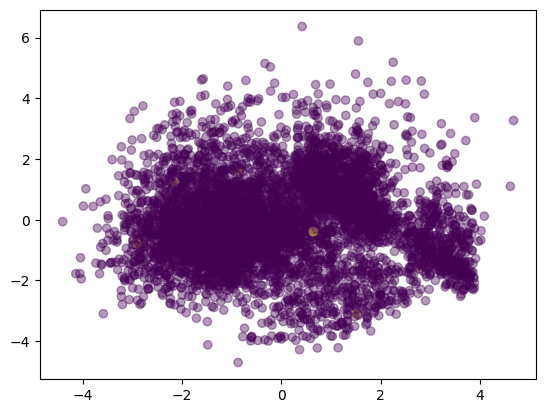


t-SNE 3D: 


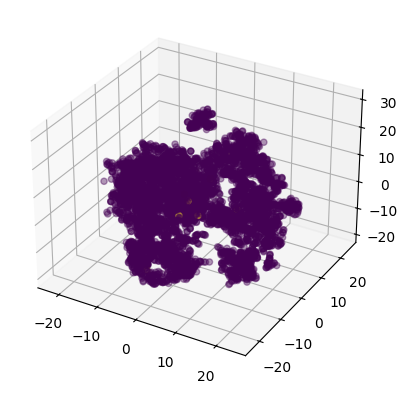


t-SNE 2D: 


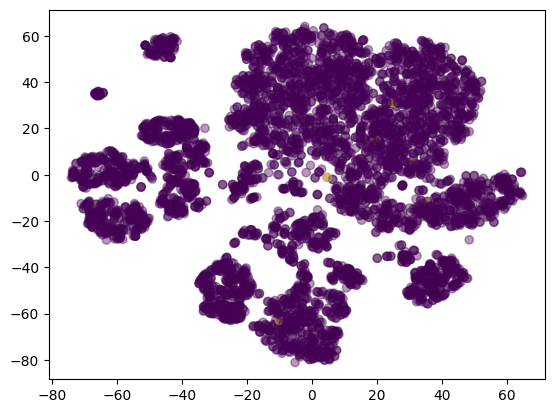

In [338]:
y_pred = np.where(y_pred>.5, 1, 0)
do_visualize(y_pred, True)

## Display Results

In [273]:
all_results = pd.DataFrame(data=list(metrics_of_methodes.values()), index=list(metrics_of_methodes.keys()), columns=['precision', 'recall', 'f1_score', 'accuracy', 'AUC', 'AUPRC'])
all_results

,precision,recall,f1_score,accuracy,AUC,AUPRC
IQR,0.522005,0.612864,0.263088,0.300471,NaN,NaN
Z-score,0.583936,0.695601,0.609206,0.899872,NaN,NaN
Mahalaobis-distance,0.567572,0.529077,0.538058,0.949606,NaN,NaN
Base_Classifire,0.719110,0.657383,0.682499,0.958598,0.838495,0.296355
ReWeighting,0.657583,0.690990,0.672374,0.945032,0.841382,0.303100
OC-SVM,0.526866,0.677073,0.393608,0.515328,NaN,NaN
OC-Reconstruction_error,0.574983,0.578742,0.576801,0.934106,0.760929,0.132561
Balanced_Bagging_Classifier,0.584473,0.770379,0.608902,0.871388,NaN,NaN
Forest_Randomized_Trees,0.700127,0.685515,0.692502,0.955074,0.886506,0.349795
RUS-Boosting,0.578782,0.796159,0.595414,0.846899,0.869646,0.310346


In [276]:
all_results.to_csv("./results.csv")

# Time Series

## Entire Data

In [322]:
entire_data = []
for spdt in ["02","03", "04", "05", "06", "07", "08", "09", "10"]:
    data = arff.loadarff('./dataset/base_desenv_' + spdt + '.arff')
    sub_df = pd.DataFrame(data[0])
    entire_data.append(sub_df)

entire_test = []
for spdt in ["02","03", "04", "05", "06", "07", "08", "09", "10"]:
    data = arff.loadarff('./dataset/base_validacao_' + spdt + '.arff')
    sub_df = pd.DataFrame(data[0])
    entire_test.append(sub_df)

In [323]:
df = pd.concat(entire_data)
df_test = pd.concat(entire_test)

In [324]:
y_train = df['flag_fraude_cat'].map({b'N': 0, b'S': 1})
df.drop('flag_fraude_cat', axis=1, inplace=True)
y_train = np.array(y_train)

In [325]:
y_test = df_test['flag_fraude_cat'].map({b'N': 0, b'S': 1})
df_test.drop('flag_fraude_cat', axis=1, inplace=True)
y_test = np.array(y_test)

In [326]:
from sklearn.preprocessing import StandardScaler

learn_scaler=StandardScaler().fit(df)
X_train = learn_scaler.transform(df)
X_test = learn_scaler.transform(df_test)

In [327]:
def WindowGenerator(data_in, time_step, label):
    
    X_comb = []
    Y_comb = []
    target_ = int(time_step/2) + 1

    for mth in range(0, len(data_in)-(time_step)): # Define range 
        
        X_start=mth # Start day for inputs of each sample
        X_end=mth + time_step # End day for inputs of each sample

        X_comb.append(data_in[X_start:X_end, :])
        Y_comb.append(label[X_start + target_])

    return(np.array(X_comb), np.array(Y_comb))

In [328]:
X_train_time_seri, y_train_time_seri = WindowGenerator(X_train, 5, y_train)
X_test_time_seri, y_test_time_seri = WindowGenerator(X_test, 5, y_test)

In [329]:
X_train_time_seri.shape

(262101, 5, 17)

In [330]:
import tensorflow as tf

In [331]:
def lstm_model ():
    # Input
    window = tf.keras.layers.Input(shape = (5, 17))

    layer_1 = tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(50, return_sequences=True))(window)
    layer_2 = tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(50))(layer_1)
    layer_3 = tf.keras.layers.Dense(300, activation="relu")(layer_2)
    layer_4 = tf.keras.layers.Dense(300, activation="relu")(layer_3)
    layer_5 = tf.keras.layers.Dense(300, activation="relu")(layer_4)
    layer_6 = tf.keras.layers.Dense(300, activation="relu")(layer_5)
    pred = tf.keras.layers.Dense(1, activation="sigmoid")(layer_6)

    # Model
    model = tf.keras.Model(inputs=[window], outputs=[pred])

    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.01), 
                  loss = tf.keras.losses.binary_crossentropy, 
                  metrics=['accuracy'])

    return(model)

In [334]:
model_time_seri = lstm_model()
model_time_seri.summary()

Model: "model_45"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_47 (InputLayer)       [(None, 5, 17)]           0         
                                                                 
 bidirectional_10 (Bidirect  (None, 5, 100)            27200     
 ional)                                                          
                                                                 
 bidirectional_11 (Bidirect  (None, 100)               60400     
 ional)                                                          
                                                                 
 dense_189 (Dense)           (None, 300)               30300     
                                                                 
 dense_190 (Dense)           (None, 300)               90300     
                                                                 
 dense_191 (Dense)           (None, 300)               903

In [335]:
history = model_time_seri.fit(
    X_train_time_seri, y_train_time_seri,
    batch_size=64,
    epochs=10,
    verbose="auto",
    callbacks=None,
    validation_split=0.1,
    validation_data=None,
    shuffle=True,
    class_weight=None,
    sample_weight=None,
    initial_epoch=0,
    steps_per_epoch=None,
    validation_steps=None,
    validation_batch_size=None,
    validation_freq=1,
    max_queue_size=10,
    workers=1,
    use_multiprocessing=False,
    )

Epoch 1/10
3686/3686 [==============================] - 62s 15ms/step - loss: 0.0976 - accuracy: 0.9652 - val_loss: 0.0757 - val_accuracy: 0.9717
Epoch 2/10
3686/3686 [==============================] - 49s 13ms/step - loss: 0.0725 - accuracy: 0.9740 - val_loss: 0.0714 - val_accuracy: 0.9758
Epoch 3/10
3686/3686 [==============================] - 51s 14ms/step - loss: 0.0585 - accuracy: 0.9792 - val_loss: 0.0598 - val_accuracy: 0.9791
Epoch 4/10
3686/3686 [==============================] - 49s 13ms/step - loss: 0.0532 - accuracy: 0.9813 - val_loss: 0.0574 - val_accuracy: 0.9816
Epoch 5/10
3686/3686 [==============================] - 48s 13ms/step - loss: 0.0489 - accuracy: 0.9829 - val_loss: 0.0538 - val_accuracy: 0.9805
Epoch 6/10
3686/3686 [==============================] - 49s 13ms/step - loss: 0.0454 - accuracy: 0.9842 - val_loss: 0.0482 - val_accuracy: 0.9820
Epoch 7/10
3686/3686 [==============================] - 51s 14ms/step - loss: 0.0493 - accuracy: 0.9839 - val_loss: 0.0660 -

In [336]:
y_pred = model_time_seri.predict(X_test_time_seri)

3523/3523 [==============================] - 23s 6ms/step


precision_score: 0.7804680439300038
recall_score: 0.7574801875791801
f1_score: 0.7684271197447217


accuracy_score: 0.9682021435162184

              precision    recall  f1-score   support

           0       0.98      0.99      0.98    108522
           1       0.58      0.53      0.55      4190

    accuracy                           0.97    112712
   macro avg       0.78      0.76      0.77    112712
weighted avg       0.97      0.97      0.97    112712




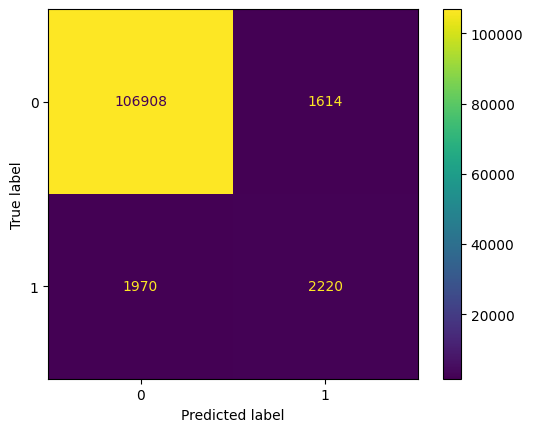

AUC score is  0.9364245292981739


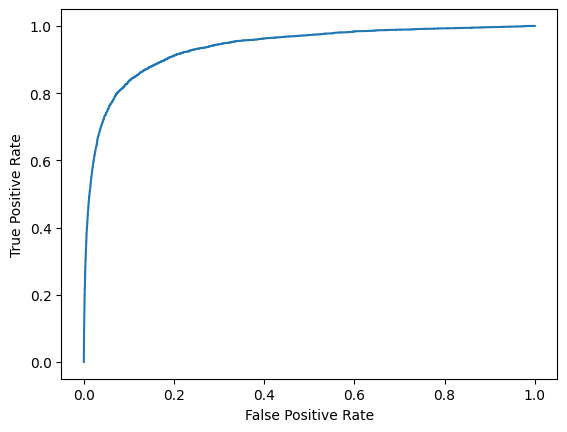

AUPRC score is  0.5593448311939062


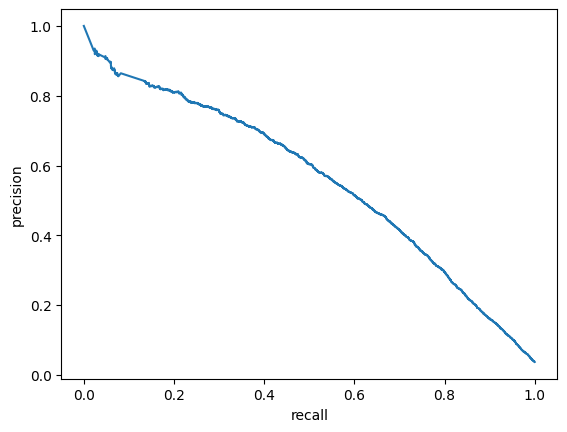

[0.7804680439300038,
 0.7574801875791801,
 0.7684271197447217,
 0.9682021435162184,
 0.9364245292981739,
 0.5593448311939062]

In [337]:
calculate_metrics(y_test_time_seri, y_pred, is_prob=True, threshold=0.4)

## Drop Duplicates

In [338]:
entire_data = []
for spdt in ["02","03", "04", "05", "06", "07", "08", "09", "10"]:
    data = arff.loadarff('./dataset/base_desenv_' + spdt + '.arff')
    sub_df = pd.DataFrame(data[0])
    entire_data.append(sub_df)

    data = arff.loadarff('./dataset/base_validacao_' + spdt + '.arff')
    sub_df = pd.DataFrame(data[0])
    entire_data.append(sub_df)

In [339]:
df = pd.concat(entire_data)

In [341]:
df.drop_duplicates(inplace=True, ignore_index=True)
df

,mcc_cat,mcc_ant_cat,cep_cat,cep_ant_cat,valor_trans_cat,valor_trans_ant_cat,pos_entry,lim_cred_cat,bandeira_cat,variante_cat,score_cat,tp_pessoa_cat,trans_nacional_cat,qtde_parc_cat,velocidade_cat,dif_score_cat,trans_limit_cat,flag_fraude_cat
0,9.0,22.0,3.0,3.0,6.0,6.0,2.0,6.0,2.0,3.0,0.0,1.0,0.0,1.0,7.0,1.0,0.0,b'N'
1,22.0,22.0,3.0,3.0,7.0,7.0,2.0,6.0,2.0,3.0,0.0,1.0,0.0,1.0,4.0,4.0,0.0,b'N'
2,22.0,22.0,3.0,3.0,7.0,7.0,2.0,6.0,2.0,3.0,3.0,1.0,0.0,1.0,6.0,5.0,0.0,b'S'
3,9.0,0.0,2.0,0.0,4.0,1.0,2.0,4.0,2.0,3.0,0.0,1.0,0.0,1.0,2.0,3.0,0.0,b'N'
4,15.0,9.0,2.0,2.0,4.0,4.0,2.0,4.0,2.0,3.0,0.0,1.0,0.0,1.0,3.0,3.0,0.0,b'N'
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28372,3.0,15.0,2.0,2.0,4.0,4.0,2.0,3.0,1.0,1.0,0.0,1.0,0.0,1.0,5.0,1.0,0.0,b'N'
28373,0.0,3.0,2.0,2.0,5.0,4.0,2.0,3.0,1.0,1.0,0.0,1.0,0.0,1.0,3.0,3.0,0.0,b'N'
28374,9.0,0.0,2.0,2.0,4.0,5.0,5.0,3.0,1.0,1.0,0.0,1.0,0.0,1.0,5.0,1.0,0.0,b'N'
28375,15.0,9.0,2.0,2.0,4.0,4.0,2.0,3.0,1.0,1.0,0.0,1.0,0.0,1.0,2.0,3.0,0.0,b'N'


In [342]:
label = df['flag_fraude_cat'].map({b'N': 0, b'S': 1})
df.drop('flag_fraude_cat', axis=1, inplace=True)
label = np.array(label)

In [343]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(df, label, test_size=0.2, random_state=0, shuffle=False)
X_train.reset_index(drop=True, inplace = True)
X_test.reset_index(drop=True, inplace = True)

In [344]:
from sklearn.preprocessing import StandardScaler

learn_scaler=StandardScaler().fit(X_train)
X_train = learn_scaler.transform(X_train)
X_test = learn_scaler.transform(X_test)

In [345]:
X_train_time_seri, y_train_time_seri = WindowGenerator(X_train, 5, y_train)
X_test_time_seri, y_test_time_seri = WindowGenerator(X_test, 5, y_test)

In [346]:
X_train_time_seri.shape

(22696, 5, 17)

In [347]:
model_time_seri = lstm_model()
model_time_seri.summary()

Model: "model_46"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_48 (InputLayer)       [(None, 5, 17)]           0         
                                                                 
 bidirectional_12 (Bidirect  (None, 5, 100)            27200     
 ional)                                                          
                                                                 
 bidirectional_13 (Bidirect  (None, 100)               60400     
 ional)                                                          
                                                                 
 dense_194 (Dense)           (None, 300)               30300     
                                                                 
 dense_195 (Dense)           (None, 300)               90300     
                                                                 
 dense_196 (Dense)           (None, 300)               903

In [348]:
history = model_time_seri.fit(
    X_train_time_seri, y_train_time_seri,
    batch_size=64,
    epochs=5,
    verbose="auto",
    callbacks=None,
    validation_split=0.1,
    validation_data=None,
    shuffle=True,
    class_weight=None,
    sample_weight=None,
    initial_epoch=0,
    steps_per_epoch=None,
    validation_steps=None,
    validation_batch_size=None,
    validation_freq=1,
    max_queue_size=10,
    workers=1,
    use_multiprocessing=False,
    )

Epoch 1/5


320/320 [==============================] - 15s 22ms/step - loss: 0.1423 - accuracy: 0.9593 - val_loss: 0.1713 - val_accuracy: 0.9551
Epoch 2/5
320/320 [==============================] - 5s 15ms/step - loss: 0.1169 - accuracy: 0.9606 - val_loss: 0.1505 - val_accuracy: 0.9546
Epoch 3/5
320/320 [==============================] - 5s 16ms/step - loss: 0.1072 - accuracy: 0.9607 - val_loss: 0.1543 - val_accuracy: 0.9551
Epoch 4/5
320/320 [==============================] - 6s 18ms/step - loss: 0.1020 - accuracy: 0.9609 - val_loss: 0.1511 - val_accuracy: 0.9551
Epoch 5/5
320/320 [==============================] - 5s 15ms/step - loss: 0.0921 - accuracy: 0.9626 - val_loss: 0.2026 - val_accuracy: 0.9546


In [349]:
y_pred = model_time_seri.predict(X_test_time_seri)

178/178 [==============================] - 3s 5ms/step


precision_score: 0.6610519576790889
recall_score: 0.6984183652289426
f1_score: 0.6774256749924158
accuracy_score: 0.9460412625639217

              precision    recall  f1-score   support

           0       0.98      0.97      0.97      5450
           1       0.35      0.43      0.38       221

    accuracy                           0.95      5671
   macro avg       0.66      0.70      0.68      5671
weighted avg       0.95      0.95      0.95      5671




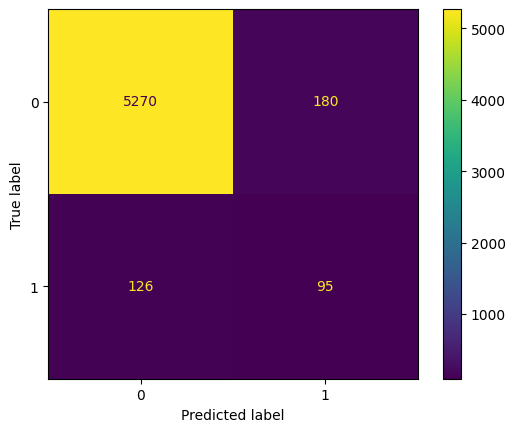

AUC score is  0.8750043588359833


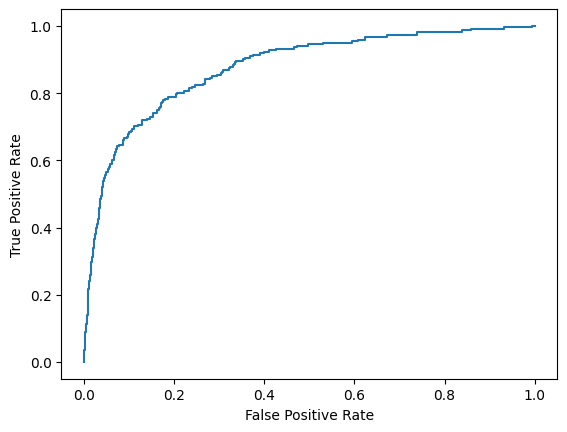

AUPRC score is  0.3008780870975469


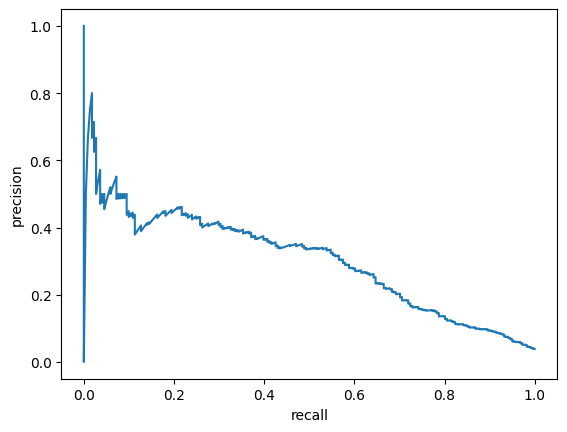

[0.6610519576790889,
 0.6984183652289426,
 0.6774256749924158,
 0.9460412625639217,
 0.8750043588359833,
 0.3008780870975469]

In [351]:
calculate_metrics(y_test_time_seri, y_pred, is_prob=True, threshold=0.1)